In [1]:
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score
from sklearn import preprocessing
from sklearn.model_selection import cross_val_score
from sklearn import metrics
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import time
%config Completer.use_jedi = False
from sklearn.metrics import classification_report
from kneed import DataGenerator, KneeLocator


Bad key “backend in file /Users/bhkash/.matplotlib/matplotlibrc, line 1 ('“backend: TkAgg”')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.3.4/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
random_seed = 2

In [3]:
data_b = pd.read_csv("BreastCancer.csv", index_col="id")
data_b["label"] = 0
#label
data_b.label[data_b.diagnosis == 'B'] = 0
data_b.label[data_b.diagnosis == 'M'] = 1
data_b = data_b.drop(columns=['Unnamed: 32', 'diagnosis'])
data_b.head()
#Split
X_b_pre_scale = data_b.iloc[:,:-1]
y_b = data_b['label']

X_train, X_test, y_train, y_test = train_test_split(X_b_pre_scale, y_b, test_size=0.2, stratify = y_b, random_state = 1)
print(len(X_train),' samples in training data\n',
      len(X_test),' samples in test data\n', )
#Scale
scaler = preprocessing.StandardScaler().fit(X_train)
X_b = scaler.transform(X_train)
X_b_test = scaler.transform(X_test)
y_b = y_train
y_b_test = y_test

print(len(X_b), len(y_b),' samples in scaled training data\n',
      len(X_b_test), len(y_b_test),' samples in scaled test data\n', )


455  samples in training data
 114  samples in test data

455 455  samples in scaled training data
 114 114  samples in scaled test data



<ipython-input-3-0d079cefd7c1>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_b.label[data_b.diagnosis == 'B'] = 0
<ipython-input-3-0d079cefd7c1>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_b.label[data_b.diagnosis == 'M'] = 1


In [4]:
data_red = pd.read_csv("winequality-red.csv", delimiter = ";")
data_red["isRed"] = 1
data_red["isWhite"] = 0
data_white = pd.read_csv("winequality-white.csv", delimiter = ";")
data_white["isRed"] = 0
data_white["isWhite"] = 1
data_w = pd.concat([data_red, data_white], axis = 0)

#data = data_red
data_w.groupby('quality').size()

quality
3      30
4     216
5    2138
6    2836
7    1079
8     193
9       5
dtype: int64

In [5]:
data_w["label"] = data_w["quality"]
data_w = data_w[data_w.quality != 6]
data_w.label[data_w.quality == 3] = 0
data_w.label[data_w.quality == 4] = 0
data_w.label[data_w.quality == 5] = 0
data_w.label[data_w.quality == 7] = 1
data_w.label[data_w.quality == 8] = 1
data_w.label[data_w.quality == 9] = 1
print(data_w.groupby('quality').size())
data_w = data_w.drop(columns =["quality"])

quality
3      30
4     216
5    2138
7    1079
8     193
9       5
dtype: int64


<ipython-input-5-6f319709c1e8>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_w.label[data_w.quality == 4] = 0
<ipython-input-5-6f319709c1e8>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_w.label[data_w.quality == 5] = 0
<ipython-input-5-6f319709c1e8>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_w.label[data_w.quality == 7] = 1
<ipython-input-5-6f319709c1e8>:7: SettingWithCopyWarning: 
A value is trying to be se

In [6]:
X_w_pre_scale = data_w.iloc[:,:-1]
y_w = data_w['label']

X_train, X_test, y_train, y_test = \
    train_test_split(X_w_pre_scale, y_w,
                     test_size=0.2, stratify = y_w, random_state = 1)
print(len(X_train),' samples in training data\n',
      len(X_test),' samples in test data\n', )
scaler = preprocessing.StandardScaler().fit(X_train)
X_w = scaler.transform(X_train)
X_w_test = scaler.transform(X_test)
y_w = y_train
y_w_test = y_test
print(len(X_w), len(y_w),' samples in scaled training data\n',
      len(X_w_test), len(y_w_test),' samples in scaled test data\n', )


2928  samples in training data
 733  samples in test data

2928 2928  samples in scaled training data
 733 733  samples in scaled test data



In [7]:
pd.DataFrame(X_w).describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12
count,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03,2.928000e+03
mean,-2.020242e-16,-4.853434e-18,1.516698e-17,-1.583433e-16,-4.004083e-17,6.309464e-17,-1.547032e-17,-4.128088e-14,-7.898964e-16,-2.730057e-16,9.561265e-16,4.246755e-17,3.033396e-17
std,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00,1.000171e+00
min,-2.330652e+00,-1.604024e+00,-2.134108e+00,-1.027299e+00,-1.285636e+00,-1.569632e+00,-1.946357e+00,-2.583052e+00,-2.696139e+00,-1.881310e+00,-1.962175e+00,-5.968110e-01,-1.675572e+00
25%,-6.431297e-01,-6.864539e-01,-5.053838e-01,-7.678332e-01,-5.127416e-01,-7.870021e-01,-6.875621e-01,-8.093181e-01,-6.927968e-01,-6.729282e-01,-8.314808e-01,-5.968110e-01,-1.675572e+00
50%,-1.828962e-01,-2.850170e-01,-3.033925e-02,-5.083676e-01,-2.462263e-01,-1.161764e-01,6.418780e-02,1.058038e-01,-6.675241e-02,-2.030019e-01,-2.661337e-01,-5.968110e-01,5.968110e-01
75%,3.540429e-01,4.031604e-01,5.125688e-01,5.511171e-01,2.868043e-01,6.105515e-01,6.990968e-01,7.805481e-01,6.218964e-01,4.683213e-01,7.030328e-01,1.675572e+00,5.968110e-01
max,6.643901e+00,6.998195e+00,4.652242e+00,3.599838e+00,1.475859e+01,6.061011e+00,4.014733e+00,2.838518e+00,4.252954e+00,9.732582e+00,3.610532e+00,1.675572e+00,5.968110e-01


In [8]:
len(X_b)

455

# KMeans

In [688]:
def cluster_label_accuracy(cluster, y):
    df = pd.DataFrame(index = range(len(y)))
    df["cluster"] = cluster
    df["label"] = y.values
    max_clusters = df.cluster.max()
    cluster_class = [0] * (max_clusters+1)
    for i in range(max_clusters+1):
        df_temp = df[df.cluster == i]
        value_counts = df_temp.value_counts()
        if (value_counts[i][0] > value_counts[i][1]):
            cluster_class[i] = 0
        else:
            cluster_class[i] = 1
        #print(value_counts)
        
    #print(cluster_class)
    
    df["cluster_class"] = 0
    array = []

    for i in range(len(cluster_class)):
        df["cluster_class"][df.cluster == i] = cluster_class[i]
        
    print("Accuracy of clustering: " + str(accuracy_score(df["label"], df["cluster_class"])))
        
    return df
    
    

In [689]:
cluster_label_accuracy(cluster, y_b).cluster_class.value_counts()

Accuracy of clustering: 0.9032967032967033


<ipython-input-688-ed9e87619380>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cluster_class"][df.cluster == i] = cluster_class[i]
<ipython-input-688-ed9e87619380>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cluster_class"][df.cluster == i] = cluster_class[i]


0    303
1    152
Name: cluster_class, dtype: int64

In [692]:
cluster_label_accuracy(cluster, y_w).cluster_class.value_counts()

Accuracy of clustering: 0.6827185792349727


<ipython-input-688-ed9e87619380>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cluster_class"][df.cluster == i] = cluster_class[i]
<ipython-input-688-ed9e87619380>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cluster_class"][df.cluster == i] = cluster_class[i]
<ipython-input-688-ed9e87619380>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cluster_class"][df.cluster == i] = cluster_class[i]


0    1586
1    1342
Name: cluster_class, dtype: int64

In [36]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

In [8]:
def elbow(X ,K = 15,title = 'Elbow Method For Optimal k', random_seeder = 1, show = True):
    distortions = []
    inertias = []
    K_range = range(1,K)
    for k in K_range:
        km = KMeans(n_clusters=k, random_state = random_seeder)
        km = km.fit(X)
        inertias.append(km.inertia_)

    if show:
        ax = plt.plot(K_range, inertias, 'bx-')
        plt.xlabel('k')
        plt.ylabel('Sum_of_squared_distances')

        diff_inertia = [inertias[i]/inertias[0] for i in range(len(inertias))]
        diff_inertia = np.diff(diff_inertia)
        optimal = np.argwhere(diff_inertia < np.quantile(diff_inertia, 0.9))[-1][0]
    #     print(inertias)
    #     print(diff_inertia)
    #     print(np.quantile(diff_inertia, 0.9))
    #     print(optimal)
        plt.title(title)
        plt.grid(True)
        print("Using Kneed")
        kneedle = KneeLocator(K_range, inertias, S=1.0, curve='convex', direction='decreasing')
        print(kneedle.knee)
        #plt.legend((line1, line2, line3), ('label1', 'label2', 'label3'))
        plt.axvline(x =kneedle.knee - 0.5 ,linewidth=2, color='black', label = "Elbow")
        plt.legend()
        if kneedle.knee != None:
            kneedle.plot_knee()

        plt.grid(True)
        plt.show()
    

    return inertias
     

In [9]:
def multiple_elbow(X_dict, K = 15, title = "Compare SSE"):
    df = pd.DataFrame(index = range(1,K))
    for name, X in X_dict.items():
        df[name] = elbow(X, K, show = False)
    
    df.plot(style = 'x-')
    plt.xlabel('k')
    plt.ylabel('Sum_of_squared_distances')
    plt.title(title)
    plt.grid()
    plt.show()
        

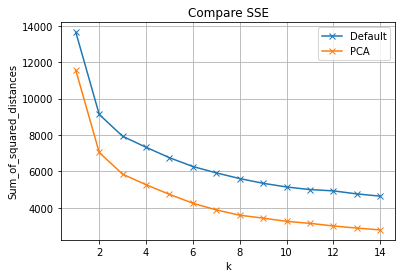

In [535]:
X_dict = {
    "Default" : X_b,
    "PCA" : X_b_pca
}
multiple_elbow(X_dict)

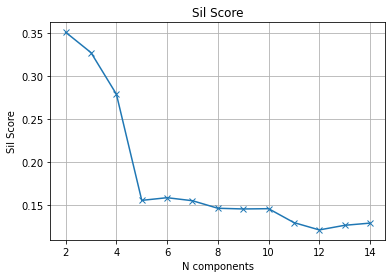

In [19]:
sil_score_plot(X_b,14)

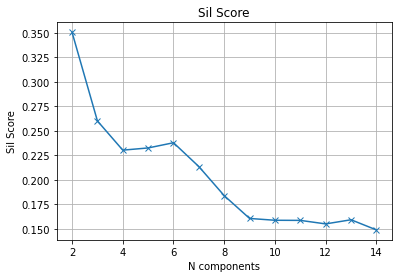

In [20]:
sil_score_plot(X_w,14)

Using Kneed
3


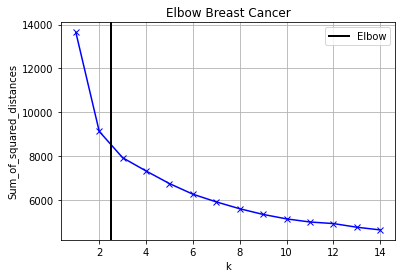

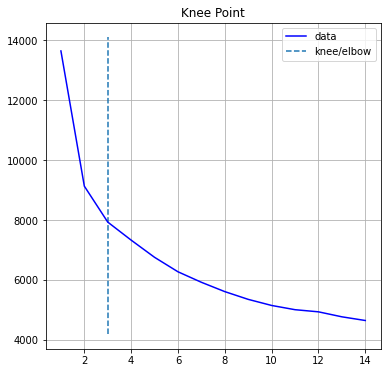

Using Kneed
5


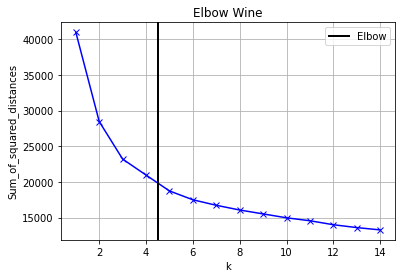

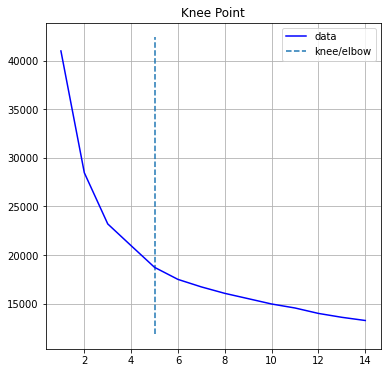

[40992.00000000005,
 28457.094303406222,
 23196.405896799715,
 20953.24087310421,
 18727.101608493016,
 17486.960899513335,
 16714.844565278116,
 16051.936676783678,
 15506.278897913691,
 14957.00737086799,
 14545.9424032409,
 13987.601378464946,
 13587.338241531292,
 13260.110281196155]

In [61]:
#https://blog.cambridgespark.com/how-to-determine-the-optimal-number-of-clusters-for-k-means-clustering-14f27070048f

elbow(X_b, title ="Elbow Breast Cancer")
elbow(X_w, title ="Elbow Wine")

In [88]:
for n_clusters in range(10):
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(X_b)
    centers = clusterer.cluster_centers_

    score = silhouette_score(X_b, preds)
    print("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:94: RuntimeWarning: divide by zero encountered in log
  n_local_trials = 2 + int(np.log(n_clusters))


OverflowError: cannot convert float infinity to integer

In [41]:
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
#
# Load IRIS dataset
#
iris = datasets.load_iris()
X = iris.data
y = iris.target
#
# Instantiate the KMeans models
#
km = KMeans(n_clusters=2, random_state=42)
#
# Fit the KMeans model
#
km.fit_predict(X_b)
#
# Calculate Silhoutte Score
#
score = silhouette_score(X_b, km.labels_, metric='euclidean')
#
# Print the score
#
print('Silhouetter Score: %.3f' % score)

Silhouetter Score: 0.351


In [10]:
def sil_score_multi_plot(X_dict, K = 15, title = "Silhouette Score DR Comparison"):
    df = pd.DataFrame(index = range(1,K))
    for name, X in X_dict.items():
        df[name] = sil_score_plot(X, K, return_result = True)
    
    df.plot(style = 'x-')
    plt.xlabel('k')
    plt.ylabel('Silhouette Score')
    plt.title(title)
    plt.grid()
    plt.show()
        

In [11]:
from sklearn.metrics import silhouette_samples, silhouette_score
def sil_score_plot(X, k = 30, random_seed = 2, metric = "euclidean", return_result = False):
    scores =[]
    for i in range(2,k+1):
        km = KMeans(n_clusters = i, random_state = random_seed)
        cluster_labels = km.fit_predict(X)
        sil=silhouette_score(X, cluster_labels, metric=metric)
        scores.append(sil)
        #print("For n_clusters =", i, "The average silhouette_score is :", sil)
        
    if return_result:
        return scores
    
    plt.plot(range(2,k+1), scores, 'x-')
    plt.xlabel('N components')
    plt.ylabel('Sil Score')
    plt.title("Sil Score")
    plt.grid(True)

In [87]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
def sil_score_kmeans(X, k_values=[2, 3, 4, 5], random_seed = 2):
    fig, ax = plt.subplots(2, 2, figsize=(15,8))
    for index,v in enumerate(k_values):
        '''
        Create KMeans instance for different number of clusters
        '''
        km = KMeans(n_clusters=v, random_state=random_seed)
        q, mod = divmod(index, 2)
        '''
        Create SilhouetteVisualizer instance with KMeans instance
        Fit the visualizer
        '''
        visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
        visualizer.fit(X)
        ax[q-1][mod].set_title("K = " + str(v) + " sil_score= " + str(visualizer.silhouette_score_))
        

    plt.show()


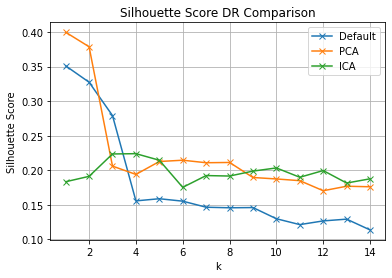

In [534]:
X_dict = {
    "Default" : X_b,
    "PCA" : X_b_pca,
    "ICA" : X_b_ICA
}
sil_score_multi_plot(X_dict)

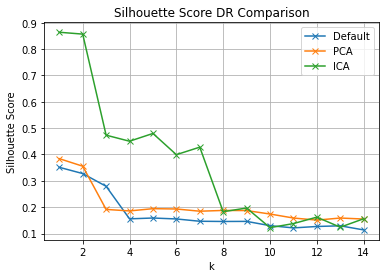

In [543]:
X_dict = {
    "Default" : X_b,
    "PCA" : X_b_pca,
    "ICA" : X_b_ICA
}
sil_score_multi_plot(X_dict)

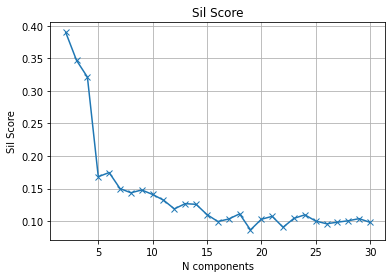

In [18]:
sil_score_plot(X_b, metric = "manhattan")

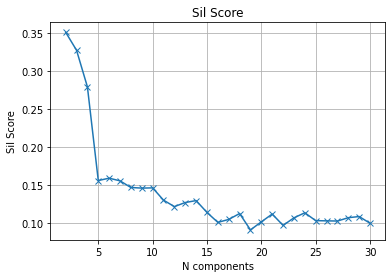

In [18]:
sil_score_plot(X_b)

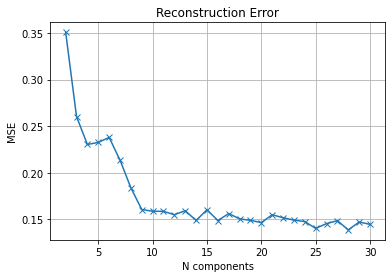

In [14]:
sil_score_plot(X_w)

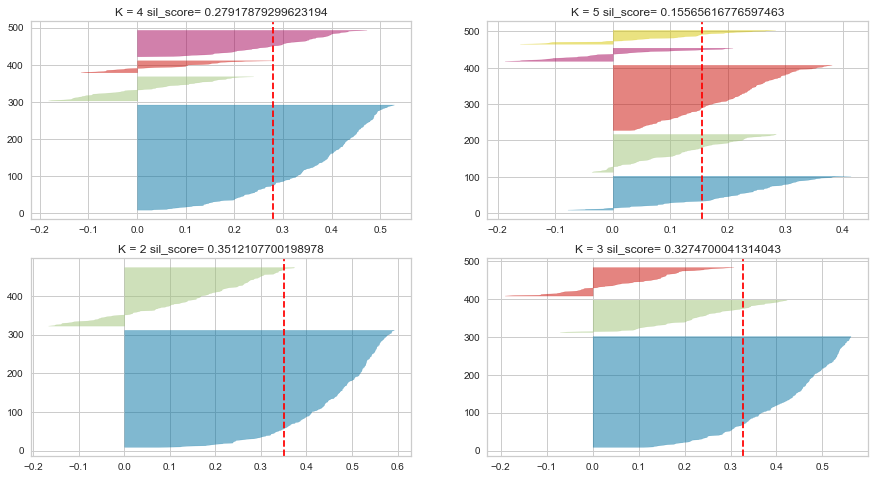

In [139]:
sil_score_kmeans(X_b)


For n_clusters = 2 The average silhouette_score is : 0.3512107700198978
For n_clusters = 3 The average silhouette_score is : 0.3274700041314043
For n_clusters = 4 The average silhouette_score is : 0.27917879299623194
For n_clusters = 5 The average silhouette_score is : 0.15565616776597463
For n_clusters = 6 The average silhouette_score is : 0.1587607508226364


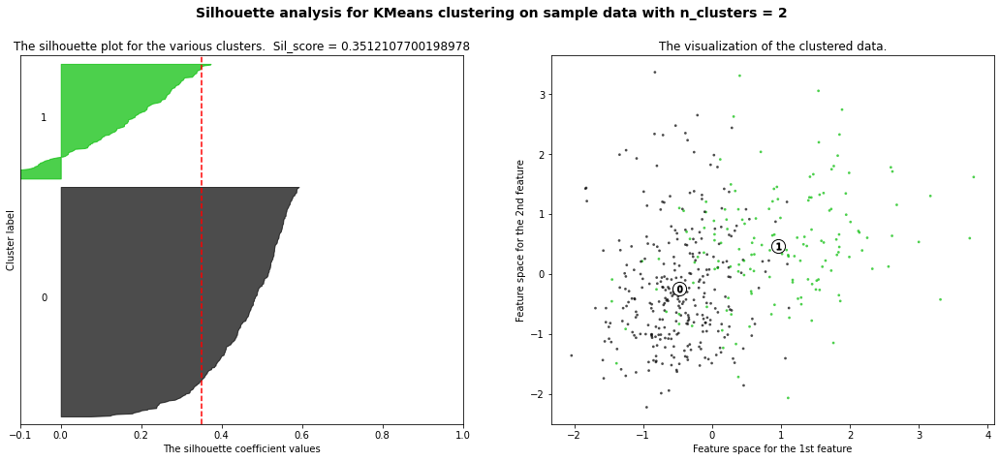

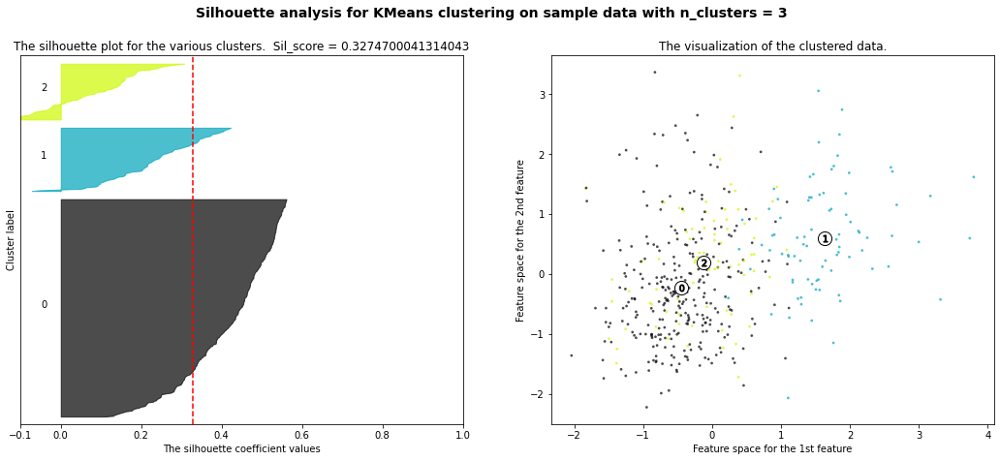

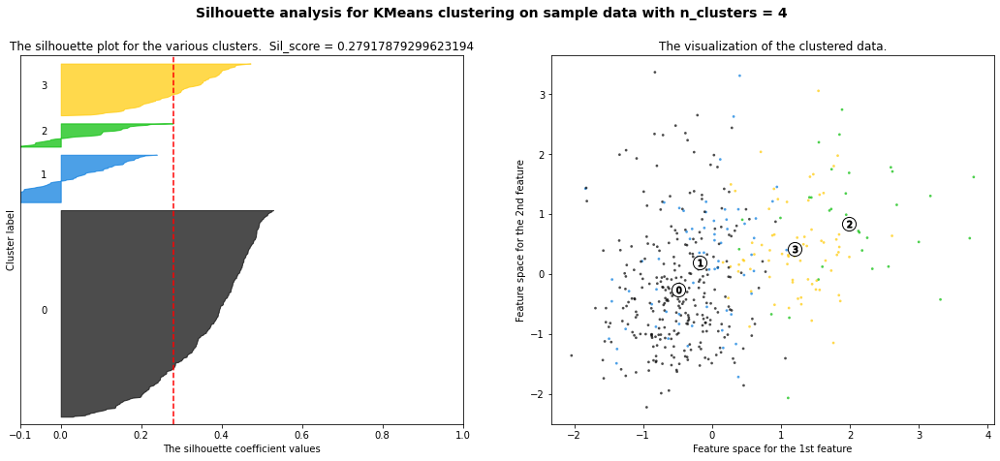

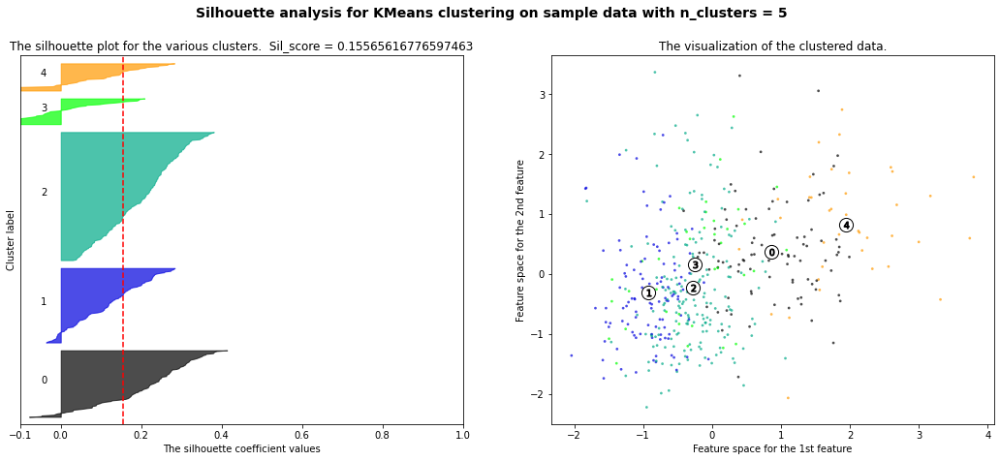

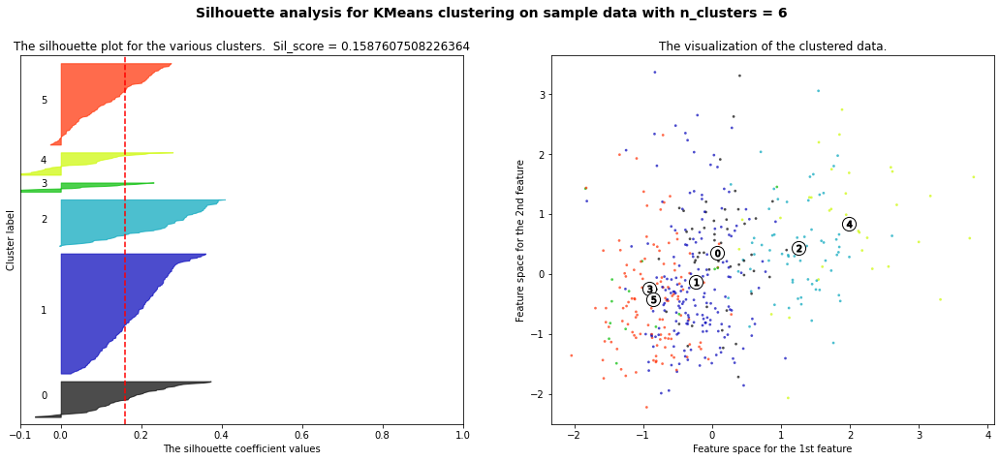

In [62]:
sil_score_kmeans_2(X_b)

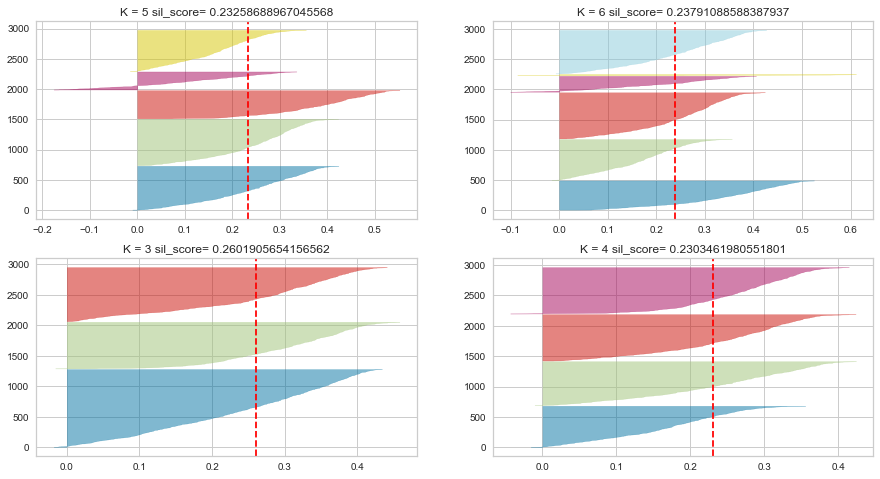

In [100]:
sil_score_kmeans_2(X_w, k_values=[3, 4,5, 6])

For n_clusters = 2 The average silhouette_score is : 0.3507233146171828
For n_clusters = 3 The average silhouette_score is : 0.2601905654156562
For n_clusters = 4 The average silhouette_score is : 0.2303461980551801
For n_clusters = 5 The average silhouette_score is : 0.23258688967045568
For n_clusters = 6 The average silhouette_score is : 0.23791088588387937


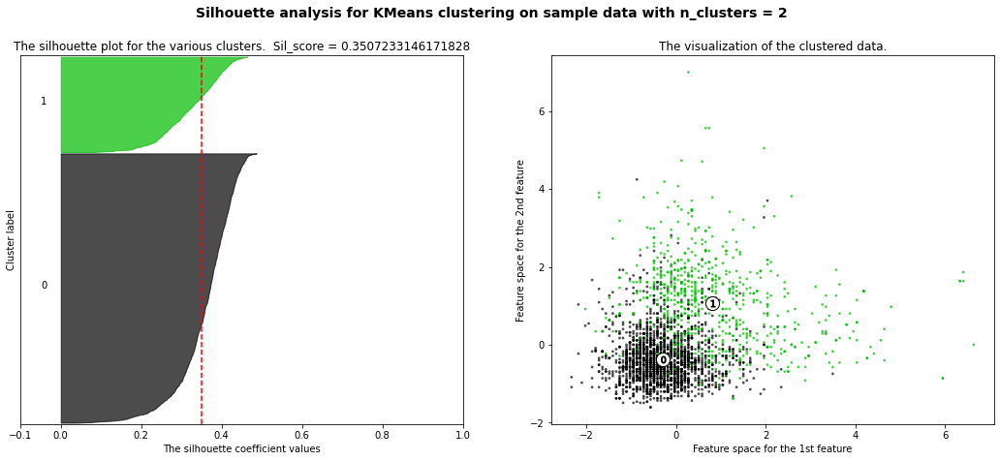

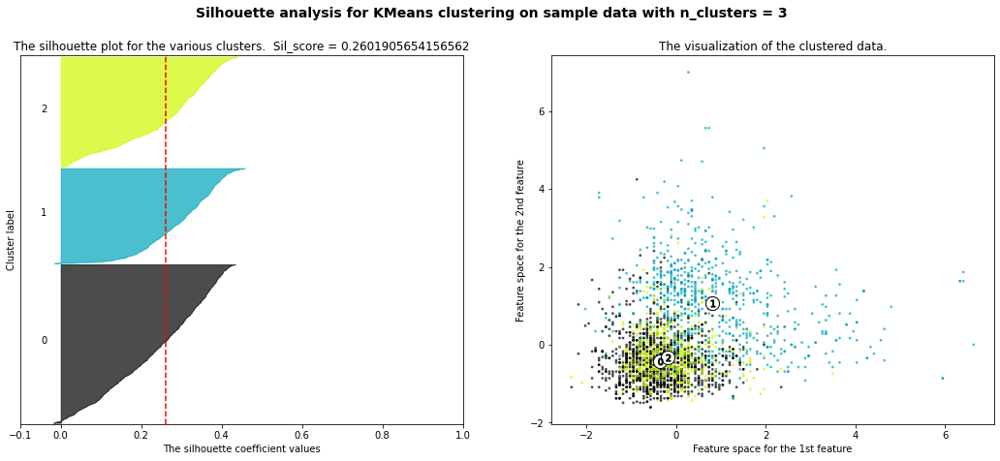

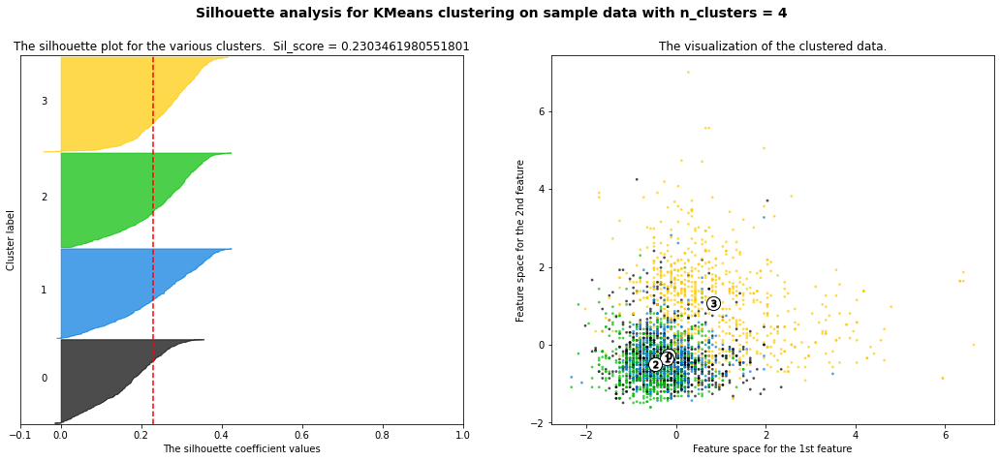

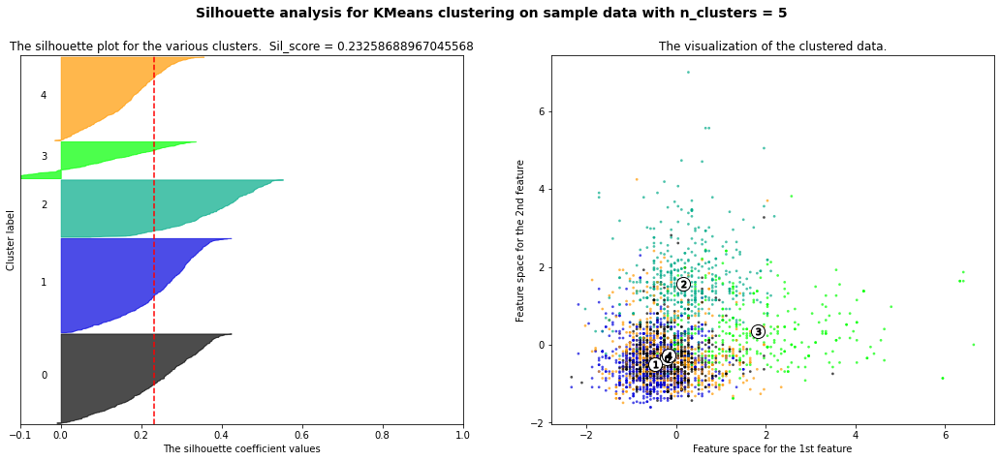

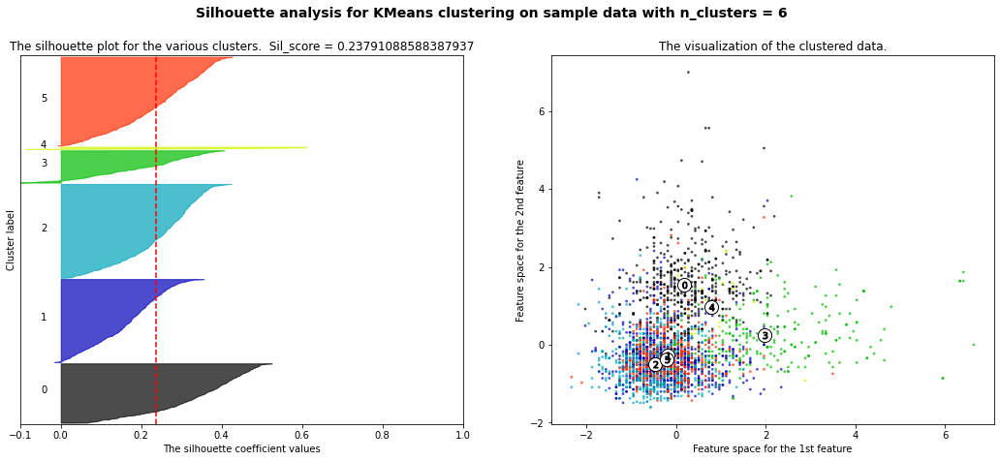

In [75]:
sil_score_kmeans_2(X_w)

## KMeans Analysis

In [51]:
def get_dist(X, y, clus):
    cluster = clus.predict(X)
    df = pd.DataFrame(X)
    df["cluster"] = cluster
    df["label"] = y.values
    sns.countplot(data = df[["cluster", "label"]], x = "cluster" , hue = "label",palette = 'colorblind')
    plt.show()
    sns.countplot(data = df[["cluster", "label"]], x = "cluster" ,palette = 'colorblind')
    plt.show()
    

Accuracy of clustering: 0.9032967032967033


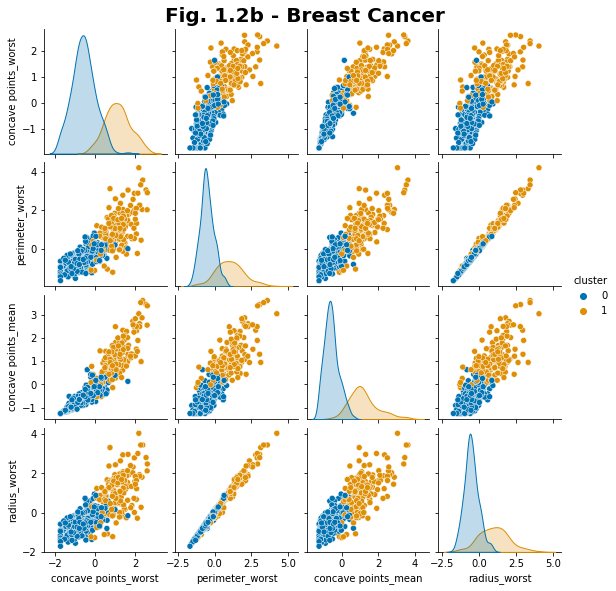

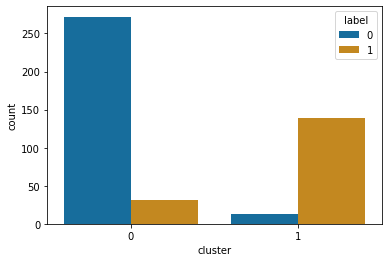

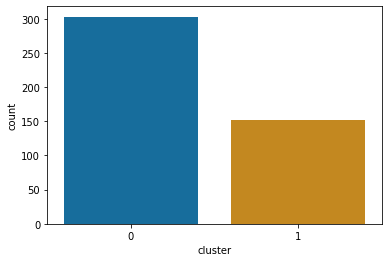

In [678]:
#Breast Cancer
n_clusters =2 
km_b = KMeans(n_clusters=n_clusters, random_state = random_seed)
km_b = km_b.fit(X_b)
cluster = km_b.predict(X_b)
df_b = pd.DataFrame(X_b, columns = data_b.iloc[:,:-1].columns)
df_b["cluster"] = cluster
df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b[["concave points_worst", "perimeter_worst", "concave points_mean", "radius_worst", "cluster"]], hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid()
plt.show()
get_dist(X_b,y_b, km_b)


Accuracy of clustering: 0.7295081967213115


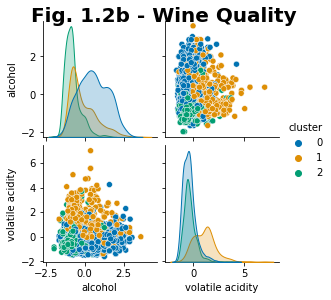

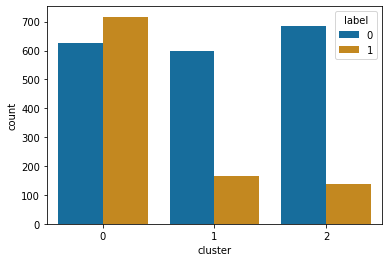

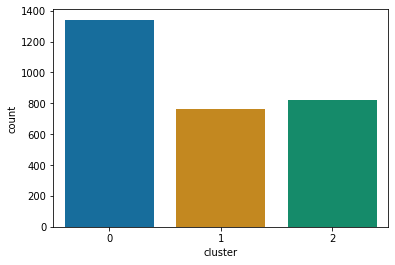

In [690]:
#Wine
n_clusters = 3
km_w = KMeans(n_clusters=n_clusters, random_state = random_seed)
km_w = km_w.fit(X_w)
cluster = km_w.predict(X_w)
df_w = pd.DataFrame(X_w, columns = data_w.iloc[:,:-1].columns)
df_w["cluster"] = cluster
df_w["label"] = y_w.values
print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))

#g =sns.pairplot(df_w[["alcohol", "volatile acidity", "total sulfur dioxide", "sulphates","cluster"]], hue="cluster", height = 2, palette = 'colorblind')
g =sns.pairplot(df_w[["alcohol", "volatile acidity", "total sulfur dioxide", "sulphates","cluster"]], hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')
plt.show()
get_dist(X_w,y_w, km_w)

# EM

In [34]:
from sklearn.mixture import GaussianMixture
def elbow_EM(X ,K = 29,title = 'Elbow Method For Optimal Components', random_seeder = 1, return_result = False):
    bic = []
    aic = []
    K_range = range(1,K)
    for k in K_range:
        gmm = GaussianMixture(n_components = k, random_state = random_seeder)
        gmm.fit(X)
        bic.append(gmm.bic(X))
        aic.append(gmm.aic(X))
        
    if return_result:
        return K_range, bic
    
    plt.plot(K_range, bic, 'bx-')
    plt.xlabel('N_Components')
    plt.ylabel('BIC')
    plt.grid(True)
    plt.show()
    
    plt.plot(K_range, aic, 'bx-')
    plt.xlabel('N_Components')
    plt.ylabel('AIC')
    plt.grid(True)
    plt.show()
    
#     diff_bic = [bic[i]/bic[0] for i in range(len(bic))]
#     diff_bic = np.diff(diff_bic)
#     optimal = np.argwhere(diff_bic < np.quantile(diff_bic, 0.9))[-1][0]
# #     print(inertias)
# #     print(diff_inertia)
# #     print(np.quantile(diff_inertia, 0.9))
# #     print(optimal)
#     plt.title(title)
#     plt.grid(True)
    
    df_gradient = pd.DataFrame(bic, index = K_range)
    df_gradient = df_gradient.diff()
    df_gradient.plot(style = 'x-')
    plt.grid(True)
    plt.show()
    

    
    
#     print("Using Kneed")
#     kneedle = KneeLocator(K_range, bic, S=1.0, curve='convex', direction='decreasing')
#     print(kneedle.knee)
#     if kneedle.knee != None:
#         kneedle.plot_knee()
#     plt.grid(True)
#     plt.show()
    
def BIC_score_multi_plot(X_dict, K = 15, title = "BIC Score DR Comparison"):
    df = pd.DataFrame(index = range(1,K))
    for name, X in X_dict.items():
        temp, df[name] = elbow_EM(X, K, return_result = True)
    
    df.plot(style = 'x-')
    plt.xlabel('k')
    plt.ylabel('BIC Score')
    plt.title(title)
    plt.grid()
    plt.show()
        
    
def sil_score_plot_EM(X, k = 30, random_seed = 2, return_result = False):
    scores =[]
    for i in range(2,k+1):
        gmm = GaussianMixture(n_components = i, random_state = random_seed)
        cluster_labels = gmm.fit_predict(X)
        sil=silhouette_score(X, cluster_labels, metric='euclidean')
        scores.append(sil)
        #print("For n_clusters =", i, "The average silhouette_score is :", sil)
    
    
    if return_result:
        return range(2,k+1), scores
    
    plt.plot(range(2,k+1), scores, 'x-')
    plt.xlabel('N components')
    plt.ylabel('Sil Score')
    plt.title("Sil Score")
    plt.grid(True)
    plt.show()
    

    return
    
def twinx_EM(X, k = 30, random_seed = 2, axline = 2):

    # Create some mock data
    t = np.arange(0.01, 10.0, 0.01)
    data1 = np.exp(t)
    data2 = np.sin(2 * np.pi * t)

    fig, ax1 = plt.subplots()

    color = 'tab:red'
    ax1.set_xlabel('N_Components')
    ax1.set_ylabel('BIC', color=color)
    x,y = elbow_EM(X, return_result =True)
    ax1.plot(x, y, 'x-', color=color)

    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel('Sil Score', color=color)  # we already handled the x-label with ax1

    x,y = sil_score_plot_EM(X, return_result =True)
    ax2.plot(x, y,'x-', color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    plt.axvline(x = axline ,linewidth=1, color='black')
    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.grid(True)
    plt.show()

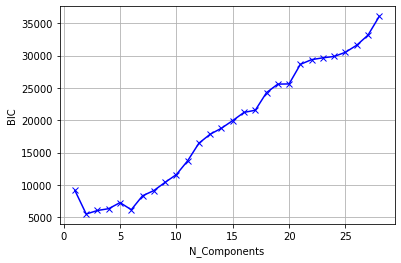

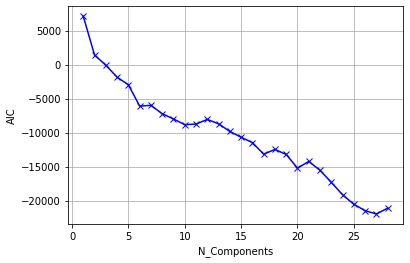

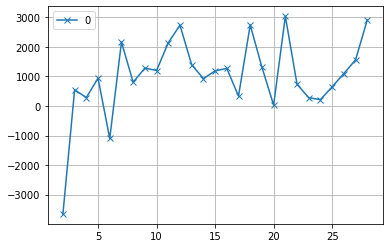

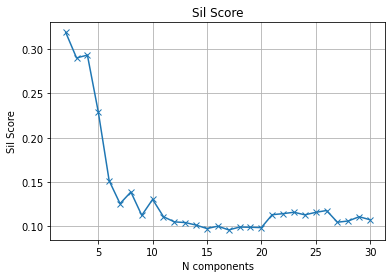

In [35]:
elbow_EM(X_b, return_result = False)
sil_score_plot_EM(X_b)


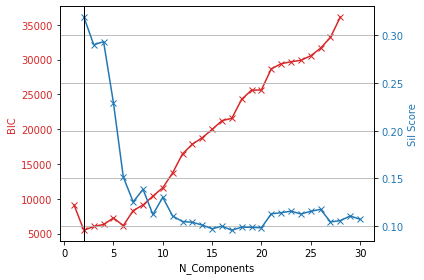

In [74]:
twinx_EM(X_b)

For n_clusters = 2 The average silhouette_score is : 0.3191962996527747
For n_clusters = 3 The average silhouette_score is : 0.2901763177053782
For n_clusters = 4 The average silhouette_score is : 0.2933393224127181
For n_clusters = 5 The average silhouette_score is : 0.22916573311446706
For n_clusters = 6 The average silhouette_score is : 0.15137462877388091


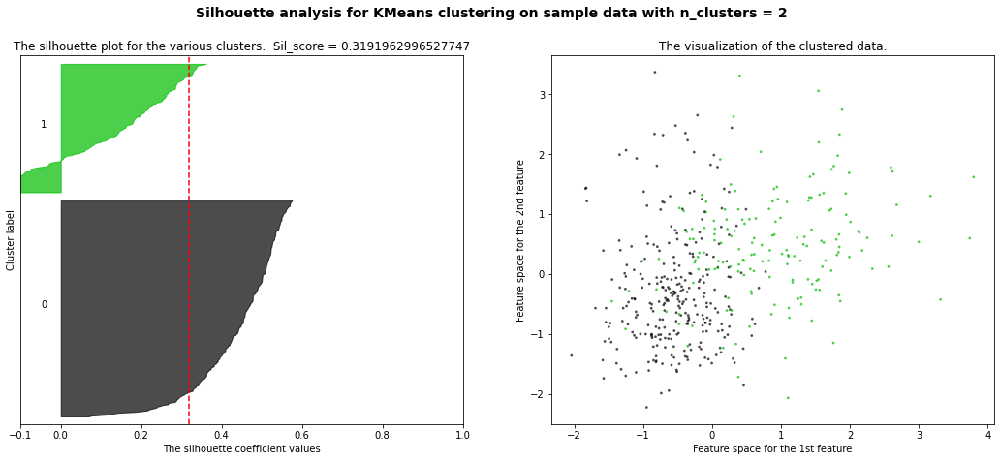

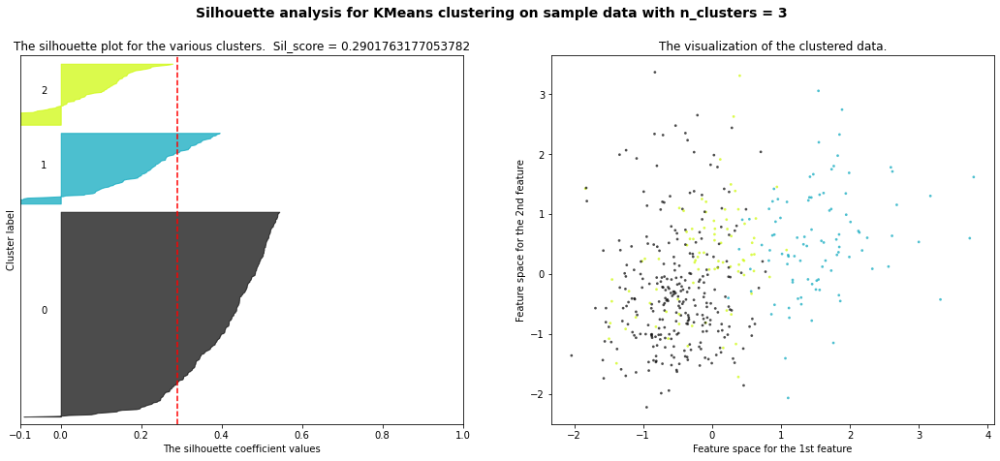

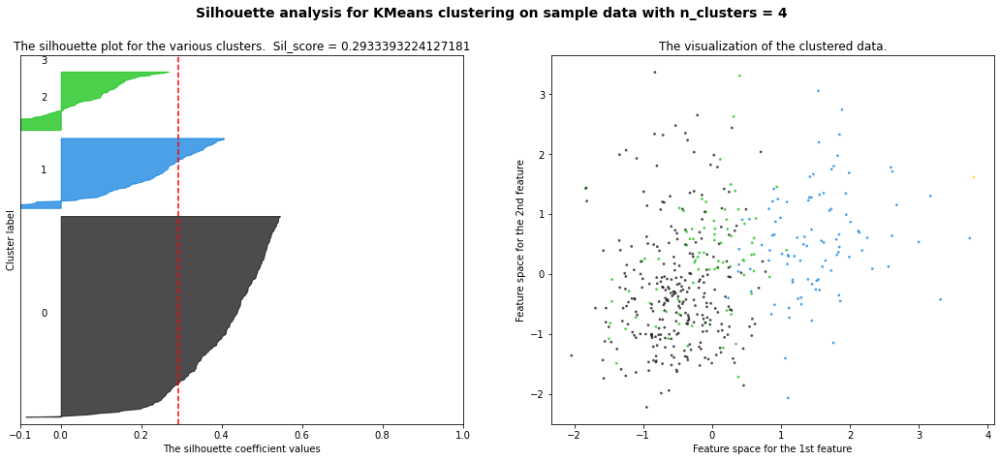

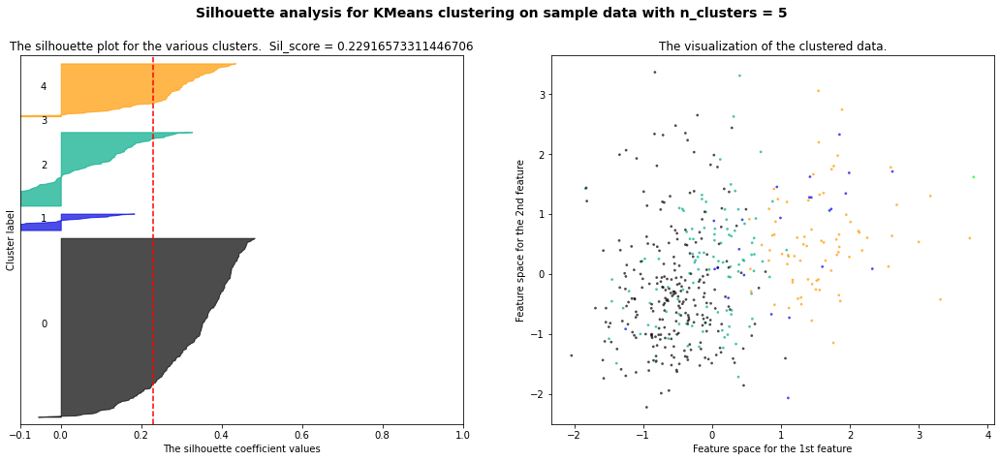

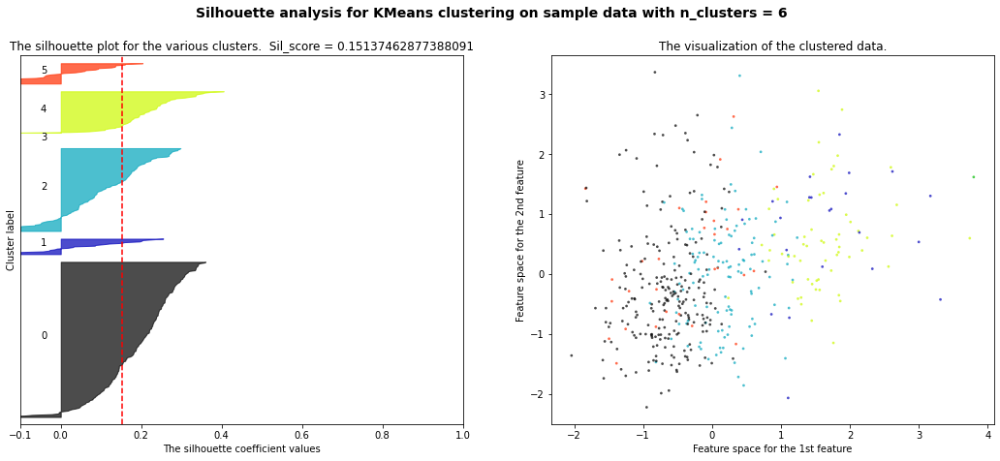

In [26]:
sil_score_EM(X_b)

Accuracy of clustering: 0.9428571428571428


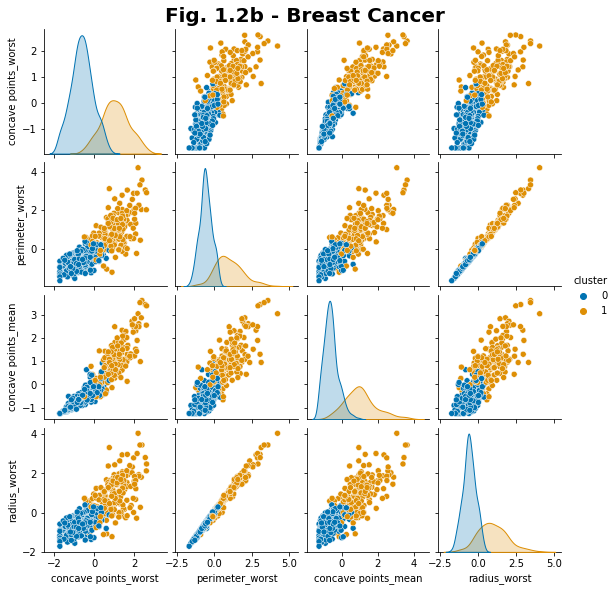

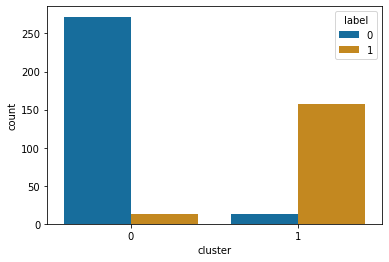

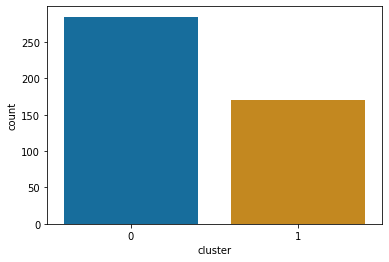

In [57]:
#Breast Cancer
n_clusters =2 
gmm_b = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_b.fit(X_b)
cluster = gmm_b.predict(X_b)
df_b = pd.DataFrame(X_b, columns = data_b.iloc[:,:-1].columns)
df_b["cluster"] = cluster
df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b[["concave points_worst", "perimeter_worst", "concave points_mean", "radius_worst", "cluster"]], hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid()
plt.show()
get_dist(X_b,y_b, gmm_b)

Note: Even Better performance than with 2 clusters in Kmeans - this means the clusters are not circular

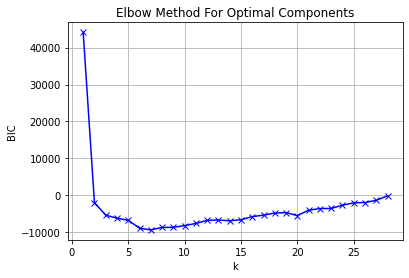

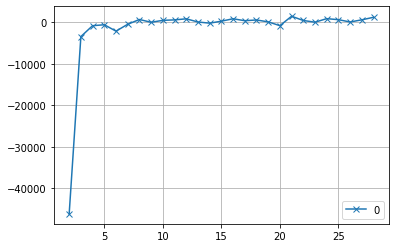

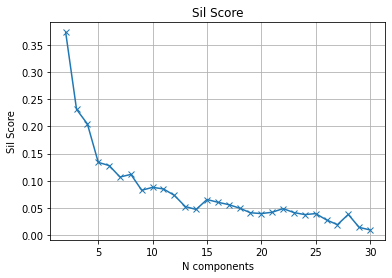

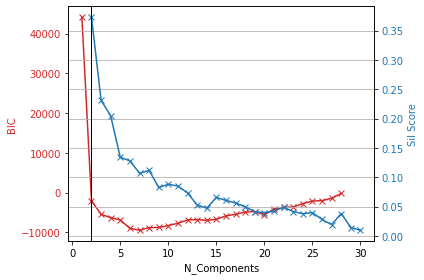

In [113]:
elbow_EM(X_w)
sil_score_plot_EM(X_w)
twinx_EM(X_w)

In [104]:
X_w_pre_scale

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,isRed,isWhite
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,1,0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,1,0
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,1,0
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,1,0
5,7.4,0.66,0.00,1.8,0.075,13.0,40.0,0.99780,3.51,0.56,9.4,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4887,6.2,0.41,0.22,1.9,0.023,5.0,56.0,0.98928,3.04,0.79,13.0,0,1
4888,6.8,0.22,0.36,1.2,0.052,38.0,127.0,0.99330,3.04,0.54,9.2,0,1
4892,6.5,0.23,0.38,1.3,0.032,29.0,112.0,0.99298,3.29,0.54,9.7,0,1
4894,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,0,1


In [102]:
pd.DataFrame(X_w)

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,0.507454,-0.399713,0.308978,1.243025,-0.645999,0.722356,1.616188,0.713074,-0.504983,-0.471531,-0.104606,-0.596811,0.596811
1,0.123926,-0.457061,-0.437520,1.416003,-0.112969,-0.283883,0.558006,0.949234,-0.755401,0.602586,-0.993009,-0.596811,0.596811
2,0.660865,-0.285017,0.308978,0.615983,-0.779257,-0.060274,0.452188,-0.771364,-1.318841,-1.277119,2.076019,-0.596811,0.596811
3,1.197804,0.288464,2.209156,-0.681345,0.953093,-1.178317,-1.311448,1.286606,1.999194,0.871115,0.056922,1.675572,-1.675572
4,1.274510,-0.112973,0.173251,-0.811077,-0.033014,-0.954709,1.051824,-0.062882,-0.504983,-0.404399,-0.589189,-0.596811,0.596811
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2923,0.660865,2.094930,-0.641111,-0.681345,0.393410,-1.066513,-1.329085,0.645599,0.872314,0.132660,-1.073772,1.675572,-1.675572
2924,-0.643130,-0.858498,1.259067,1.351136,-0.406135,0.834160,0.646188,0.814285,-0.442379,-0.672928,-1.316064,-0.596811,0.596811
2925,0.200632,0.345812,0.173251,-0.227280,-0.459439,0.219236,-0.147449,-1.091867,-0.504983,-0.538664,1.914491,-0.596811,0.596811
2926,-0.796541,-0.629106,0.444705,0.551117,-0.326181,1.337279,1.616188,0.314975,-0.317170,-0.471531,-1.073772,-0.596811,0.596811


In [91]:
X_w[:,13]

array([ 0.59681104,  0.59681104,  0.59681104, ...,  0.59681104,
        0.59681104, -1.67557222])

For n_clusters = 2 The average silhouette_score is : 0.3729099435252732
For n_clusters = 3 The average silhouette_score is : 0.2313521370425143
For n_clusters = 4 The average silhouette_score is : 0.20442222383799308
For n_clusters = 5 The average silhouette_score is : 0.13389600288588513
For n_clusters = 6 The average silhouette_score is : 0.12811382639461688


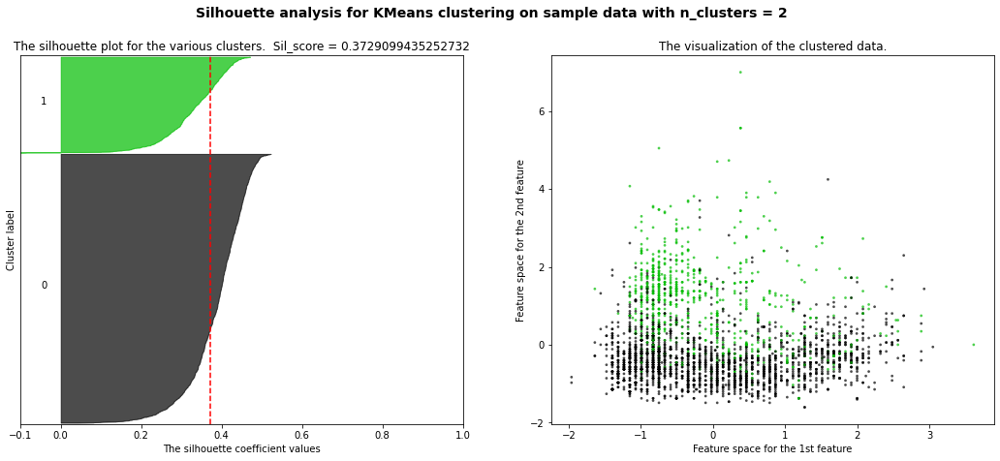

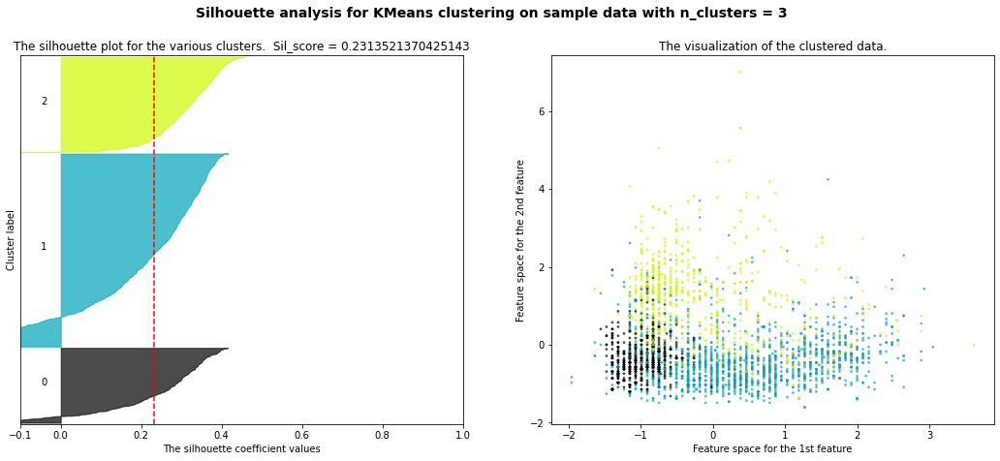

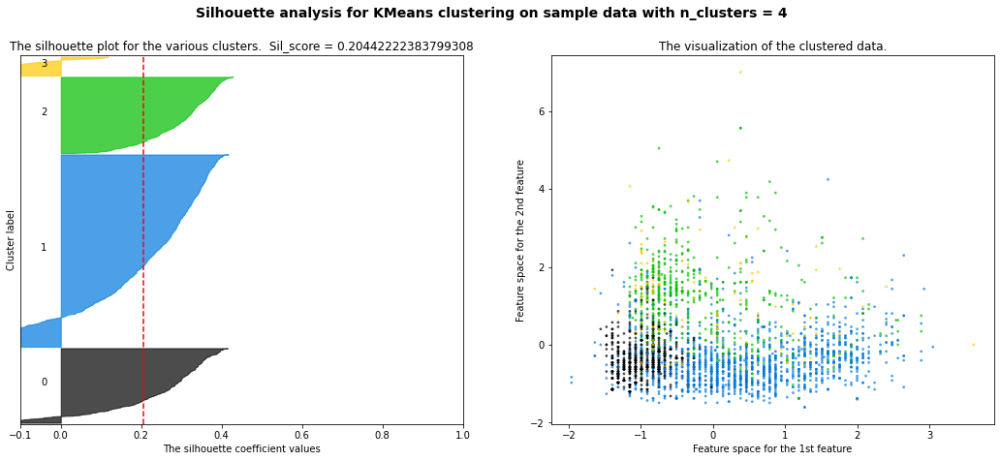

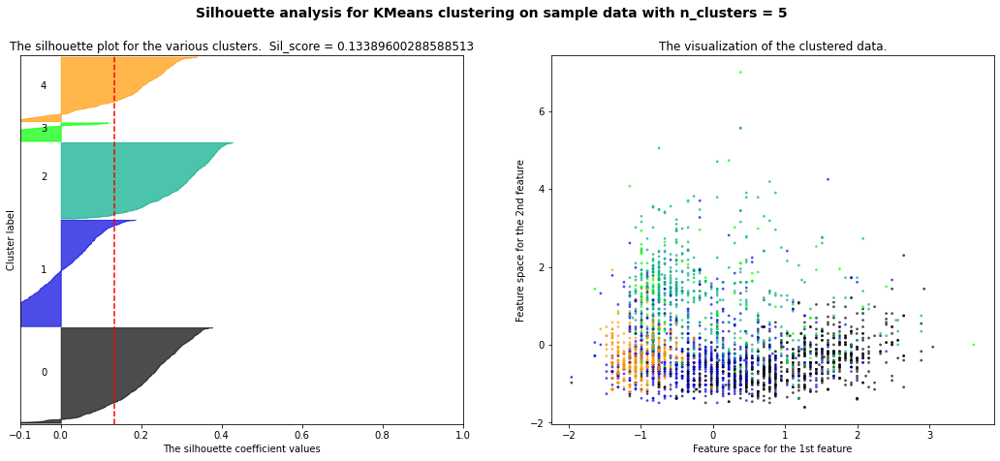

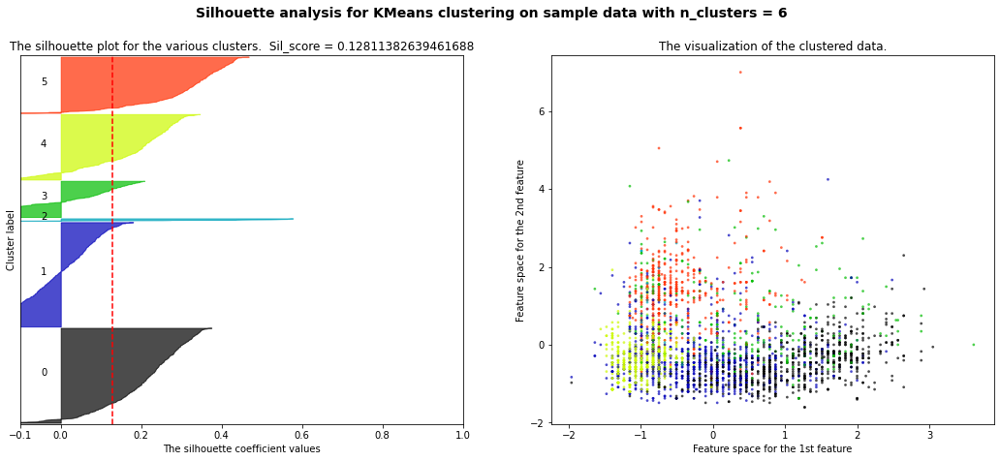

In [110]:
sil_score_EM(X_w, scatter_0 = 10, scatter_1 = 1)

Accuracy of clustering: 0.4952185792349727


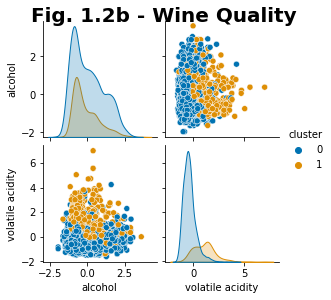

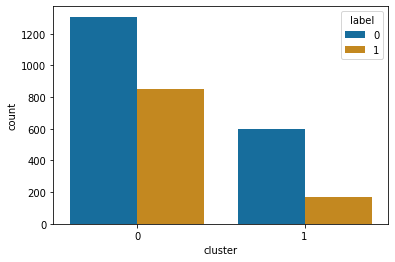

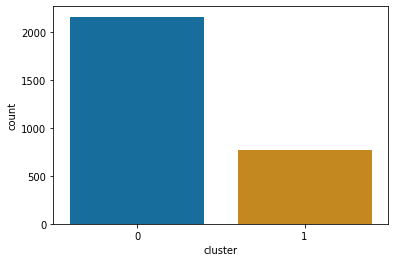

In [130]:
#Wine
n_clusters = 2
gmm_w = GaussianMixture(n_components = n_clusters, random_state = 3)
gmm_w.fit(X_w)
cluster = gmm_w.predict(X_w)
df_w = pd.DataFrame(X_w, columns = data_w.iloc[:,:-1].columns)
df_w["cluster"] = cluster
df_w["label"] = y_w.values
print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))

#g =sns.pairplot(df_w[["alcohol", "volatile acidity", "total sulfur dioxide", "sulphates","cluster"]], hue="cluster", height = 2, palette = 'colorblind')
g =sns.pairplot(df_w[["alcohol", "volatile acidity","cluster"]], hue="cluster", height = 2, palette = 'colorblind')
g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')
plt.show()
get_dist(X_w,y_w, gmm_w)

In [28]:
from sklearn.mixture import GaussianMixture
bic = []
n_components_range = range(1, 30)
for i in n_components_range:
    
    gmm = GaussianMixture(n_components = i, random_state = random_seed)
    gmm.fit(X_w)
    bic.append(gmm.bic(X_w))
    print("Num of components: " + str(i) + " bic: " + str(bic[-1]))

Num of components: 1 bic: 50877.329407829544
Num of components: 2 bic: 4637.667628992156
Num of components: 3 bic: -10794.729523415062
Num of components: 4 bic: -985.7304759802582
Num of components: 5 bic: -1353.5127483827964
Num of components: 6 bic: -8620.880212646043
Num of components: 7 bic: -27036.724692445317
Num of components: 8 bic: -29725.459740940954
Num of components: 9 bic: -30996.698183990193
Num of components: 10 bic: -25442.764001614967
Num of components: 11 bic: -28707.01953324763
Num of components: 12 bic: -26317.769018339706
Num of components: 13 bic: -25308.455616615276
Num of components: 14 bic: -26602.148704494764
Num of components: 15 bic: -24697.971499698288
Num of components: 16 bic: -25473.871237202882
Num of components: 17 bic: -25072.175315821274
Num of components: 18 bic: -24449.090740353906
Num of components: 19 bic: -23758.923594744756
Num of components: 20 bic: -24381.139376418672
Num of components: 21 bic: -23802.161099098335
Num of components: 22 bic: -

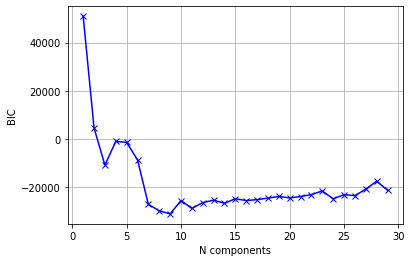

In [29]:
plt.plot([i for i in n_components_range], bic, 'bx-')
plt.xlabel('N components')
plt.ylabel('BIC')
plt.grid()

# Neural Networks + Clustering

The balanced accuracy of the Decision Tree is 0.976
              precision    recall  f1-score   support

           0       0.99      0.99      0.99        72
           1       0.98      0.98      0.98        42

    accuracy                           0.98       114
   macro avg       0.98      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114



/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (275) reached and the optimization hasn't converged yet.
  warnings.warn(


Train Score Mean 0.9821613747292108
Test Score Mean 0.9699356478477179


<module 'matplotlib.pyplot' from '/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

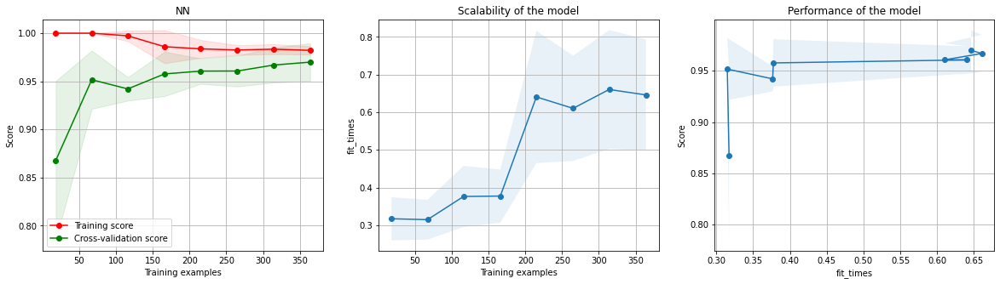

In [81]:
from sklearn.neural_network import MLPClassifier
original_nn = MLPClassifier( alpha = 0.886, activation = 'tanh', hidden_layer_sizes = (5,5), max_iter=275, random_state =1, solver = 'sgd'
                          , momentum = 0.978947)
original_nn.fit(X_b, y_b)
prediction=original_nn.predict(X_b_test)
print('The balanced accuracy of the Decision Tree is',"{:.3f}".format(metrics.f1_score(prediction,y_b_test)))
print(classification_report(prediction,y_b_test))
plot_learning_curve(original_nn, X_b, y_b, "NN")

## NN - Breast Cancer - Kmeans

In [84]:
#Breast Cancer
n_clusters =2 
km_b = KMeans(n_clusters=n_clusters, random_state = random_seed)
km_b = km_b.fit(X_b)
cluster_kmeans = km_b.predict(X_b)
cluster_kmeans_test = km_b.predict(X_b_test)
#cluster = np.array([cluster])

X_b_cluster_kmeans= np.concatenate((X_b, cluster_kmeans[:,None]), axis=1)
X_b_cluster_kmeans_test= np.concatenate((X_b_test, cluster_kmeans_test[:,None]), axis=1)

# test = pd.DataFrame(X_b_cluster)
# test[[30]].hist()

In [ ]:
nn_b_kmeans = MLPClassifier( alpha = 0.886, activation = 'tanh', hidden_layer_sizes = (5,5), max_iter=275, random_state =1, solver = 'sgd'
                          , momentum = 0.978947)

nn = nn_b_kmeans
X_train = X_b_cluster_kmeans
X_test = X_b_cluster_kmeans_test

nn.fit(X_b, y_b)
prediction=nn.predict(X_b_test)
print('The balanced accuracy of the Decision Tree is',"{:.3f}".format(metrics.f1_score(prediction,y_b_test)))
print(classification_report(prediction,y_b_test))
plot_learning_curve(nn, X_b, y_b, "NN")


# DR Summary

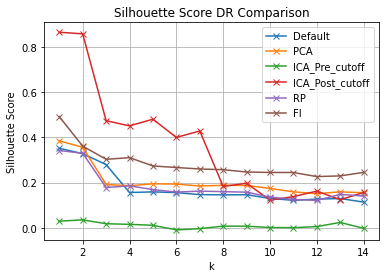

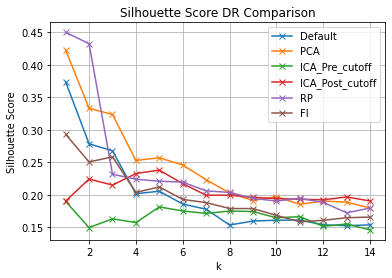

In [613]:
from sklearn.decomposition import PCA, FastICA as ICA
from scipy import sparse
from sklearn import decomposition
from sklearn import random_projection
from sklearn.metrics import mean_squared_error as MSE

#PCA
bc_pca_n = 6
pca_bc = PCA(n_components = bc_pca_n)
X_b_pca = pca_bc.fit_transform(X_b)

wine_pca_n = 6
pca_wine = PCA(n_components = wine_pca_n)
X_w_pca = pca_wine.fit_transform(X_w)

#ICA
ica_b = ICA(random_state=2, n_components = 26)
X_b_ICA = ica_b.fit_transform(X_b)
df_b_ICA = pd.DataFrame(X_b_ICA)
selected_IC_b = [16, 7, 23, 12, 8, 9]
X_b_ICA_original = X_b_ICA
X_b_ICA = df_b_ICA[selected_ICs].values


ica_w = ICA(random_state=2, n_components = 8)
selected_IC_w = [3,1,0,7]
X_w_ICA = ica_w.fit_transform(X_w)
df_w_ICA = pd.DataFrame(X_w_ICA)
X_w_ICA_original = X_w_ICA
X_w_ICA = df_w_ICA[selected_IC_w].values

#RP
rp_b = random_projection.GaussianRandomProjection(random_state=2, n_components = 22)
X_b_rp = rp_b.fit_transform(X_b)

rp_w = random_projection.GaussianRandomProjection(random_state=2, n_components = 10)
X_w_rp = rp_w.fit_transform(X_w)

#FI
selected_FI_b = ["perimeter_worst", "concave points_worst", "texture_worst", "radius_worst",
                "area_se"]
df_b_FI = pd.DataFrame(X_b, columns = X_b_pre_scale.columns)
X_b_FI = df_b_FI[selected_FI_b].to_numpy()

selected_FI_w = ["alcohol", "volatile acidity", "residual sugar", "sulphates",
                "total sulfur dioxide", "free sulfur dioxide","fixed acidity", "chlorides"]

df_w_FI = pd.DataFrame(X_w, columns = X_w_pre_scale.columns)
X_w_FI = df_w_FI[selected_FI_w].to_numpy()

X_b_dict = {
    "Default" : X_b,
    "PCA" : X_b_pca,
    "ICA_Pre_cutoff" : X_b_ICA_original,
    "ICA_Post_cutoff" : X_b_ICA,
    "RP" : X_b_rp,
    "FI" : X_b_FI
}
sil_score_multi_plot(X_b_dict)

X_w_dict = {
    "Default" : X_w,
    "PCA" : X_w_pca,
    "ICA_Pre_cutoff" : X_w_ICA_original,
    "ICA_Post_cutoff" : X_w_ICA,
    "RP" : X_w_rp,
    "FI" : X_w_FI
}
sil_score_multi_plot(X_w_dict)

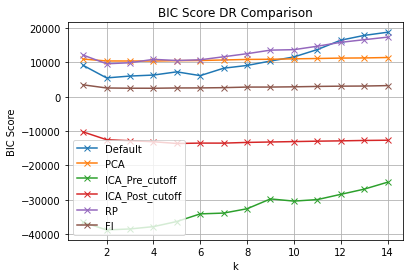

In [612]:
X_b_dict = {
    "Default" : X_b,
    "PCA" : X_b_pca,
    "ICA_Pre_cutoff" : X_b_ICA_original,
    "ICA_Post_cutoff" : X_b_ICA,
    "RP" : X_b_rp,
    "FI" : X_b_FI
}
BIC_score_multi_plot(X_b_dict, K=15)

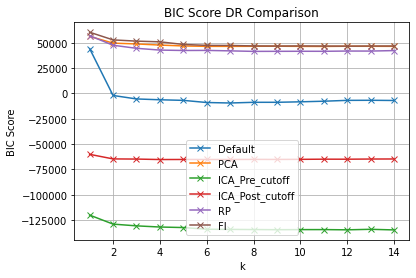

In [611]:
X_w_dict = {
    "Default" : X_w,
    "PCA" : X_w_pca,
    "ICA_Pre_cutoff" : X_w_ICA_original,
    "ICA_Post_cutoff" : X_w_ICA,
    "RP" : X_w_rp,
    "FI" : X_w_FI
}
BIC_score_multi_plot(X_w_dict)

# PCA

In [73]:
from matplotlib.lines import Line2D
def twinx_PCA(X, k = 30, random_seed = 2, axlinex = 6, axliney = 0.9, title = "EigenValue Explained Var and CDF"):

    # Create some mock data
    pca = PCA()
    pca.fit(X)
    fig, ax1 = plt.subplots()

    color = 'tab:red'
    ax1.set_xlabel('N_Components')
    ax1.set_ylabel('Explained Variance Ratio', color=color, size = 15)
    x,y = elbow_EM(X, return_result =True)
    ax1.plot([i +1 for i in range(len(pca.explained_variance_ratio_))], pca.explained_variance_ratio_, 'bx-', color = color)

    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax1.axvline(x = axlinex ,linewidth=1, color = "orange", label = "N components selected")

    color = 'tab:blue'
    ax2.set_ylabel('CDF', color=color, size = 20)  # we already handled the x-label with ax1

    x,y = sil_score_plot_EM(X, return_result =True)
    ax2.plot([i for i in range(len(pca.explained_variance_ratio_))], np.cumsum(pca.explained_variance_ratio_), 'x-', color = color)
    ax2.tick_params(axis='y', labelcolor="black")
    ax2.axhline(y = axliney ,linewidth=1, label = "90% Variance Line", color = "blue")
    colors = ['orange', 'blue']
    lines = [Line2D([0], [0], color=c, linewidth=1) for c in colors]
    labels = ['N Components Selected', '90% Variance Line']
    plt.legend(lines, labels, loc = "center right")
    
    plt.title(title, fontdict={'fontsize': 15, 'fontweight': 'heavy'})

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.grid(True)
    plt.show()

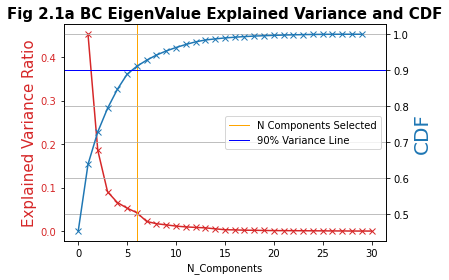

In [74]:
twinx_PCA(X_b, title = "Fig 2.1a BC EigenValue Explained Variance and CDF")

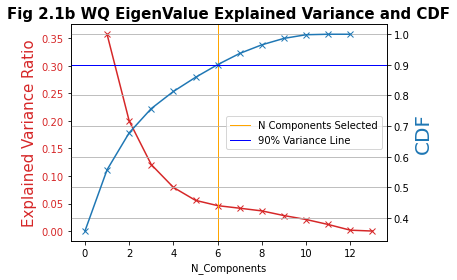

In [75]:
twinx_PCA(X_w, title ="Fig 2.1b WQ EigenValue Explained Variance and CDF")

In [44]:
from sklearn.decomposition import PCA
pca_b, pca_w = PCA(), PCA()
pca_b.fit(X_b)
pca_w.fit(X_w)

PCA()

In [18]:
pca_b.explained_variance_ratio_

array([4.52544306e-01, 1.85567495e-01, 9.02676597e-02, 6.56393348e-02,
       5.26481067e-02, 4.22071599e-02, 2.20911463e-02, 1.69007377e-02,
       1.42258912e-02, 1.14132344e-02, 9.55334962e-03, 8.41205805e-03,
       7.36179336e-03, 5.16531832e-03, 3.04864579e-03, 2.70610221e-03,
       1.95750790e-03, 1.79649301e-03, 1.37554465e-03, 1.04844889e-03,
       9.52940224e-04, 8.32308779e-04, 6.95145279e-04, 5.57393680e-04,
       4.63733474e-04, 2.71466380e-04, 2.22824995e-04, 4.88127595e-05,
       2.04226085e-05, 4.61829271e-06])

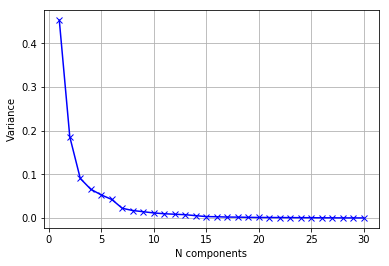

In [19]:
plt.plot([i +1 for i in range(len(pca_b.explained_variance_ratio_))], pca_b.explained_variance_ratio_, 'bx-')
plt.xlabel('N components')
plt.ylabel('Variance')
plt.grid()

This means that 90 percent of the variance is captured in the first 5 components

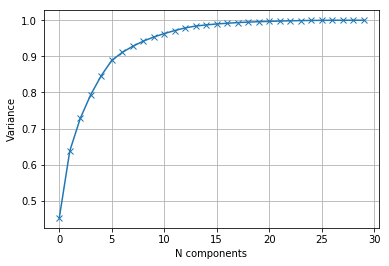

In [20]:
plt.plot([i for i in range(len(pca_b.explained_variance_ratio_))], np.cumsum(pca_b.explained_variance_ratio_), 'x-')
plt.xlabel('N components')
plt.ylabel('Variance')
plt.grid()

Sil score is higher

In [536]:
bc_pca_n = 6
pca_bc = PCA(n_components = bc_pca_n)
X_b_pca = pca_bc.fit_transform(X_b)

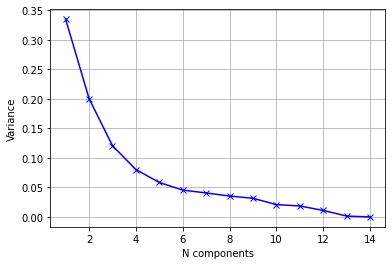

In [537]:
plt.plot([i +1 for i in range(len(pca_w.explained_variance_ratio_))], pca_w.explained_variance_ratio_, 'bx-')
plt.xlabel('N components')
plt.ylabel('Variance')
plt.grid()

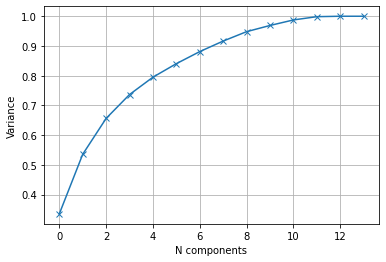

In [538]:
plt.plot([i for i in range(len(pca_w.explained_variance_ratio_))], np.cumsum(pca_w.explained_variance_ratio_), 'x-')
plt.xlabel('N components')
plt.ylabel('Variance')
plt.grid()

In [45]:
wine_pca_n = 6
pca_wine = PCA(n_components = wine_pca_n)
X_w_pca = pca_wine.fit_transform(X_w)

# Reconstruction

In [427]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score
def reconstruction_error(X, model):
    X_transformed = model.fit_transform(X)
    X_inverse = model.inverse_transform(X_transformed)
    mse = mean_squared_error(X, X_inverse)
    print("Reconstruction Error (" + str(model.n_components) +") MSE: " + str(mse))
    return mse
    
def reconstruction_error_plot(X, model, n_comp_range = 15):
    mse = []
    for i in range(1,n_comp_range +1):
        model.n_components = i
        mse.append(reconstruction_error(X, model))
        
    plt.plot(range(1,n_comp_range +1), mse, 'x-')
    plt.xlabel('N components')
    plt.ylabel('MSE')
    plt.title("Reconstruction Error")
    plt.grid()

Reconstruction Error (1) MSE: 0.5474556940487584
Reconstruction Error (2) MSE: 0.361888198911803
Reconstruction Error (3) MSE: 0.27162053917354034
Reconstruction Error (4) MSE: 0.2059812043886647
Reconstruction Error (5) MSE: 0.1533330977138311
Reconstruction Error (6) MSE: 0.11112593783450292
Reconstruction Error (7) MSE: 0.08903479156091926
Reconstruction Error (8) MSE: 0.07213405387250263
Reconstruction Error (9) MSE: 0.057908162657130426
Reconstruction Error (10) MSE: 0.0464949282643788
Reconstruction Error (11) MSE: 0.03694157864527513
Reconstruction Error (12) MSE: 0.028529520599892392
Reconstruction Error (13) MSE: 0.021167727242308157
Reconstruction Error (14) MSE: 0.016002408917976652
Reconstruction Error (15) MSE: 0.012953763130805472


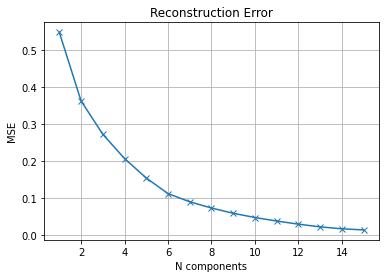

In [51]:
reconstruction_error_plot(X_b, pca_bc)

In [36]:
print("Transform Breast Cancer data - PCA with " + str(bc_pca_n) +" components")
pca_bc = PCA(n_components = bc_pca_n)
reconstruction_error(X_b, pca_bc)
X_b_pca = pca_bc.fit_transform(X_b)
pca_bc.components_

Transform Breast Cancer data - PCA with 5 components
Reconstruction Error (5) MSE: 0.15333309771383113


array([[ 0.21679334,  0.10660312,  0.22557851,  0.21886594,  0.14066045,
         0.23936605,  0.25444238,  0.25775276,  0.14120408,  0.07237829,
         0.20600989,  0.01378187,  0.21367988,  0.20798454,  0.00307547,
         0.17102664,  0.14768555,  0.18439201,  0.04163771,  0.10122214,
         0.226975  ,  0.10755498,  0.23567844,  0.2237171 ,  0.12867934,
         0.21426764,  0.2282569 ,  0.24993858,  0.12582219,  0.13879824],
       [-0.23462306, -0.06849448, -0.2151757 , -0.23224295,  0.1848655 ,
         0.14475358,  0.06573624, -0.03731318,  0.18138941,  0.3662257 ,
        -0.09883883,  0.0763412 , -0.07861921, -0.15183423,  0.2049454 ,
         0.2377156 ,  0.20931191,  0.1409671 ,  0.19936217,  0.2828757 ,
        -0.22124091, -0.06136208, -0.20066026, -0.22093973,  0.15776067,
         0.13415898,  0.09876787, -0.00967411,  0.13847033,  0.26770452],
       [-0.01122046,  0.11519641, -0.01236771,  0.01855292, -0.15466491,
        -0.07274737,  0.00196951, -0.03625782, -0

Text(0.5, 1.02, 'Fig. 1.2b - Breast Cancer')

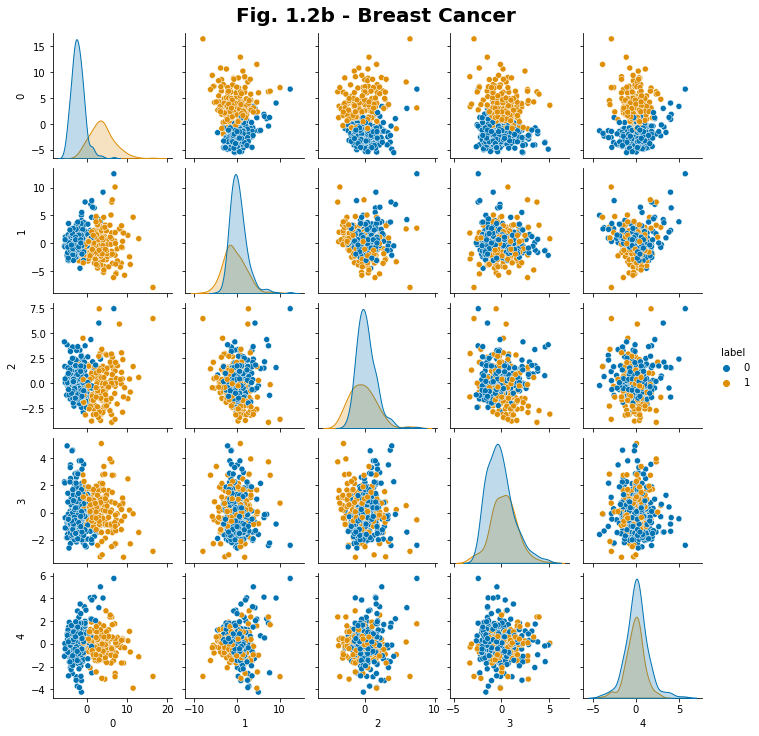

In [53]:
df_b = pd.DataFrame(X_b_pca)
df_b["label"] = y_b.values
g =sns.pairplot(df_b, hue="label", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')

The fact that there is no linear relationship shows the lack of correlation
Rather than data being spread across multiple features, PCA 1 and 2 contain most of the data for separating them

In [54]:
print("Transform Wine data - PCA with " + str(wine_pca_n) +" components")
pca_wine = PCA(n_components = wine_pca_n)
X_w_pca = pca_wine.fit_transform(X_w)

reconstruction_error(X_w, pca_wine)

Transform Wine data - PCA with 6 components
Reconstruction Error (6) MSE: 0.15950105886118826


0.15950105886118826

# Clustering + PCA

## KMeans

Smaller amount of SSE

Using Kneed
3


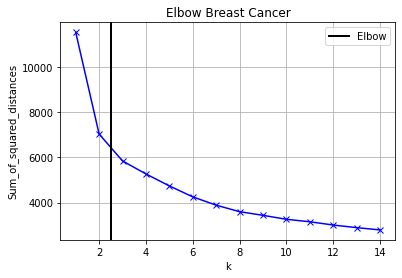

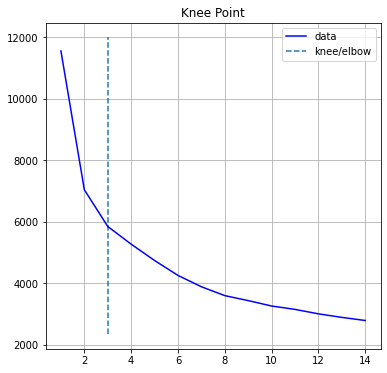

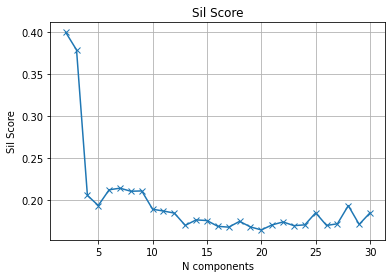

In [527]:
elbow(X_b_pca, title ="Elbow Breast Cancer")
sil_score_plot(X_b_pca)


For n_clusters = 2 The average silhouette_score is : 0.3998336134779129
For n_clusters = 3 The average silhouette_score is : 0.37883429857136053
For n_clusters = 4 The average silhouette_score is : 0.3276651985671744
For n_clusters = 5 The average silhouette_score is : 0.1958914810673308
For n_clusters = 6 The average silhouette_score is : 0.20887022250387818


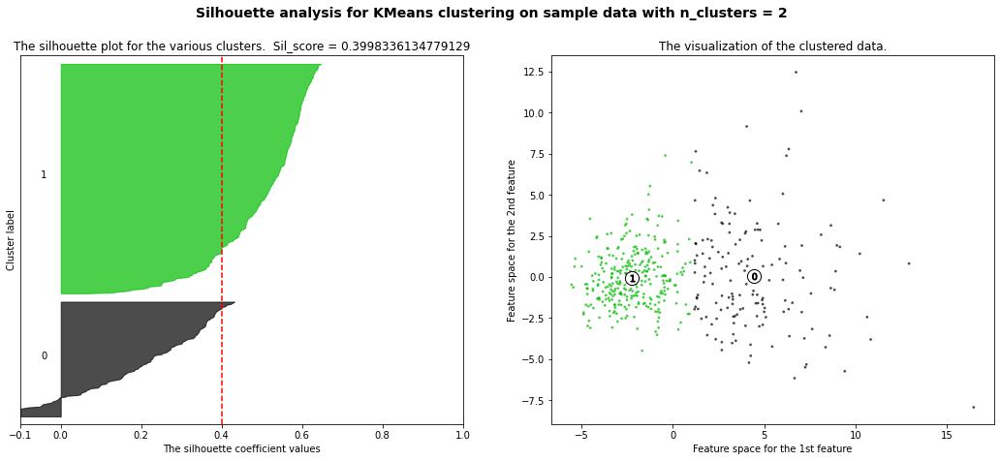

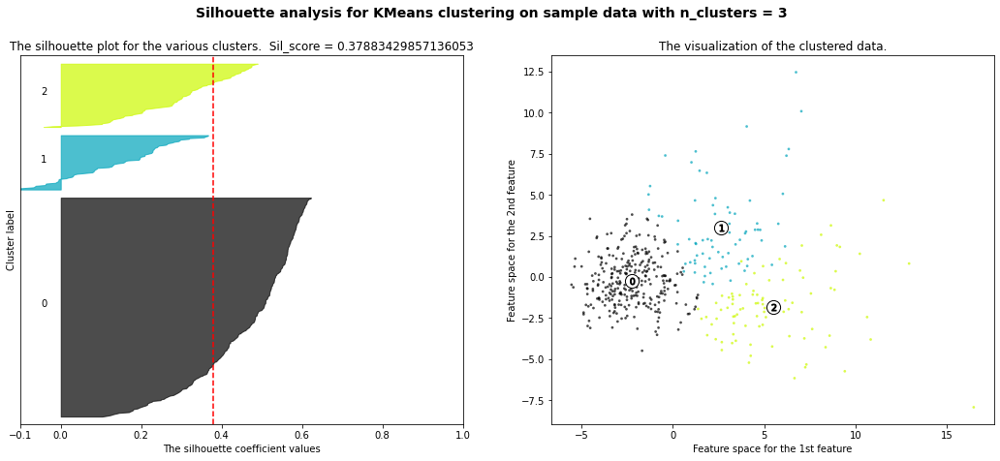

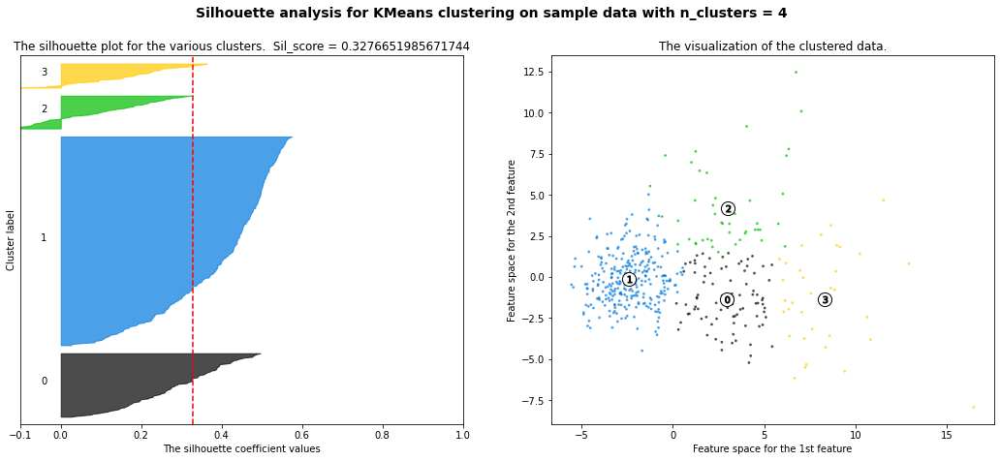

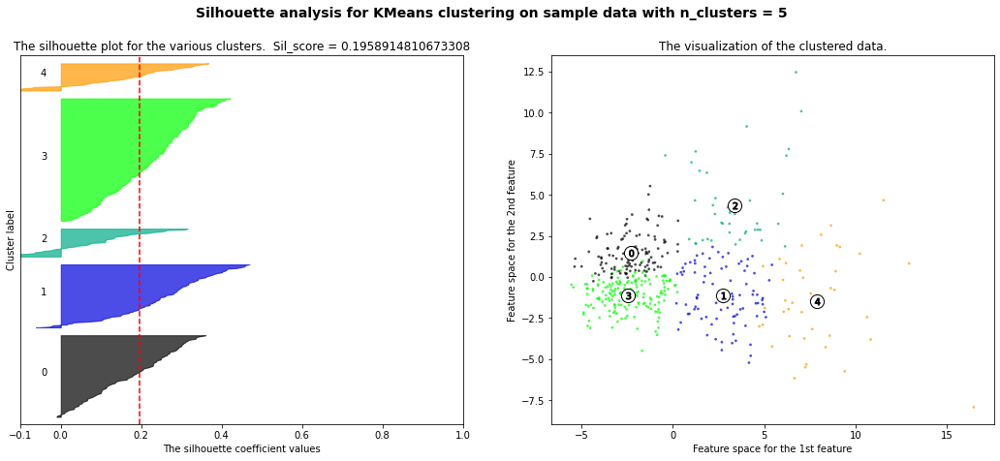

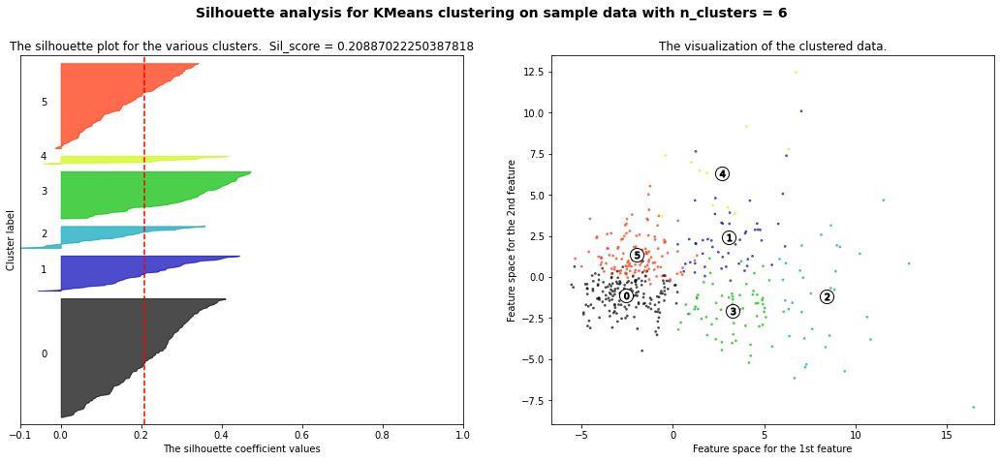

In [70]:
sil_score_kmeans_2(X_b_pca, random_seed=1)

Using Kneed
5


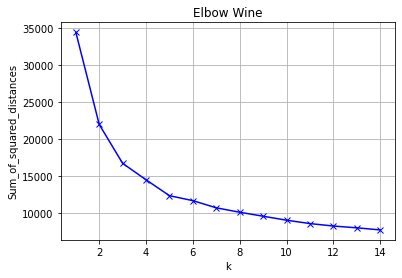

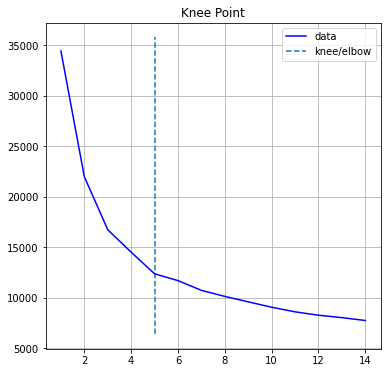

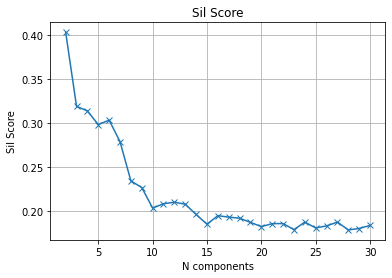

In [71]:
elbow(X_w_pca, title ="Elbow Wine")
sil_score_plot(X_w_pca)

For n_clusters = 2 The average silhouette_score is : 0.40353875446125653
For n_clusters = 3 The average silhouette_score is : 0.31922481775478095
For n_clusters = 4 The average silhouette_score is : 0.31403541223221004
For n_clusters = 5 The average silhouette_score is : 0.29853787541897714
For n_clusters = 6 The average silhouette_score is : 0.26049385769378164


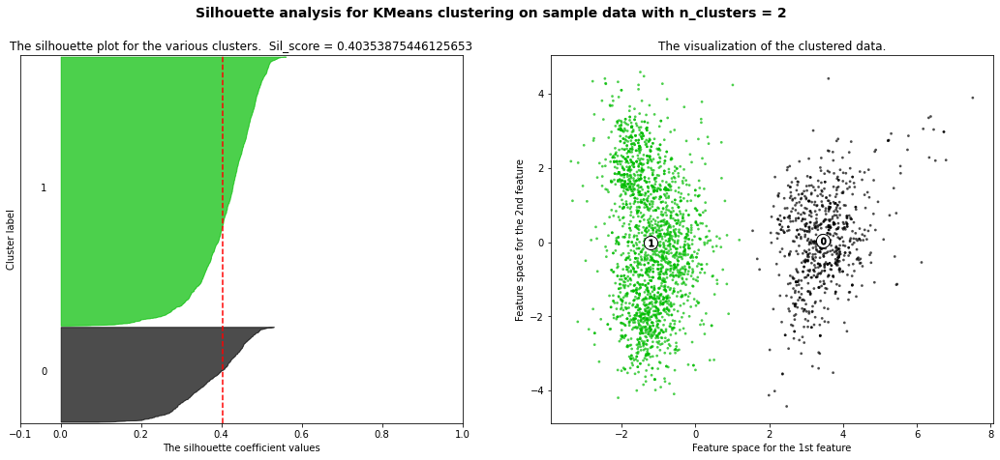

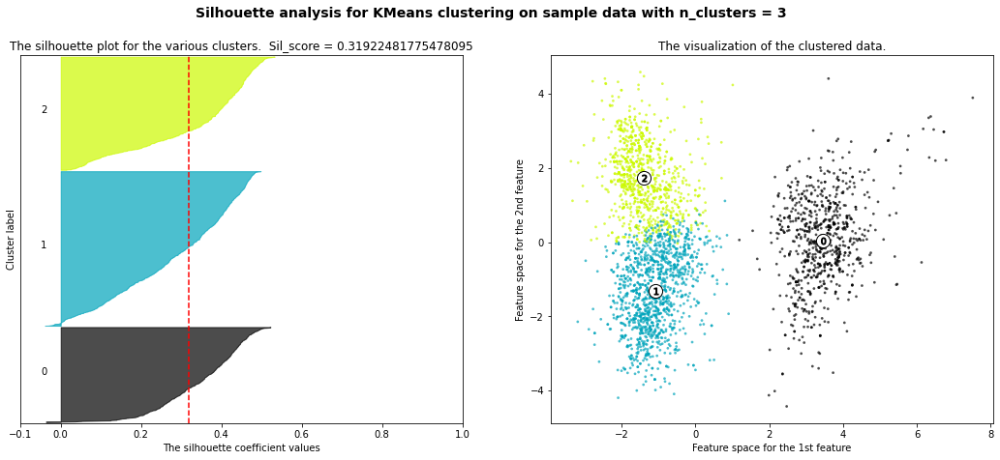

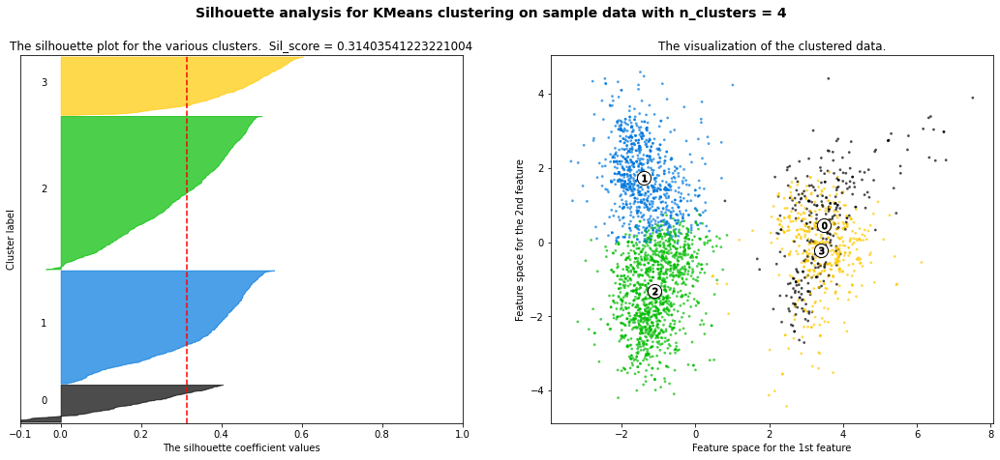

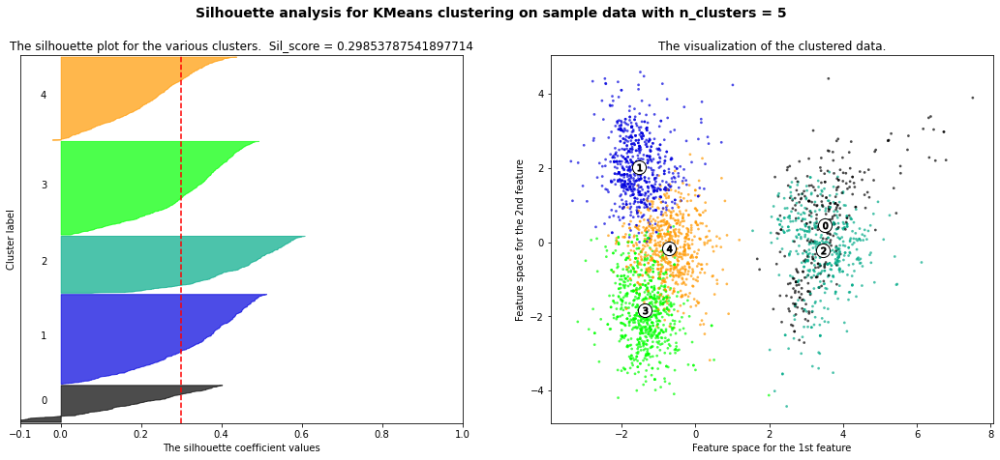

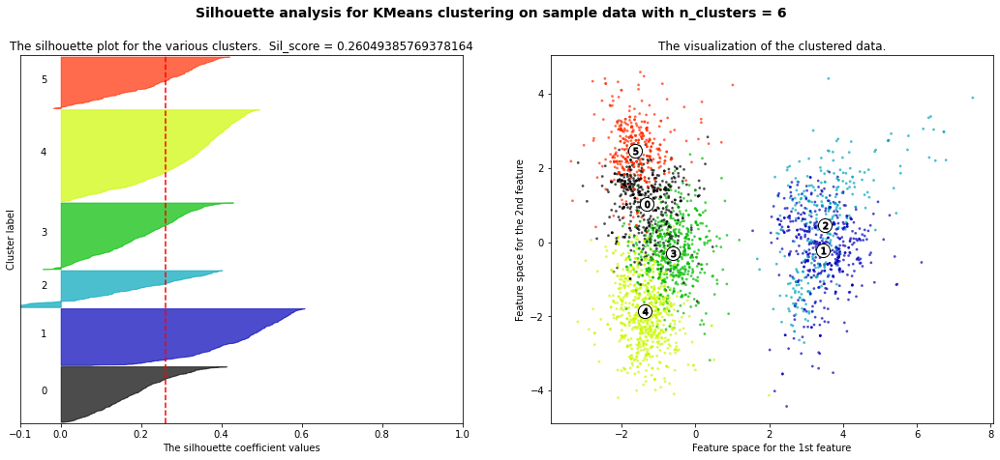

In [73]:
sil_score_kmeans_2(X_w_pca, random_seed=1)

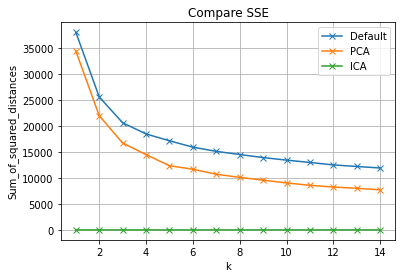

In [526]:
X_dict = {
    "Default" : X_w,
    "PCA" : X_w_pcas
}
multiple_elbow(X_dict)

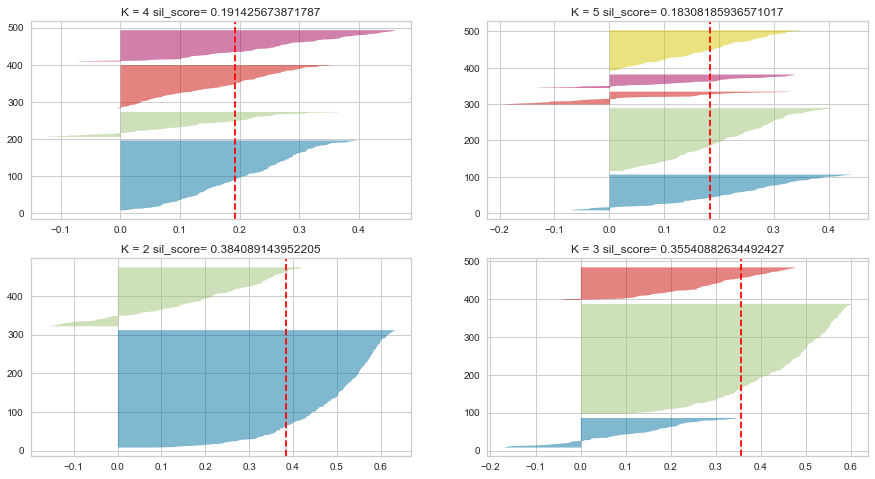

In [82]:
sil_score_kmeans(X_b_pca, random_seed=1)

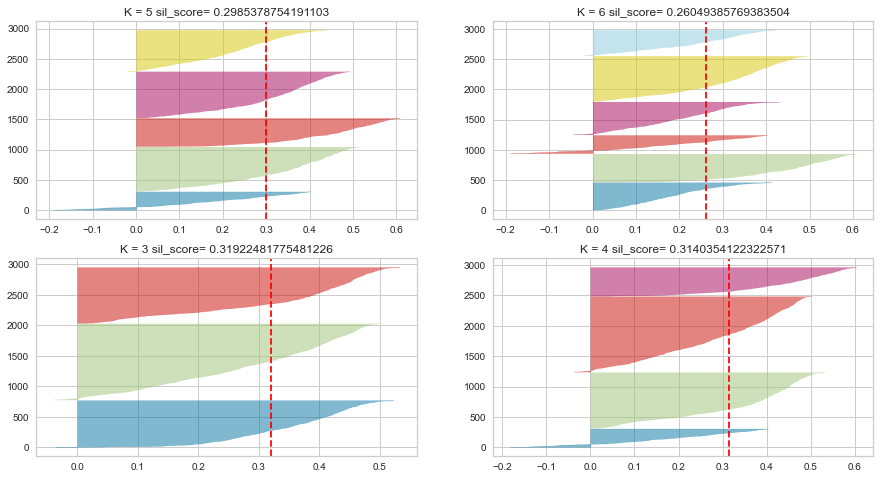

In [102]:
sil_score_kmeans(X_w_pca, k_values = [3,4,5,6],random_seed=1)

In [77]:
X_w_prescale

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,isRed,isWhite,label
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,1,0,0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5,1,0,0
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5,1,0,0
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,1,0,0
5,7.4,0.66,0.00,1.8,0.075,13.0,40.0,0.99780,3.51,0.56,9.4,5,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4887,6.2,0.41,0.22,1.9,0.023,5.0,56.0,0.98928,3.04,0.79,13.0,7,0,1,1
4888,6.8,0.22,0.36,1.2,0.052,38.0,127.0,0.99330,3.04,0.54,9.2,5,0,1,0
4892,6.5,0.23,0.38,1.3,0.032,29.0,112.0,0.99298,3.29,0.54,9.7,5,0,1,0
4894,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,5,0,1,0


For n_clusters = 2 The average silhouette_score is : 0.3507233146171828
For n_clusters = 3 The average silhouette_score is : 0.2601905654156562
For n_clusters = 4 The average silhouette_score is : 0.2303461980551801
For n_clusters = 5 The average silhouette_score is : 0.23258688967045568
For n_clusters = 6 The average silhouette_score is : 0.23791088588387937


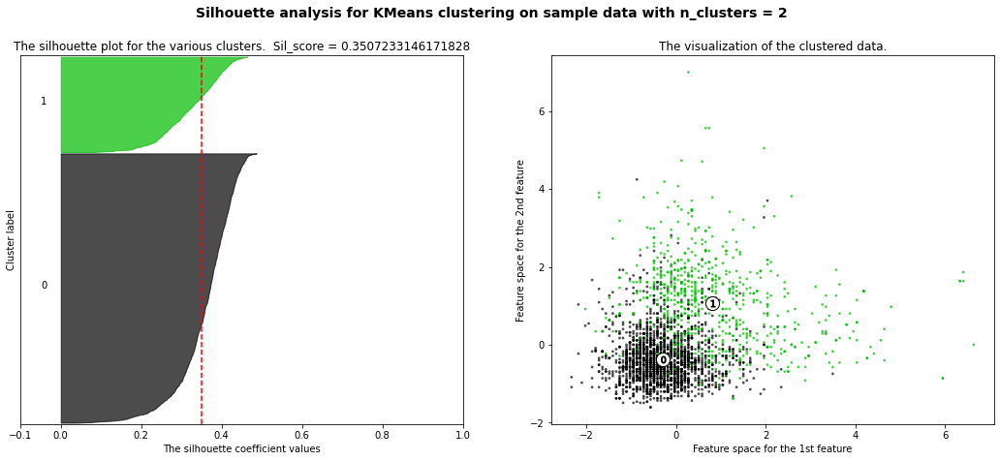

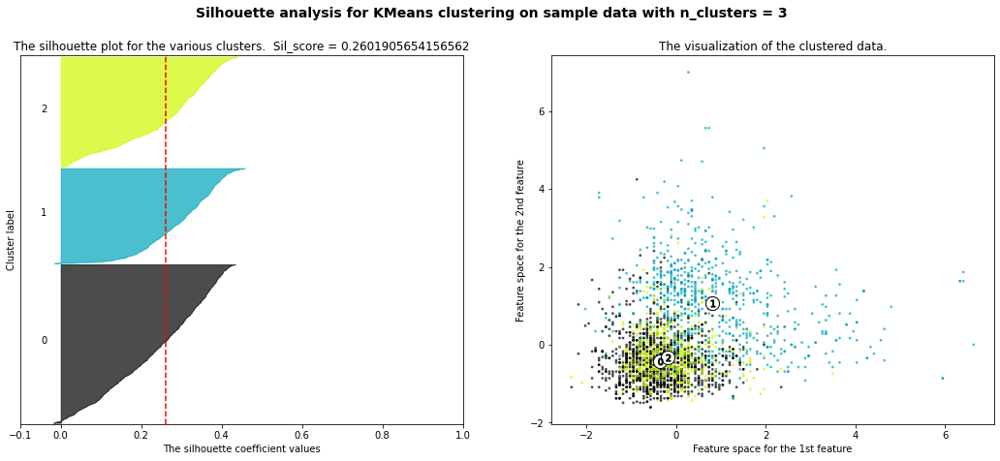

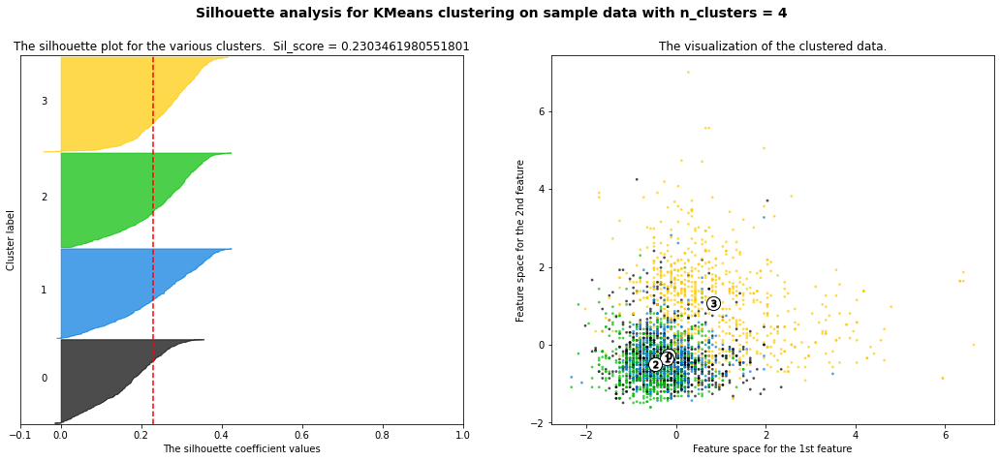

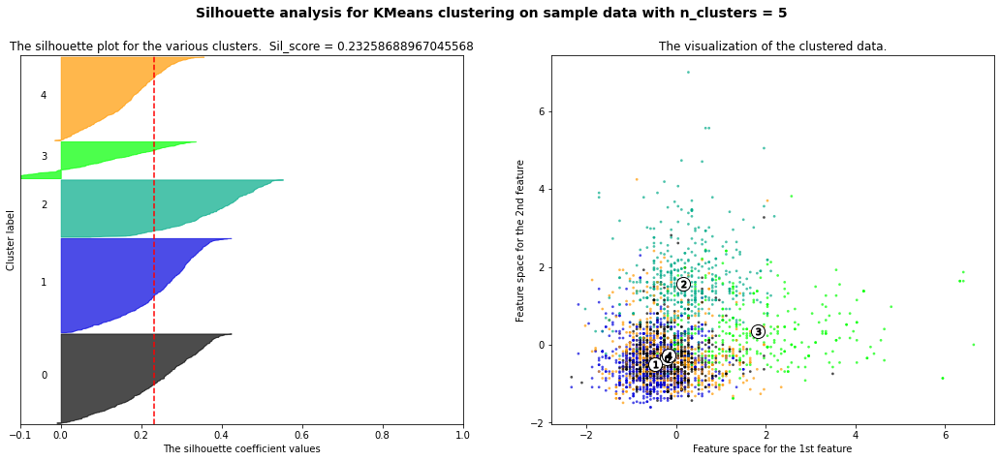

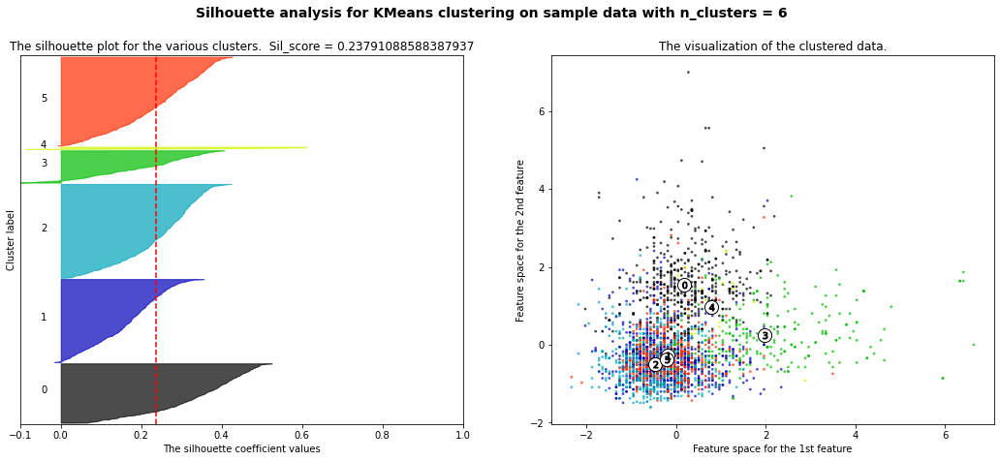

In [23]:
sil_score_kmeans_2(X_w)

## BC PCA Kmeans = 2; Wine PCA Kmeans = 5; 

Accuracy of clustering: 0.9032967032967033


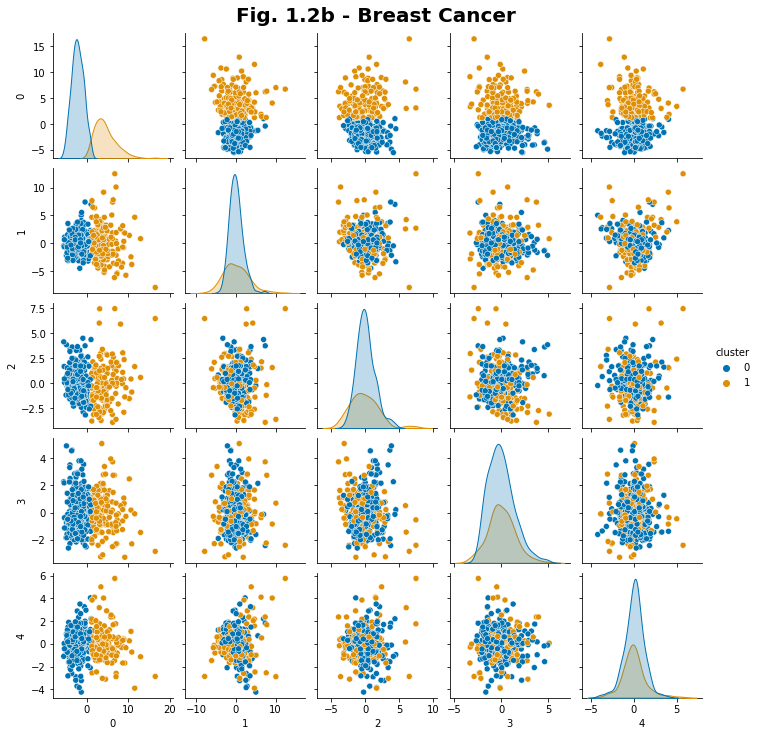

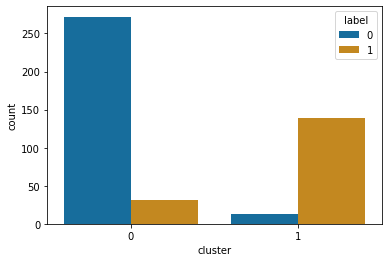

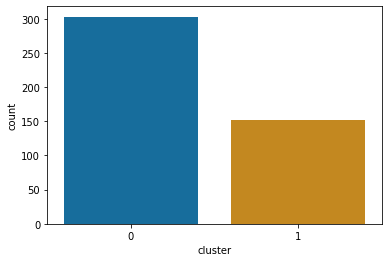

In [20]:
n_clusters = 2
X_val = X_b_pca
km_b = KMeans(n_clusters=n_clusters, random_state = 2)
km_b = km_b.fit(X_val)
cluster = km_b.predict(X_val)
df_b = pd.DataFrame(X_val)
df_b["cluster"] = cluster
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, km_b)

Accuracy of clustering: 0.22438524590163936


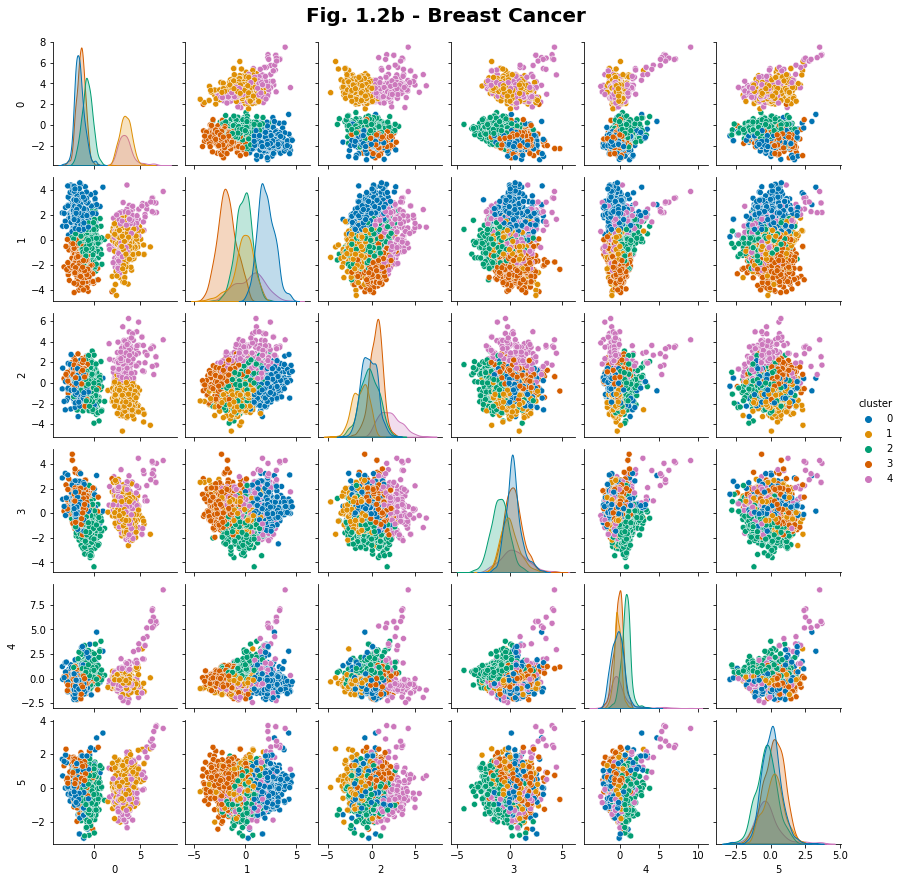

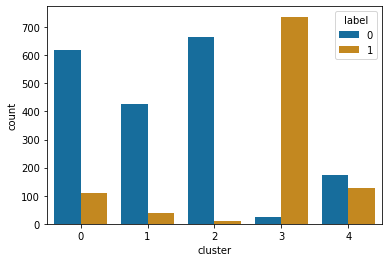

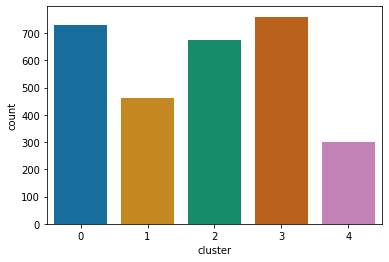

In [80]:
n_clusters = 5
X_val = X_w_pca
km_w = KMeans(n_clusters=n_clusters, random_state = 2)

km_w.fit(X_val)
cluster = km_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
df_w["label"] = y_w.values
print("Accuracy of clustering: " + str(accuracy_score(y_w, cluster)))
plt.show()

get_dist(X_val, y_w, km_w)

### EM + PCA 

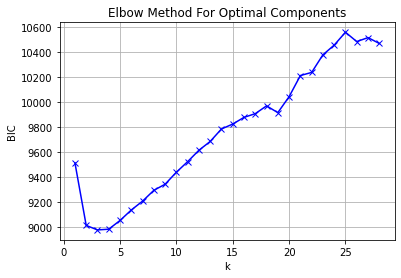

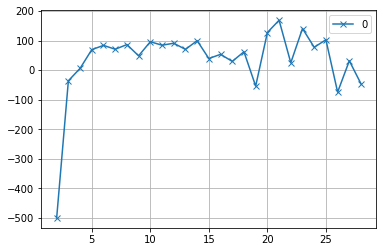

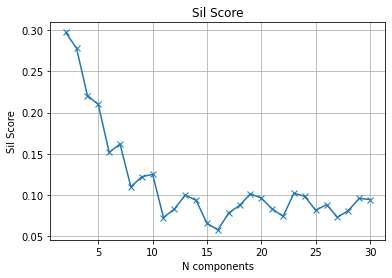

In [94]:
elbow_EM(X_b_pca)
sil_score_plot_EM(X_b_pca)

For n_clusters = 2 The average silhouette_score is : 0.2974713336229339
For n_clusters = 3 The average silhouette_score is : 0.2779118809436087
For n_clusters = 4 The average silhouette_score is : 0.22069271566191737
For n_clusters = 5 The average silhouette_score is : 0.20984757903743875
For n_clusters = 6 The average silhouette_score is : 0.1515899674117154


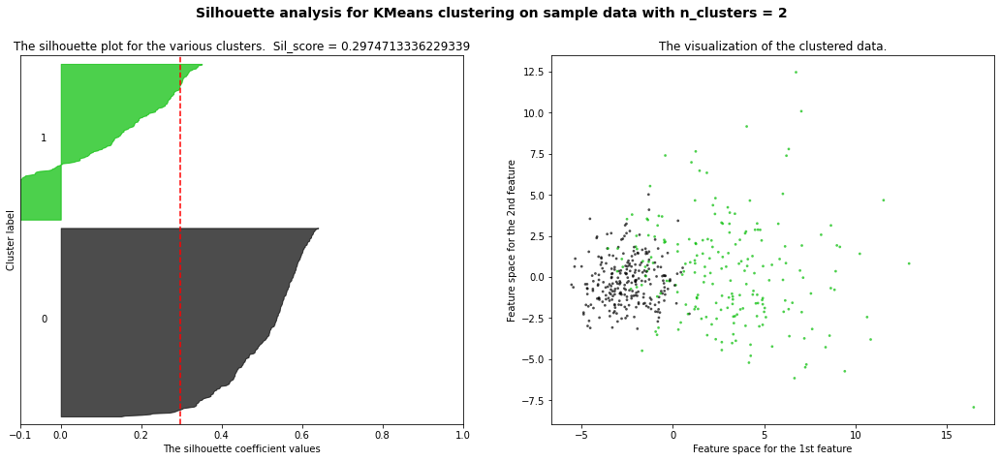

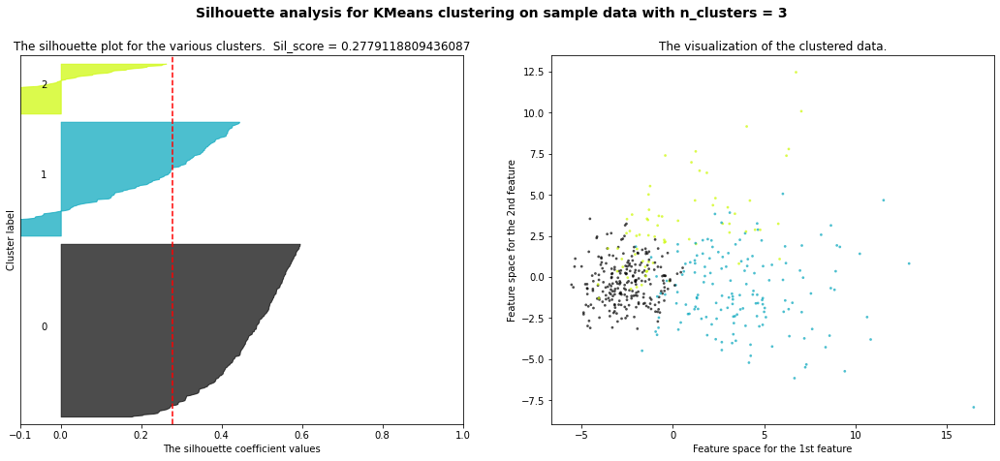

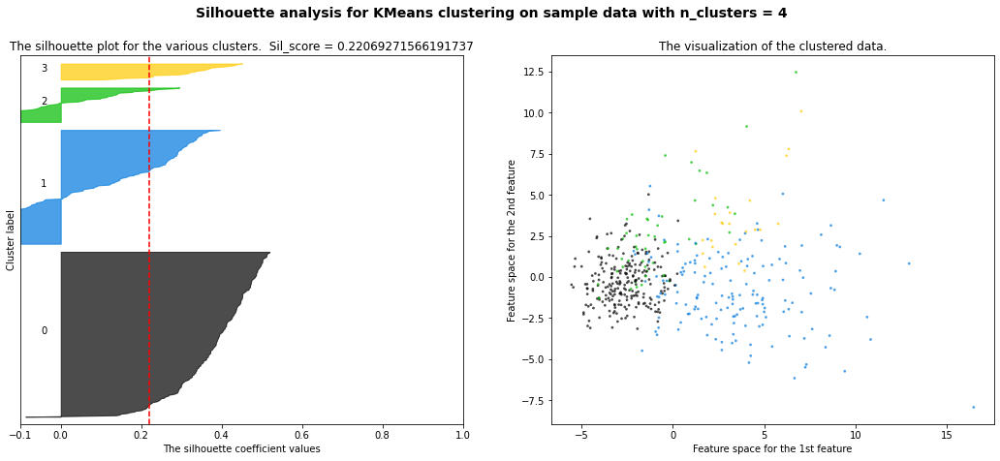

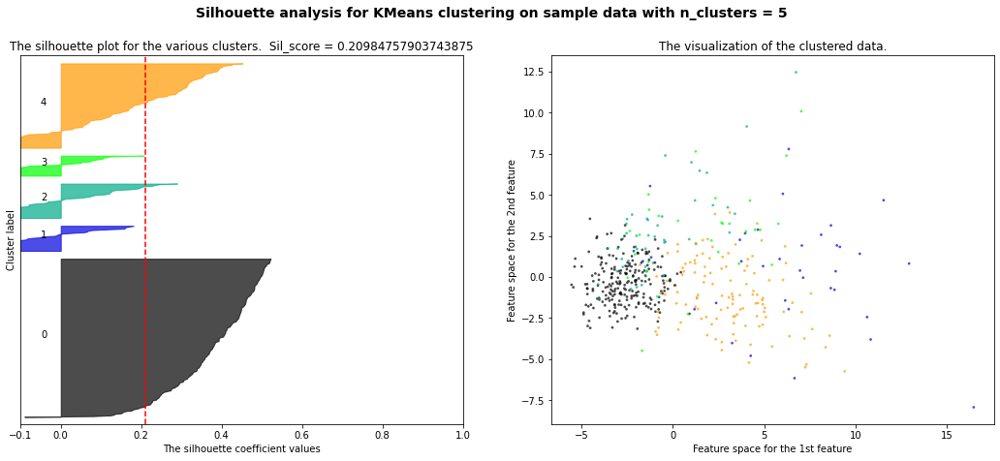

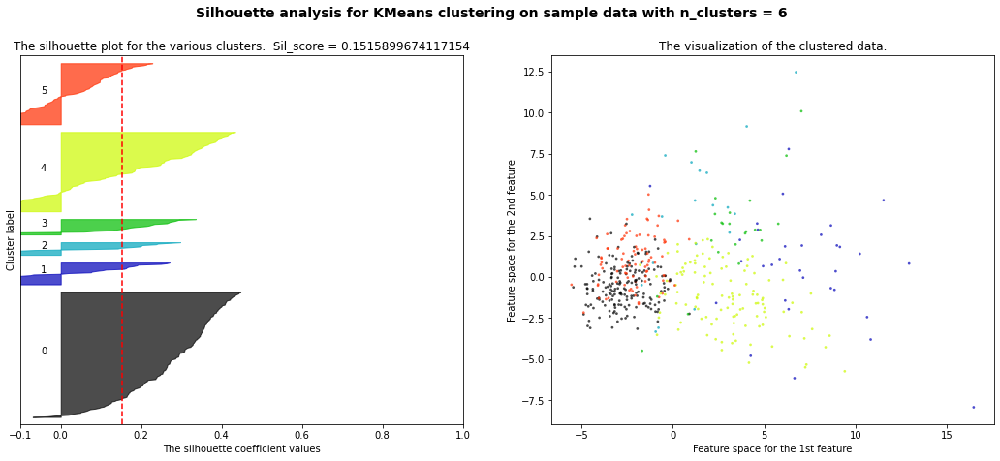

In [95]:
sil_score_EM(X_b_pca)

Accuracy of clustering: 0.8219780219780219


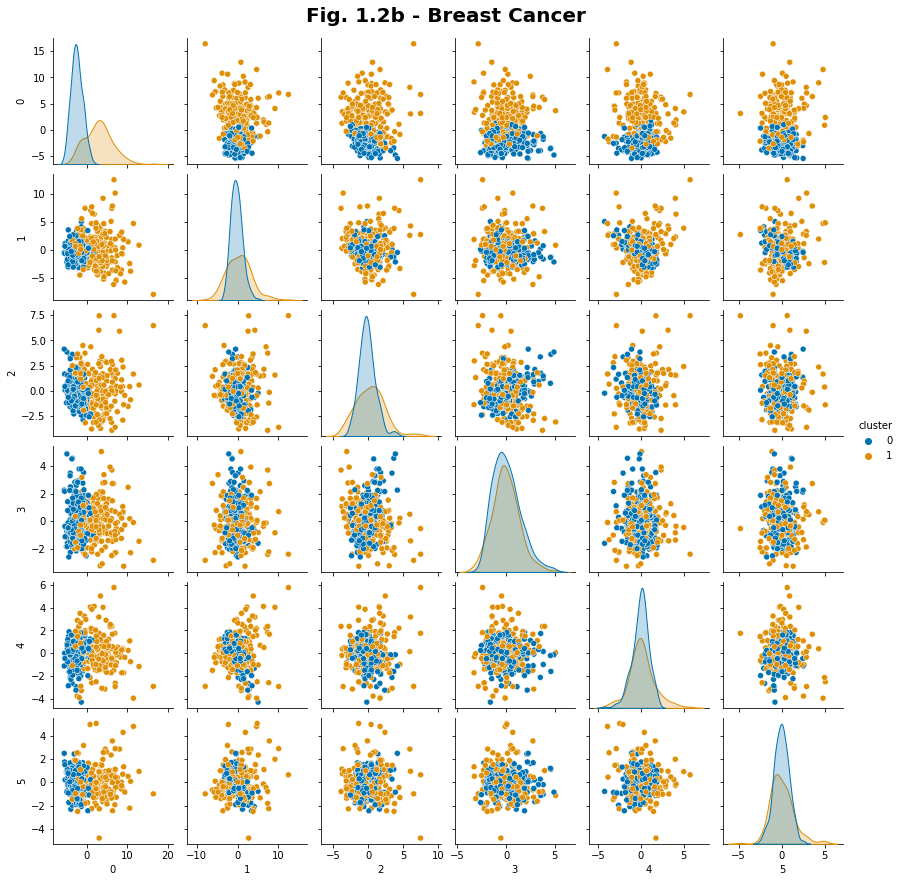

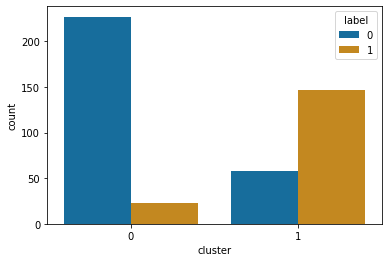

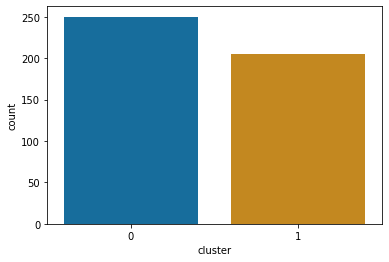

In [698]:
#Breast Cancer
n_clusters =2 
X_val = X_b_pca
gmm_b = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_b.fit(X_val)
cluster = gmm_b.predict(X_val)
df_b = pd.DataFrame(X_val)
df_b["cluster"] = cluster
g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))
g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, gmm_b)

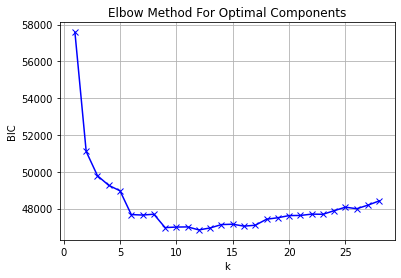

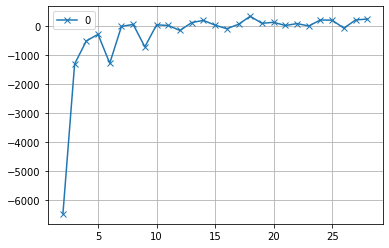

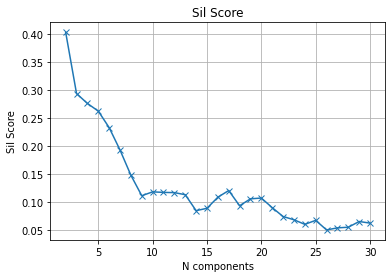

In [48]:
elbow_EM(X_w_pca)
sil_score_plot_EM(X_w_pca)

For n_clusters = 2 The average silhouette_score is : 0.40363613647456825
For n_clusters = 3 The average silhouette_score is : 0.2941173851495522
For n_clusters = 4 The average silhouette_score is : 0.27643211694988074
For n_clusters = 5 The average silhouette_score is : 0.262746973991827
For n_clusters = 6 The average silhouette_score is : 0.23325940533502132


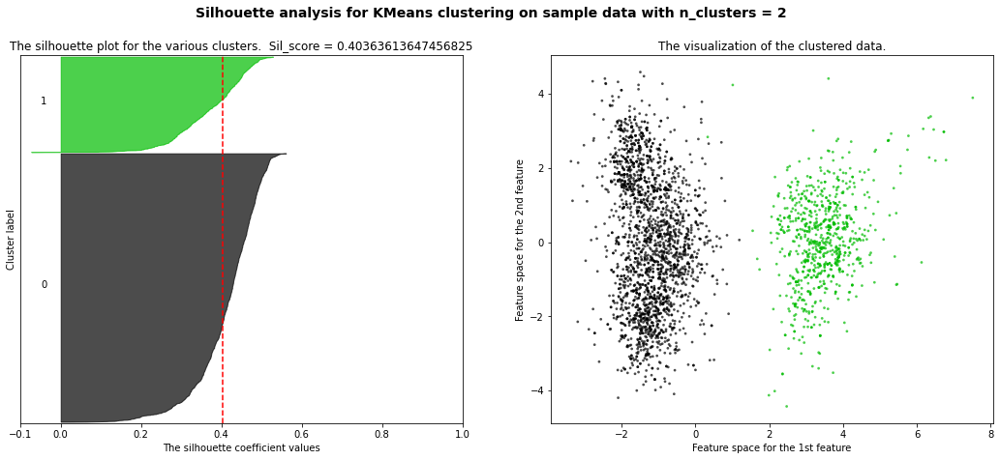

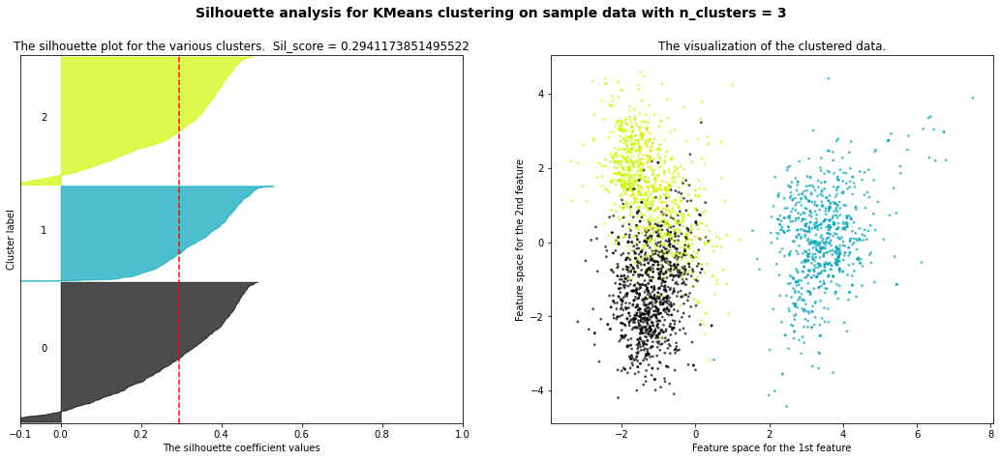

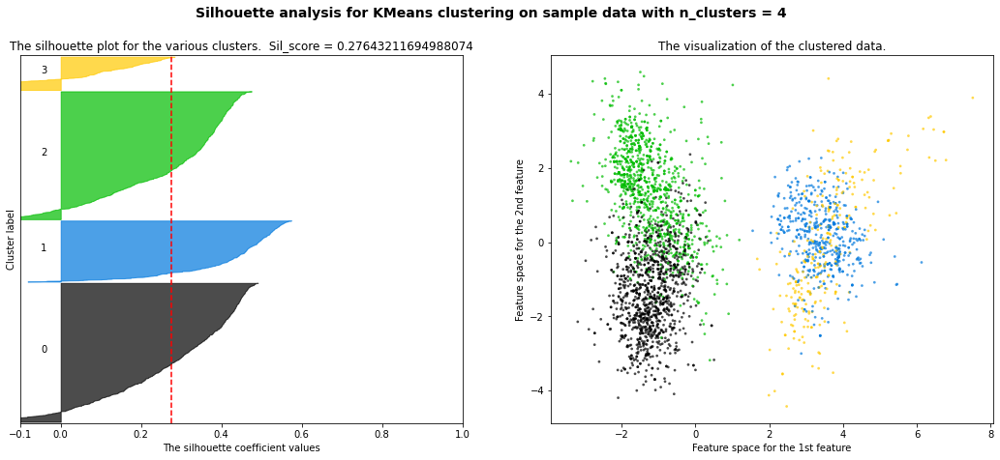

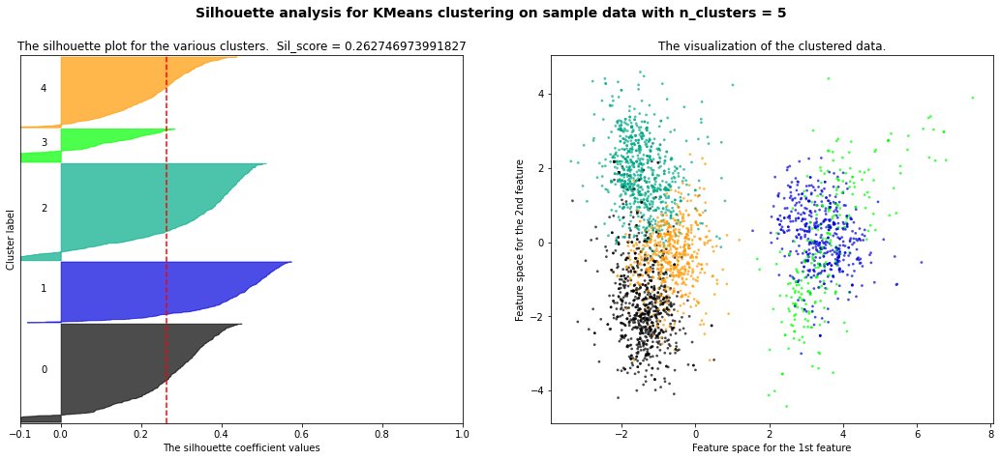

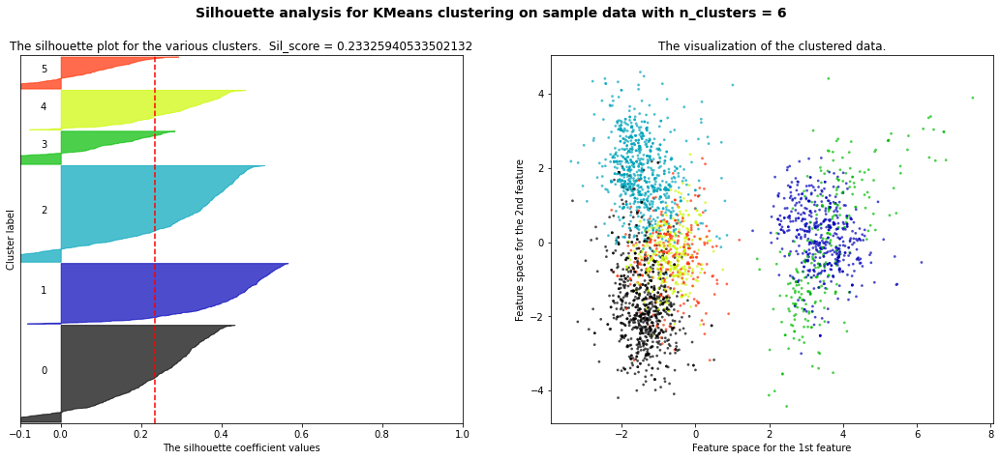

In [49]:
sil_score_EM(X_w_pca)

Accuracy of clustering: 0.9965846994535519


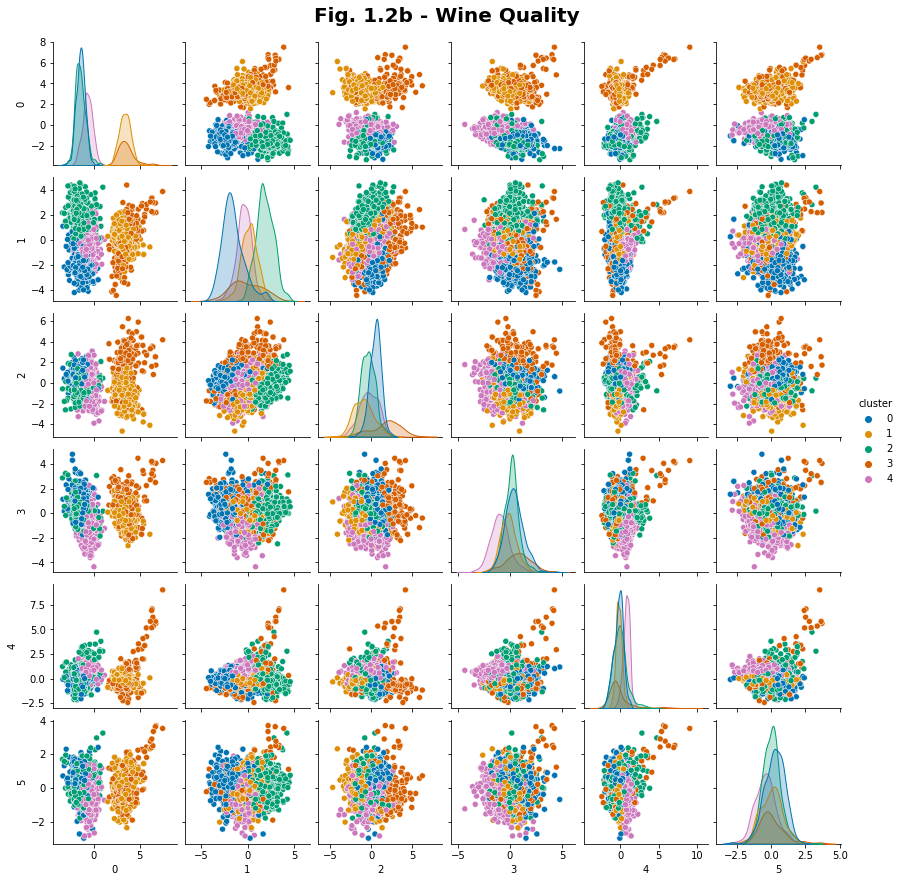

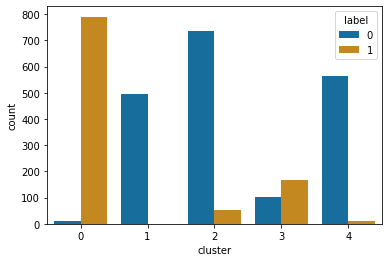

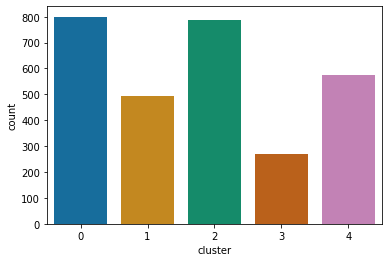

In [111]:
#Wine
n_clusters = 5
X_val = X_w_pca
gmm_w = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_w.fit(X_val)
cluster = gmm_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')
g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')

print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))
df_w["label"] = y_w.values
plt.show()
get_dist(X_val,y_w, gmm_w)

# ICA

In [45]:
from sklearn.decomposition import PCA, FastICA as ICA
def perform_ICA(X,y,title = "ICA", random_seed =2):
    
    num_dims = list(np.arange(2,(X.shape[1]-1)))
    num_dims.append(X.shape[1])
    kurtosis = []

    for dim in num_dims:
        ica = ICA(random_state=random_seed, n_components = dim)
        temp = ica.fit_transform(X)
        temp = pd.DataFrame(temp)
        temp = temp.kurtosis(axis=0)
        kurtosis.append(temp.abs().mean())
        #print(temp.abs())

    plt.figure()
    plt.title("Kurtosis: "+ title)
    plt.xlabel("IC")
    plt.ylabel("Avg Kurtosis")
    plt.plot(num_dims, kurtosis, 'x-')
    plt.grid()
    plt.show()

def ICA_barchart(X, components = 25, show = 10, criteria = 0, title = "Kurtosis per Component"):
    ica = ICA(random_state=random_seed, n_components = components)
    temp = ica.fit_transform(X)
    temp = pd.DataFrame(temp)
    kurtosis = temp.kurtosis(axis=0).abs()
    
    data = []
    for i, kurt in enumerate(kurtosis):
        data.append(["" +str(i), kurt])
    #print(data)
    
    df = pd.DataFrame(data, columns=["IC", "kurtosis"])
    df = df.sort_values(by="kurtosis", ascending = False)
    print(df)
    X = df["IC"][:show]
    y = df["kurtosis"][:show]
    avg_kurt = df["kurtosis"].mean()
    
    print("Avg Kurtosis : " + str(avg_kurt))
    
    if criteria:
        plt.axhline(y = criteria + 0.5, color = "black", label =  "Kurtosis = "+str(criteria)+" (cutoff line)")
    else:
        plt.axhline(y = avg_kurt, color = "black", label = "Avg Kurtosis (cutoff line)")
    plt.legend(loc = "center right")
    plt.xlabel("Independent Components")
    plt.ylabel("Kurtosis")
    plt.bar(X,y)
    plt.grid(True)
    plt.title(title, fontdict={'fontsize': 15, 'fontweight': 'heavy'})
    plt.show()
    
    

In [14]:
ica_pre = PCA()
X_b_ica_pre = ica_pre.fit_transform(X_b)

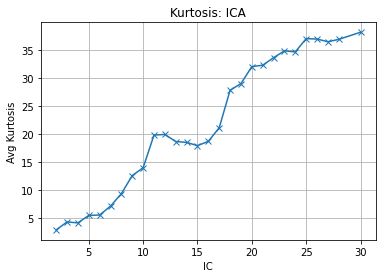

In [15]:
perform_ICA(X_b_ica_pre,y_b, random_seed = 1)

    IC    kurtosis
16  16  304.069780
7    7  246.110781
23  23   76.984985
12  12   75.342904
8    8   40.737518
9    9   37.903844
6    6   29.119792
15  15   28.028820
24  24   21.972351
10  10   20.463405
2    2   17.582282
3    3    7.951538
17  17    7.334462
14  14    6.314495
22  22    6.060123
19  19    5.887992
11  11    5.284617
4    4    5.044538
21  21    4.921774
20  20    4.533871
1    1    3.973301
13  13    2.460674
25  25    1.961065
5    5    1.688490
18  18    1.530987
0    0    0.501699
Avg Kurtosis : 37.06792639519867


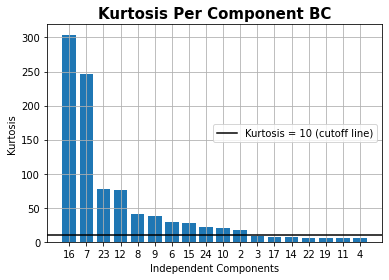

In [46]:
ICA_barchart(X_b, 26, 18, criteria=10,title = "Kurtosis Per Component BC")

In [47]:
selected_IC_b = [16, 7, 23, 12, 8, 9, 6,15,24,10,2]

/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:118: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


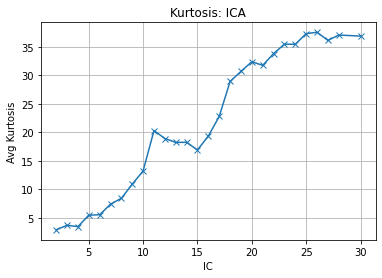

In [83]:
perform_ICA(X_b,y_b, random_seed = 7)

In [48]:
ica = ICA(random_state=7, n_components = 26)
X_b_ICA = ica.fit_transform(X_b)
df_b_ICA = pd.DataFrame(X_b_ICA)
print((df_b_ICA.kurtosis(axis=0)).abs().mean())

#selected_IC_b = [16, 7, 23, 12, 8, 9]
X_b_ICA_original = X_b_ICA
X_b_ICA = df_b_ICA[selected_IC_b].values

#df_b_ICA_trans.hist()

37.53200469298644


numpy.ndarray

In [85]:
df_original = pd.DataFrame(X_b)
print((df_original.kurtosis(axis=0)).abs().mean())

7.223926362586086


Reconstruction Error (1) MSE: 0.5474556940487584
Reconstruction Error (2) MSE: 0.361888198911803
Reconstruction Error (3) MSE: 0.2716205391735403
Reconstruction Error (4) MSE: 0.20598120438866474
Reconstruction Error (5) MSE: 0.1533330977138311
Reconstruction Error (6) MSE: 0.1111259378345029
Reconstruction Error (7) MSE: 0.08903479156091929
Reconstruction Error (8) MSE: 0.07213405387250264
Reconstruction Error (9) MSE: 0.057908162657130426
Reconstruction Error (10) MSE: 0.046494928264378815
Reconstruction Error (11) MSE: 0.036941578645275135
Reconstruction Error (12) MSE: 0.02852952059989238
Reconstruction Error (13) MSE: 0.02116772724230815
Reconstruction Error (14) MSE: 0.016002408917976642
Reconstruction Error (15) MSE: 0.012953763130805476


/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:118: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


Reconstruction Error (16) MSE: 0.010247660921889728
Reconstruction Error (17) MSE: 0.008290153019832698
Reconstruction Error (18) MSE: 0.006493660006075111
Reconstruction Error (19) MSE: 0.00511811535953851
Reconstruction Error (20) MSE: 0.004069666471701167
Reconstruction Error (21) MSE: 0.003116726248134727
Reconstruction Error (22) MSE: 0.002284417469226306
Reconstruction Error (23) MSE: 0.0015892721905092211
Reconstruction Error (24) MSE: 0.001031878510303054
Reconstruction Error (25) MSE: 0.0005681450361629786
Reconstruction Error (26) MSE: 0.00029667865593231794


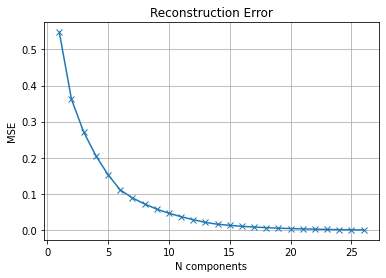

In [119]:
reconstruction_error_plot(X_b, ica, 26)

/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-leve

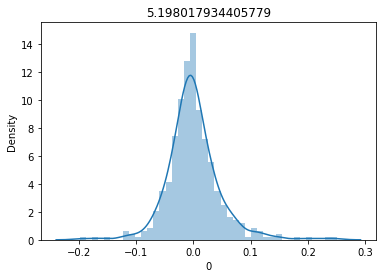

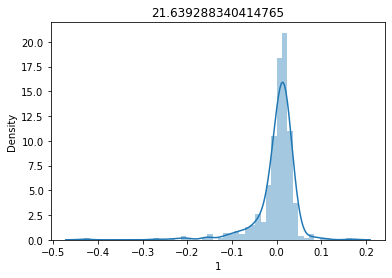

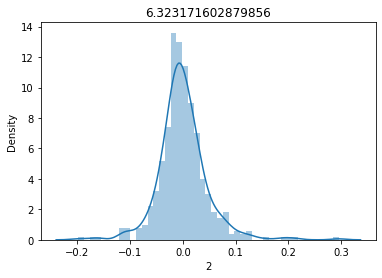

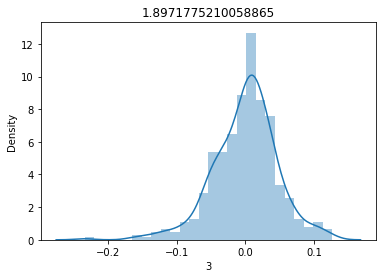

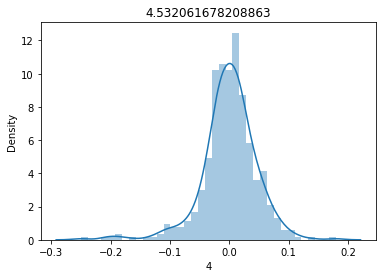

...

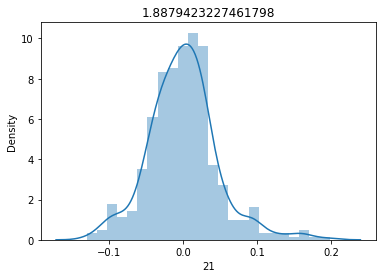

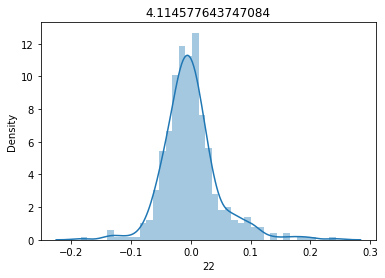

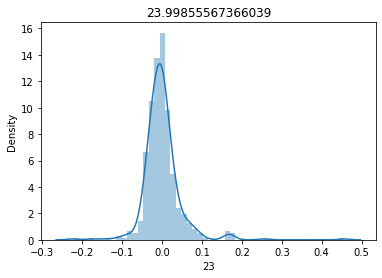

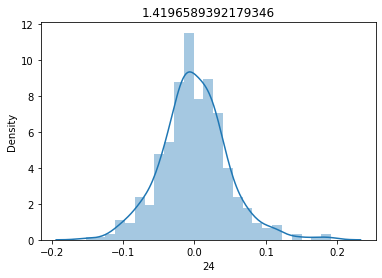

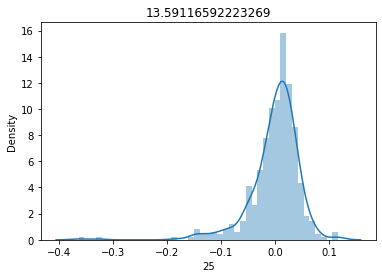

In [219]:
kurtosis = df_b_ICA.kurtosis(axis=0)
for i, col in enumerate(df_b_ICA.columns):
    plt.figure(i)
    sns.distplot(df_b_ICA[col]).set_title(kurtosis[i])

This means, the components are mostly independent.
Also looking at Kurtosis, many of the independent components are normally distributed.
Hence ICA is not very effective, since it assumes non-gaussian distributions of independent components

/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:118: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


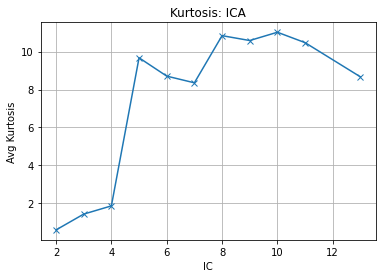

In [79]:
perform_ICA(X_w,y_w, random_seed = )

/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:118: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


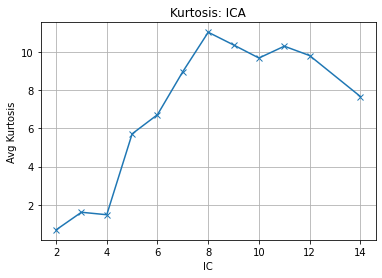

In [67]:
perform_ICA(X_w,y_w)

    IC   kurtosis
3  IC3  70.666459
1  IC1   6.477263
0  IC0   3.037950
7  IC7   2.388930
2  IC2   1.030779
5  IC5   0.633223
4  IC4   0.548619
6  IC6   0.423223


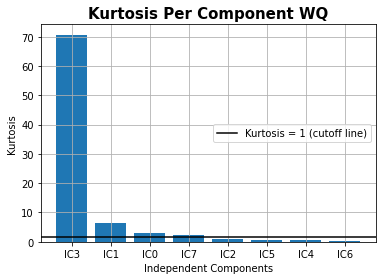

In [426]:
ICA_barchart(X_w, 8, criteria = True, title = "Kurtosis Per Component WQ")

In [303]:
ica = ICA(random_state=2, n_components = 8)
selected_IC_w = [3,1,0,7]
X_w_ICA = ica.fit_transform(X_w)
df_w_ICA = pd.DataFrame(X_w_ICA)
X_w_ICA_original = X_w_ICA
X_w_ICA = df_w_ICA[selected_IC_w].values


/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/bhkash/miniconda3/envs/Asst3/lib/python3.9/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-leve

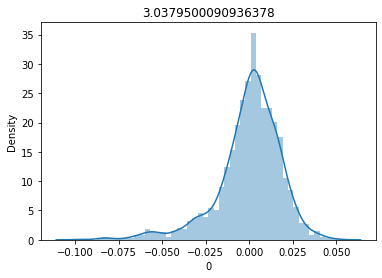

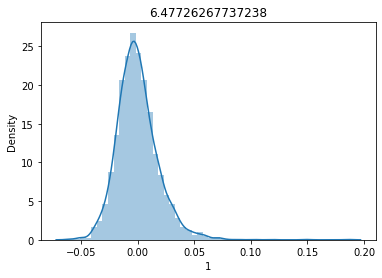

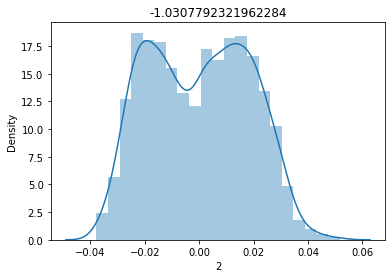

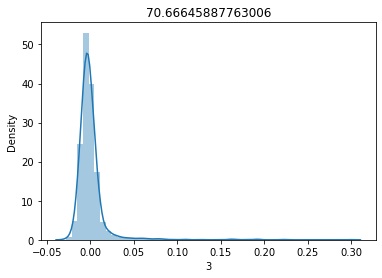

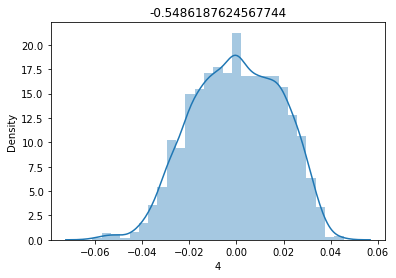

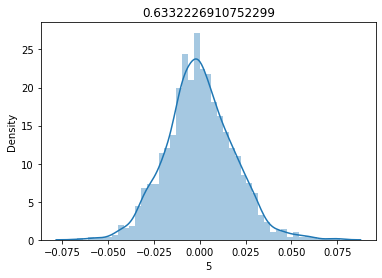

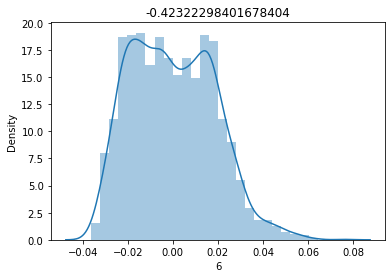

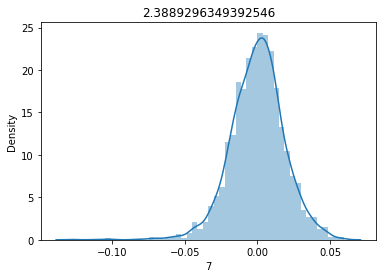

In [305]:
ica = ICA(random_state=2, n_components = 8)
X_w_ICA = ica.fit_transform(X_w)
df_w_ICA = pd.DataFrame(X_w_ICA)

kurtosis = df_w_ICA.kurtosis(axis=0)
for i, col in enumerate(df_w_ICA.columns):
    plt.figure(i)
    sns.distplot(df_w_ICA[col]).set_title(kurtosis[i])

X_w_ICA_original = X_w_ICA
X_w_ICA = df_w_ICA[selected_IC_w].values


In [306]:
X_w_ICA.shape

(2928, 4)

# ICA + Clustering

## Kmeans

### Breast Cancer

Using Kneed
9


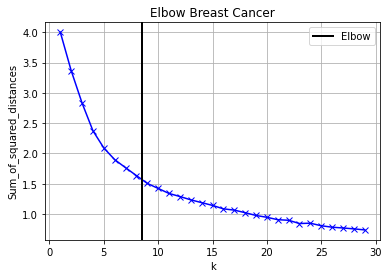

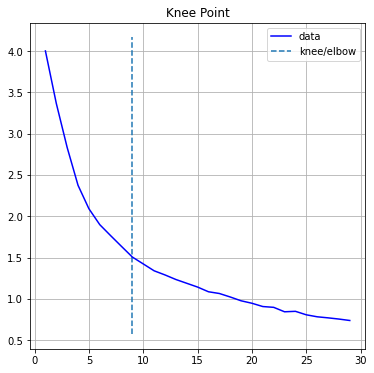

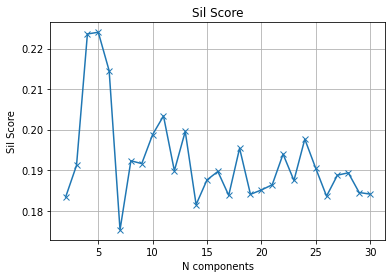

In [312]:
elbow(X_b_ICA, K = 30, title ="Elbow Breast Cancer")
sil_score_plot(X_b_ICA)

Using Kneed
11


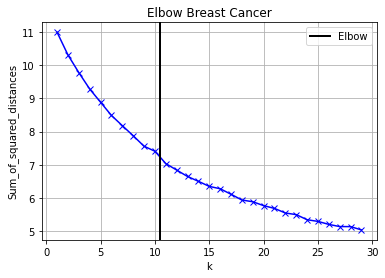

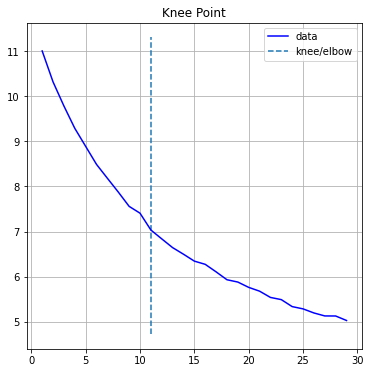

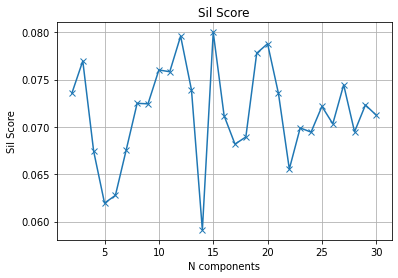

In [49]:
elbow(X_b_ICA, K = 30, title ="Elbow Breast Cancer")
sil_score_plot(X_b_ICA)

For n_clusters = 2 The average silhouette_score is : 0.18337484356490677
For n_clusters = 3 The average silhouette_score is : 0.19118631626934987
For n_clusters = 4 The average silhouette_score is : 0.22358597264922905
For n_clusters = 5 The average silhouette_score is : 0.22401298346492085
For n_clusters = 6 The average silhouette_score is : 0.21452172586623985


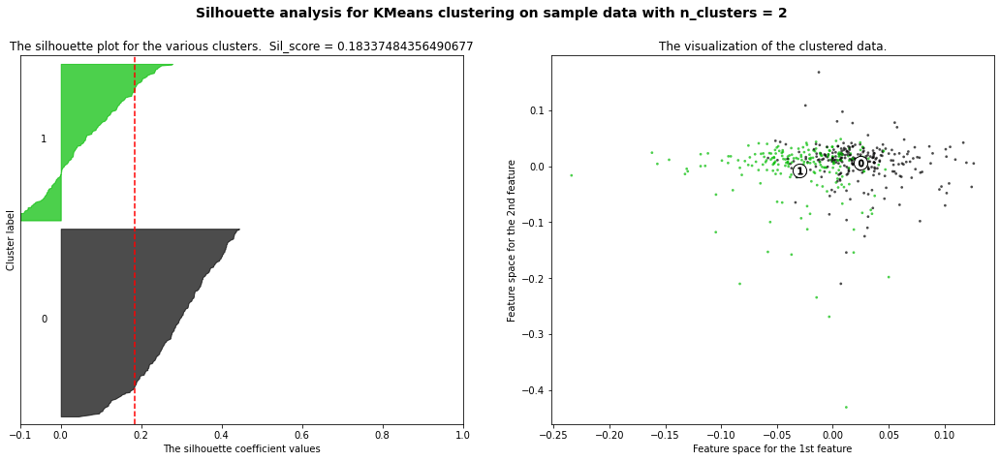

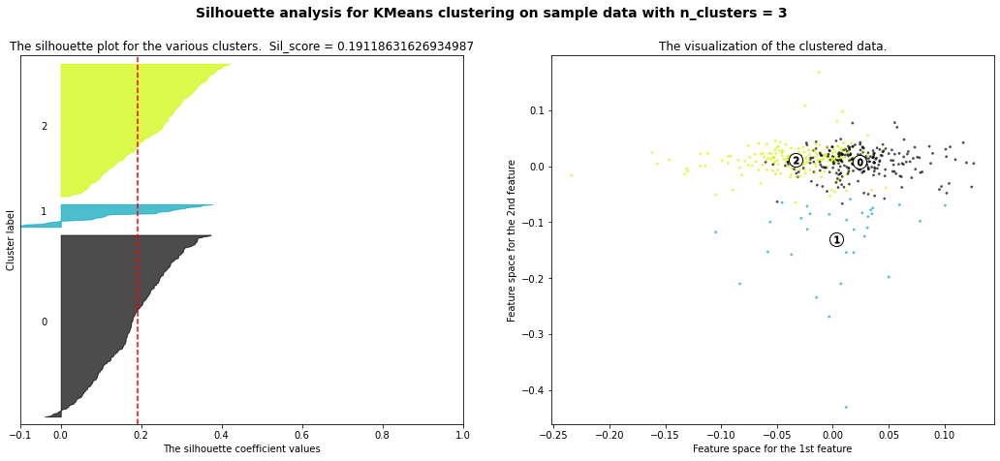

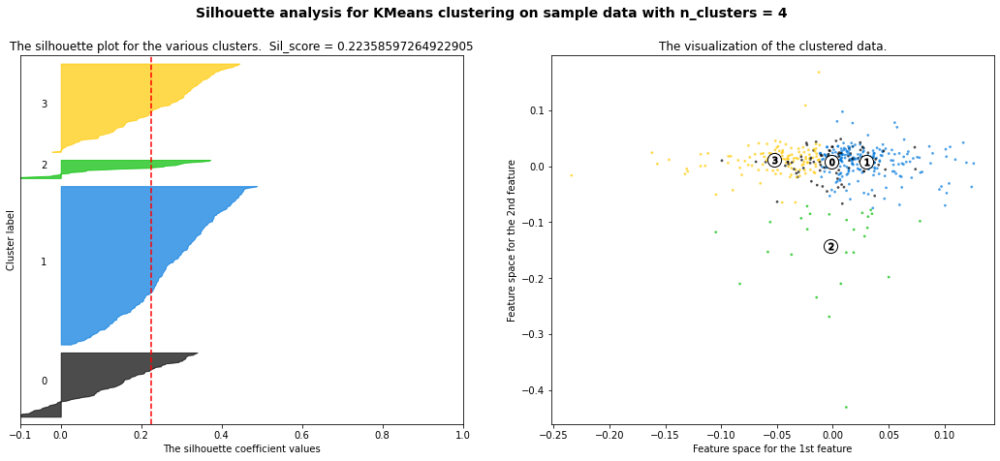

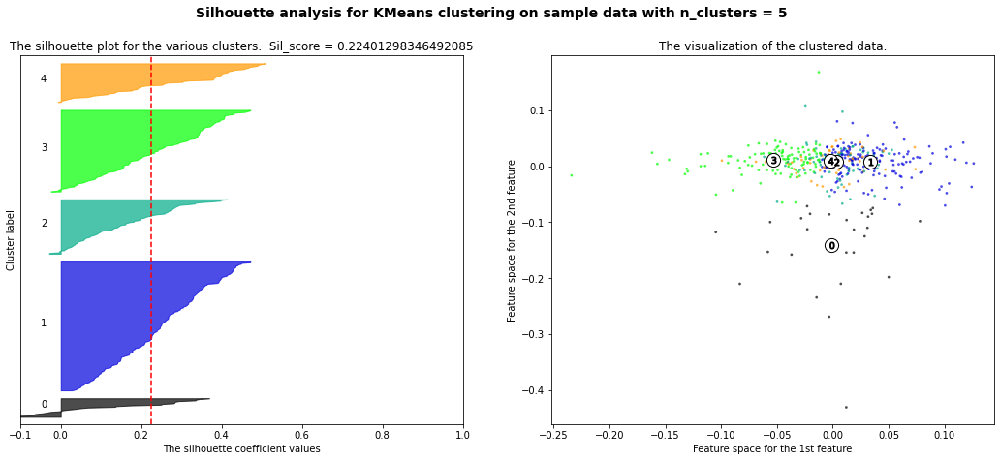

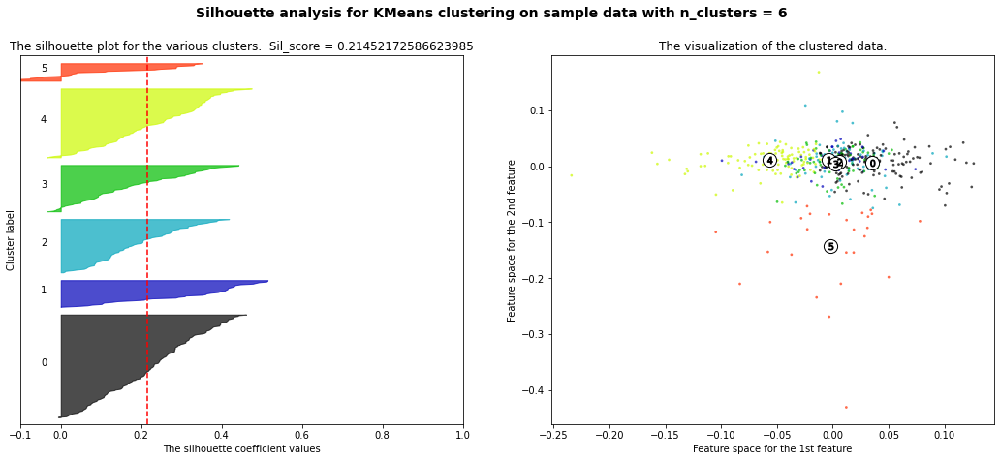

In [315]:
sil_score_kmeans_2(X_b_ICA)

Accuracy of clustering: 0.07032967032967033


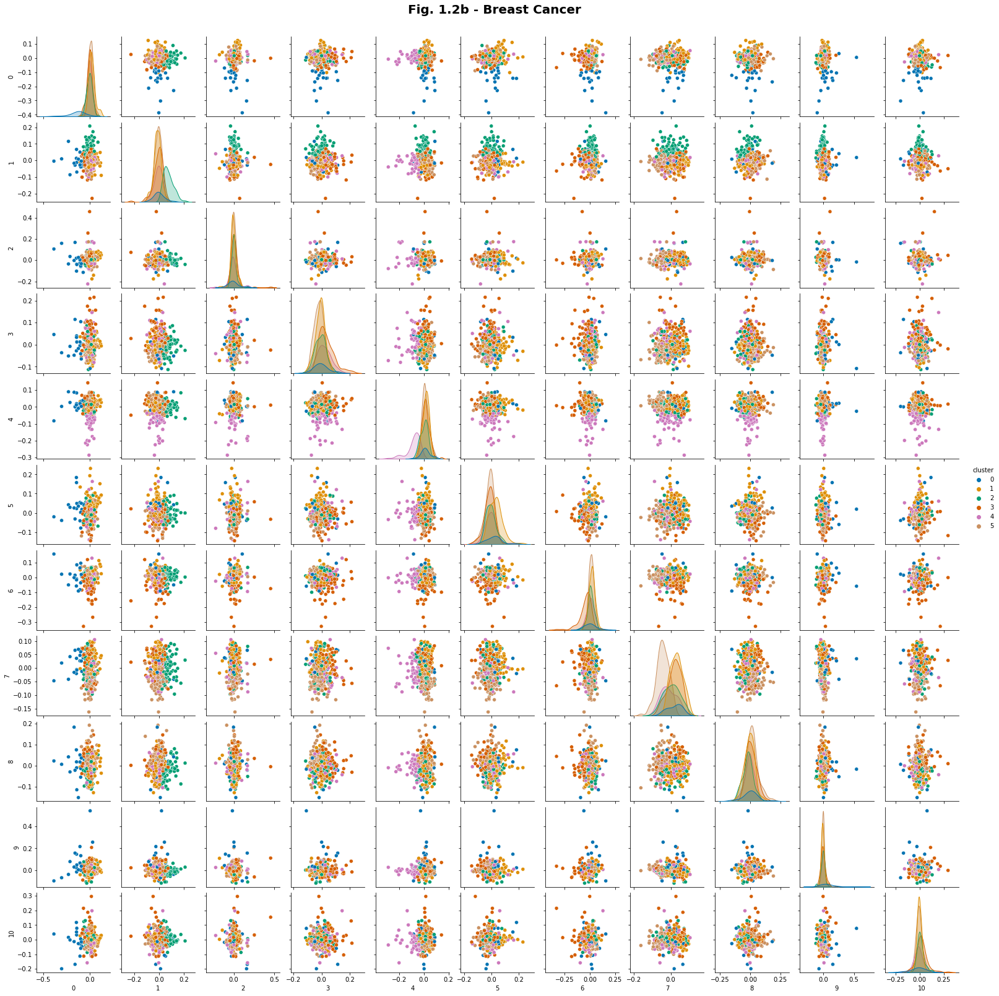

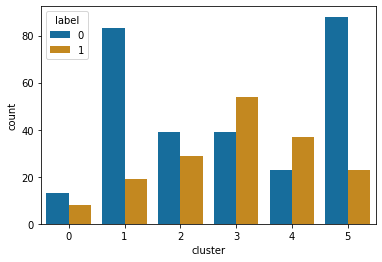

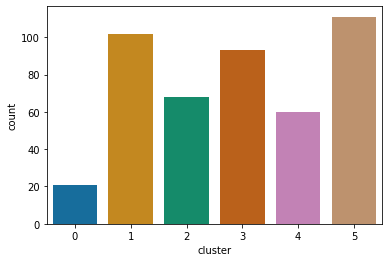

In [54]:
n_clusters = 6
X_val = X_b_ICA
km_b = KMeans(n_clusters=n_clusters, random_state = 2)
km_b = km_b.fit(X_val)
cluster = km_b.predict(X_val)
df_b = pd.DataFrame(X_val)
df_b["cluster"] = cluster
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, km_b)

Accuracy of clustering: 0.11428571428571428


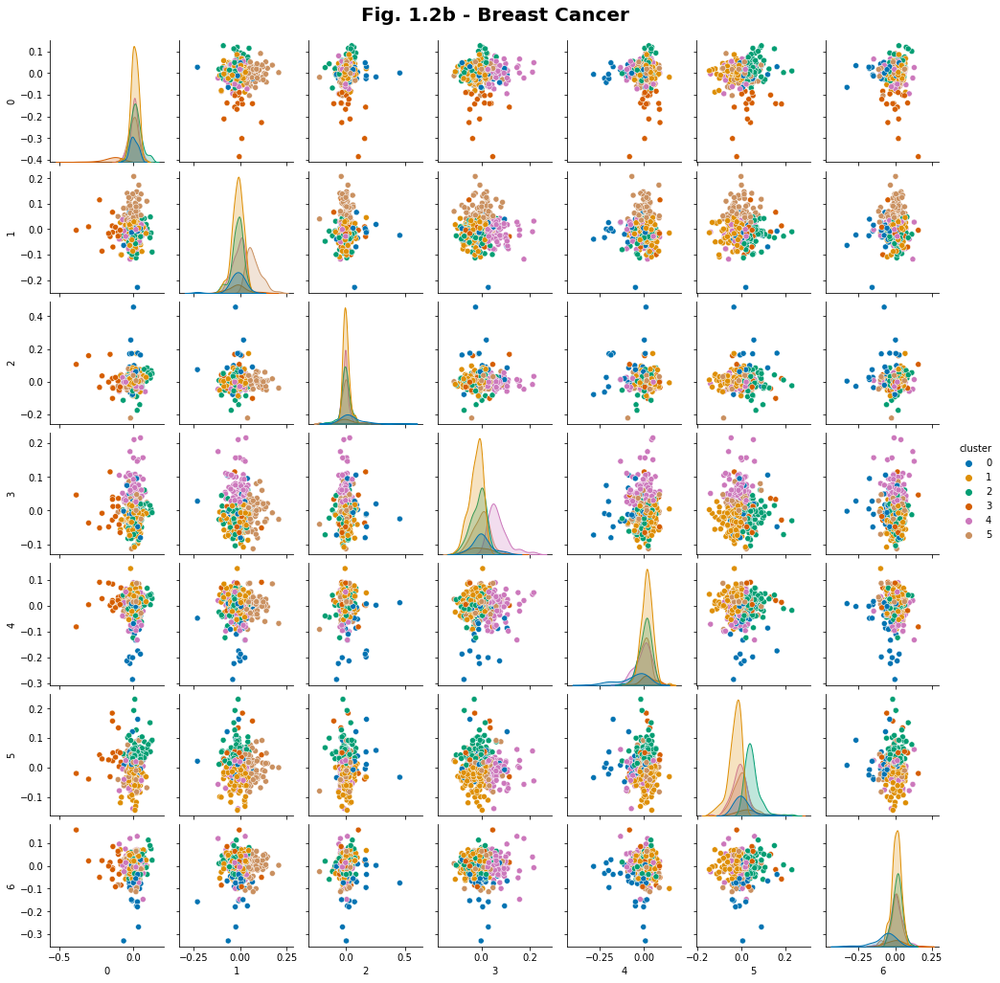

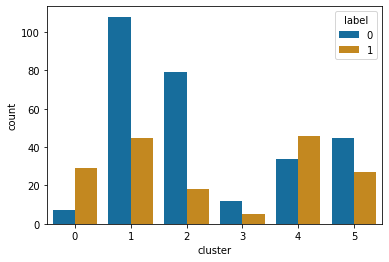

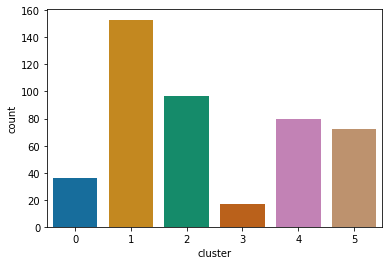

In [697]:
n_clusters = 6
X_val = X_b_ICA
km_b = KMeans(n_clusters=n_clusters, random_state = 2)
km_b = km_b.fit(X_val)
cluster = km_b.predict(X_val)
df_b = pd.DataFrame(X_val)
df_b["cluster"] = cluster
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, km_b)

Using Kneed
8


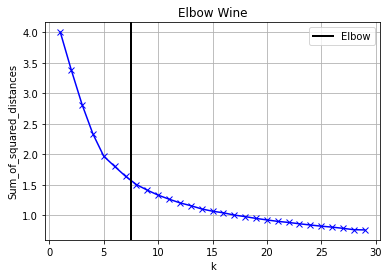

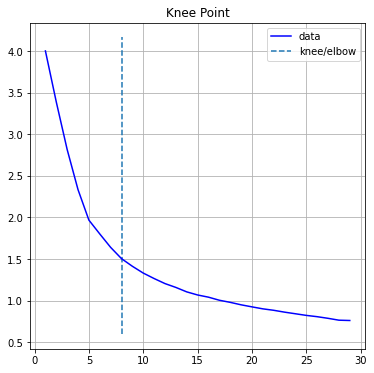

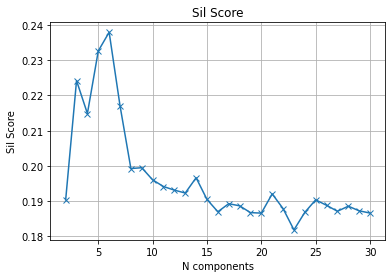

In [307]:
elbow(X_w_ICA, K=30, title ="Elbow Wine")
sil_score_plot(X_w_ICA)

For n_clusters = 2 The average silhouette_score is : 0.19035129351323293
For n_clusters = 3 The average silhouette_score is : 0.22421537871174524
For n_clusters = 4 The average silhouette_score is : 0.21486774287033578
For n_clusters = 5 The average silhouette_score is : 0.23264884553276674
For n_clusters = 6 The average silhouette_score is : 0.23796109808595936


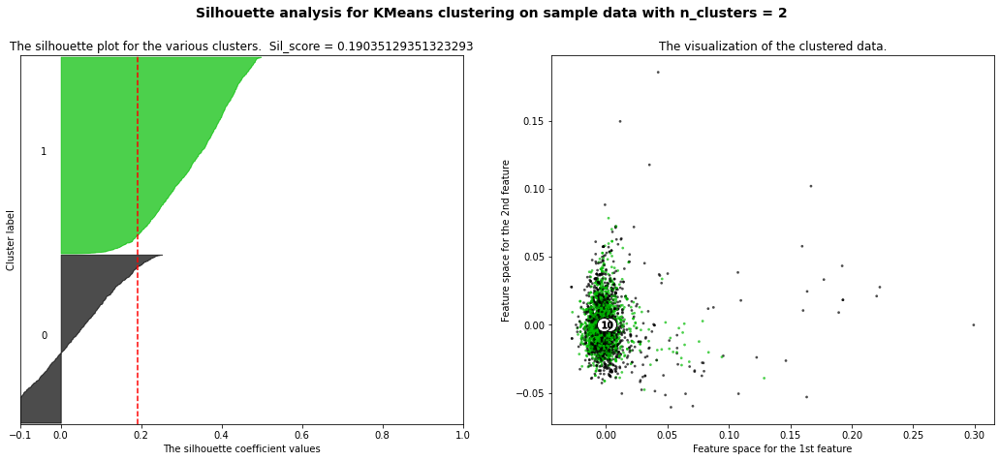

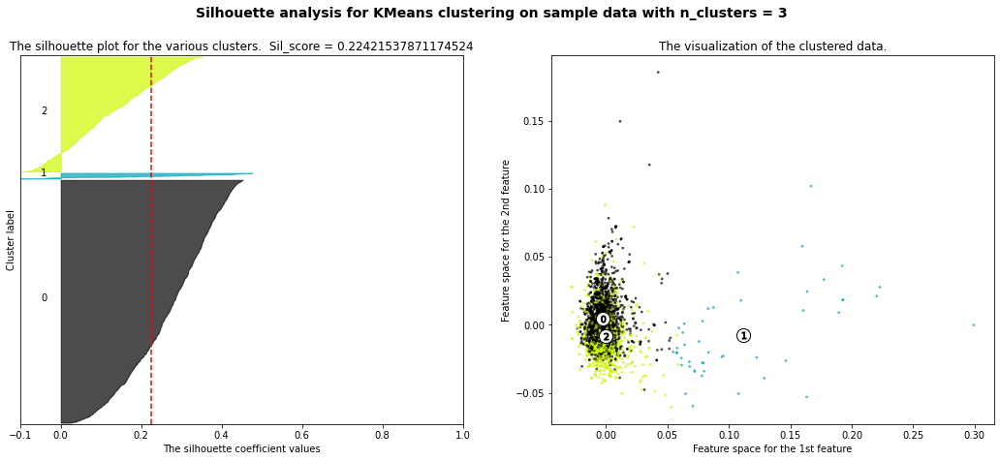

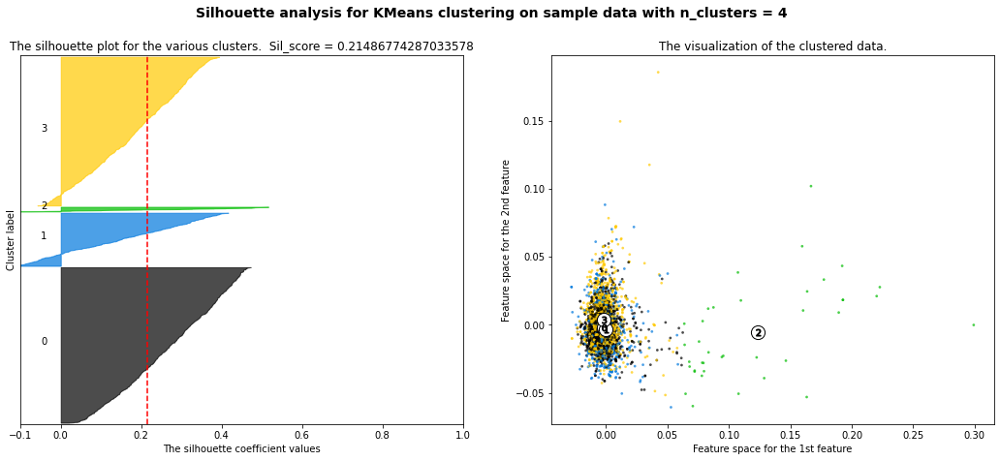

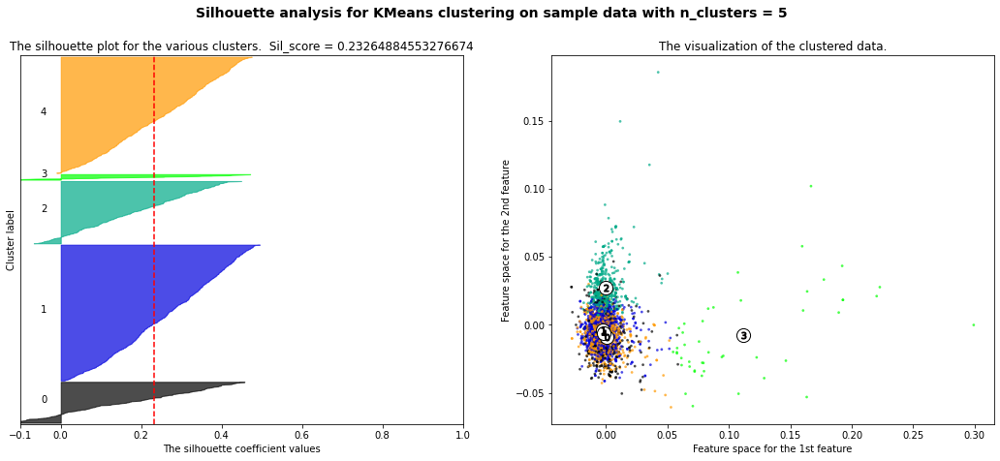

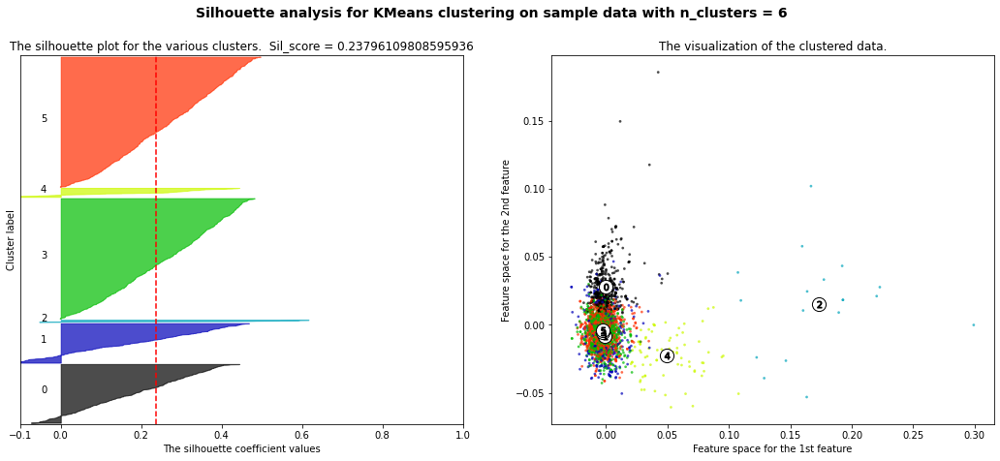

In [308]:
sil_score_kmeans_2(X_w_ICA)

In [16]:
from sklearn.mixture import GaussianMixture
bic = []
n_components_range = range(2, 30)
for i in n_components_range:
    
    gmm = GaussianMixture(n_components = i, random_state = 1)
    gmm.fit(X_w)
    bic.append(gmm.bic(X_w))
    print("Num of components: " + str(i) + " bic: " + str(bic[-1]))

Num of components: 2 bic: 4637.667628992154
Num of components: 3 bic: -10794.682085896075
Num of components: 4 bic: -985.7292283608404
Num of components: 5 bic: -8253.100040097355
Num of components: 6 bic: -15673.94894122989
Num of components: 7 bic: -26934.535840649765
Num of components: 8 bic: -19295.321823289607
Num of components: 9 bic: -26721.112104497275
Num of components: 10 bic: -25732.884972888365
Num of components: 11 bic: -27193.240382141063
Num of components: 12 bic: -28276.946905846286
Num of components: 13 bic: -26052.806141478468
Num of components: 14 bic: -27293.7364041919
Num of components: 15 bic: -24578.3684601004
Num of components: 16 bic: -28484.504902388988
Num of components: 17 bic: -24075.70433209801
Num of components: 18 bic: -24164.449782536507
Num of components: 19 bic: -22632.075997333024
Num of components: 20 bic: -25446.353960290675
Num of components: 21 bic: -24178.35066959041
Num of components: 22 bic: -23844.52195506825
Num of components: 23 bic: -23040

Accuracy of clustering: 0.1092896174863388


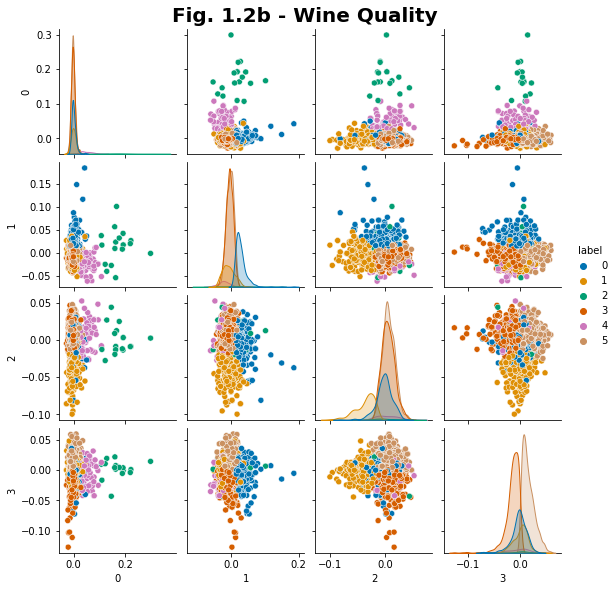

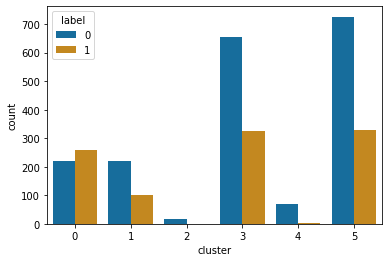

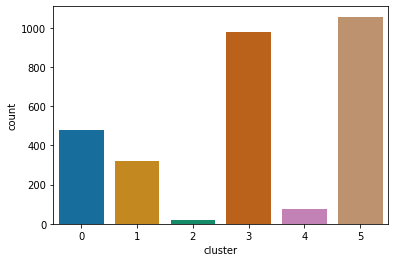

In [310]:
n_clusters = 6
X_val = X_w_ICA
km_w = KMeans(n_clusters=n_clusters, random_state = random_seed)
km_w = km_w.fit(X_val)
label = km_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["label"] = label
print("Accuracy of clustering: " + str(accuracy_score(y_w, label)))

g =sns.pairplot(df_w, hue="label", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_w, km_w)

### EM

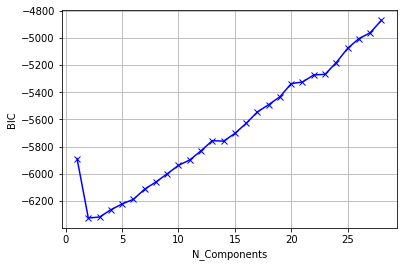

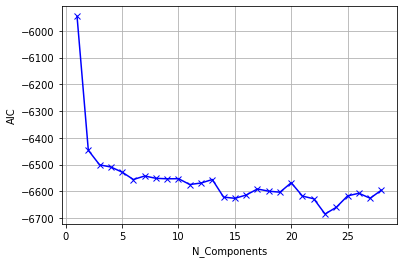

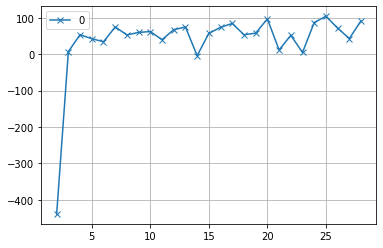

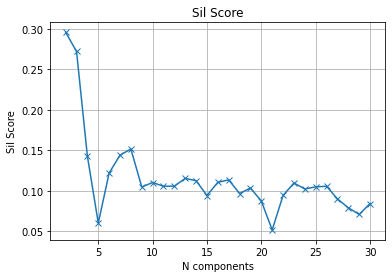

In [311]:
elbow_EM(X_b_ICA)
sil_score_plot_EM(X_b_ICA)

Accuracy of clustering: 0.10329670329670329


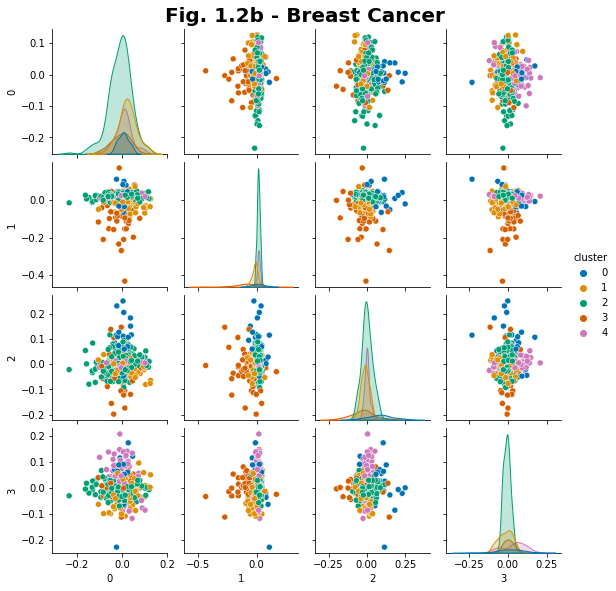

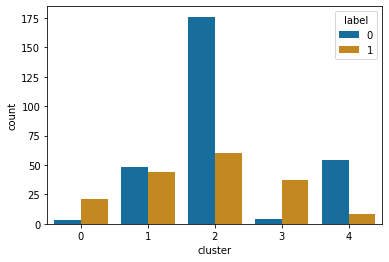

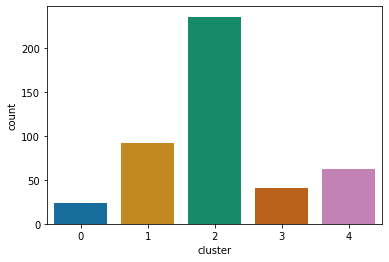

In [316]:
#Breast Cancer
n_clusters = 5 
X_val = X_b_ICA
gmm_b = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_b.fit(X_val)
cluster = gmm_b.predict(X_val)
df_b = pd.DataFrame(X_val)
df_b["cluster"] = cluster
g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))
g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, gmm_b)

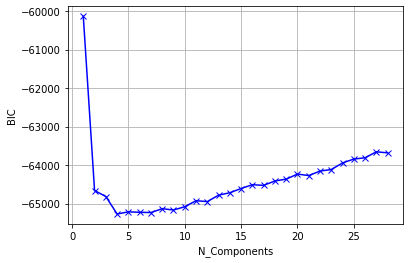

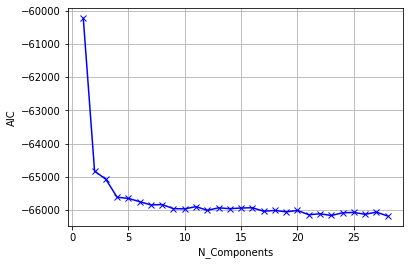

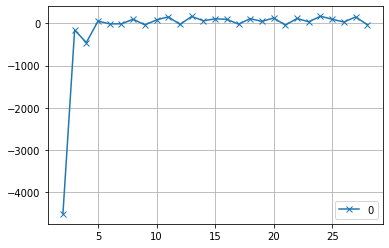

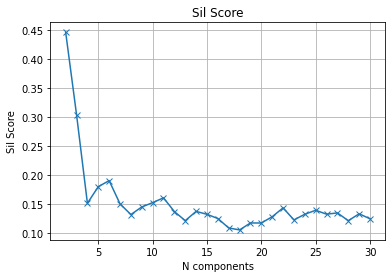

In [319]:
elbow_EM(X_w_ICA)
sil_score_plot_EM(X_w_ICA)

Accuracy of clustering: 0.5625


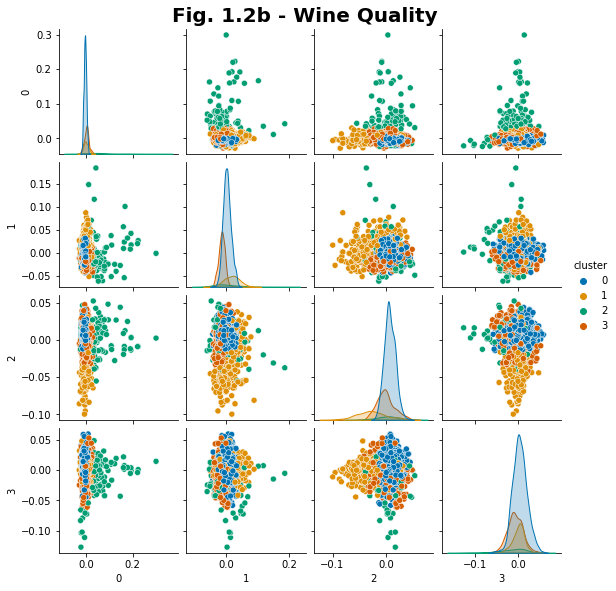

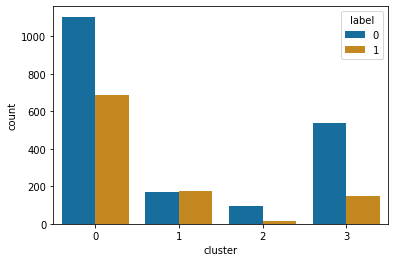

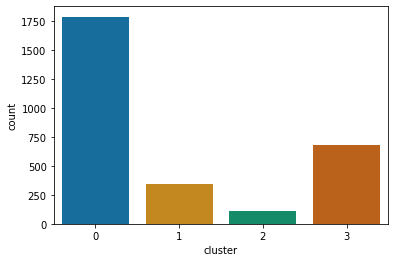

In [321]:
#Wine
n_clusters = 4
X_val = X_w_ICA
gmm_w = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_w.fit(X_val)
cluster = gmm_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')
g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')

print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))
df_w["label"] = y_w.values
plt.show()
get_dist(X_val,y_w, gmm_w)

# Random Projections

In [81]:
from scipy import sparse
from sklearn import decomposition
from sklearn import random_projection
from sklearn.metrics import mean_squared_error as MSE

def perform_RP(X,title = "RP", random_seed =2, return_result = False):
    
    num_dims = X.shape[1]
    error = []

    for dim in range(1,num_dims +1):
        rp = random_projection.GaussianRandomProjection(random_state=random_seed, n_components = dim)
        X_rp = rp.fit_transform(X)
        X_rp_inverse = np.linalg.pinv(rp.components_.T)
        reconstructed_X = X_rp.dot(X_rp_inverse)
        
        error.append(MSE(X, reconstructed_X))
        #print(MSE(X, reconstructed_X))
    
    if return_result:
        return pd.DataFrame(error, index = range(1,num_dims +1))
    
    plt.figure()
    plt.title("Reconstruction Error: "+ title)
    plt.xlabel("IC")
    plt.ylabel("Reconstruction Error")
    plt.plot(range(1,num_dims +1), error, 'x-')
    plt.grid()
    plt.show()
    

def perform_multiple_RP(X, title = "Multiple RP", random_seed = 2, vertical_line = 25):
    num_dims = X.shape[1]
    df = pd.DataFrame(index = range(1,num_dims +1))
    
    for i in range(8):
        df["Attempt_" + str(i)] = perform_RP(X,random_seed = i, return_result = True)
    
    df.plot(style='x-')
    plt.title(title)
    plt.axhline(y = 0.2 ,linewidth=2, color='black', label = "RE Cutoff Line")
    plt.axvline(x = vertical_line ,linewidth=2, color='blue', label = "Selected N Value")
    plt.legend(loc = "lower left")
    plt.grid(True)
    plt.xlabel("Number of Components")
    plt.ylabel("Reconstruction Error")
    plt.show()
    
    
def perform_RP_2(X,title = "RP", random_seed =2):
    
    num_dims = X.shape[1]
    error = []

    for dim in range(1,num_dims +1):
        rca_b = InvertibleRandomProjection(random_state=random_seed, n_components = dim)

        X_rp = rca_b.fit_transform(X)
        X_rp_inverse = rca_b.inverse_transform(X_rp)
        #print(X_rp_inverse.shape)
        mse = MSE(X, X_rp_inverse)
        error.append(MSE(X, X_rp_inverse))

    plt.figure()
    plt.title("Reconstruction Error: "+ title)
    plt.xlabel("IC")
    plt.ylabel("Reconstruction Error")
    plt.plot(range(1,num_dims +1), error, 'x-')
    plt.grid()
    plt.show()

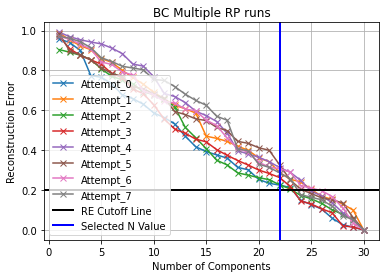

In [82]:
perform_multiple_RP(X_b, title = "BC Multiple RP runs", vertical_line = 22)

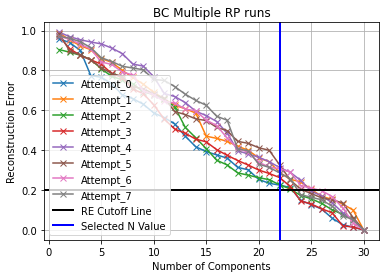

In [271]:
perform_multiple_RP(X_b, title = "BC Multiple RP runs", vertical_line = 22)

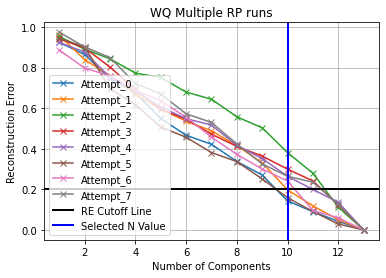

In [274]:
perform_multiple_RP(X_w, title = "WQ Multiple RP runs", vertical_line = 10)

0.9042673749063803
0.891258587467673
0.8764290574366644
0.8538659773507289
0.8086840391583884
0.7696042327060445
0.7533816980441673
0.7328019329064576
0.6926743166837015
0.678985829430521
0.6565850857010439
0.6166069907317392
0.5143844722809063
0.4621996386596558
0.40751628918102395
0.34939103594891974
0.32578166480389475
0.2859762756860447
0.2746937765972878
0.2618904796288258
0.2521622649430411
0.22582036564820476
0.2059923091417397
0.17244263058395287
0.15622397303541505
0.1328237229291499
0.10081539159598683
0.07862093836043452
0.053456905515019006
2.4157323394856087e-29


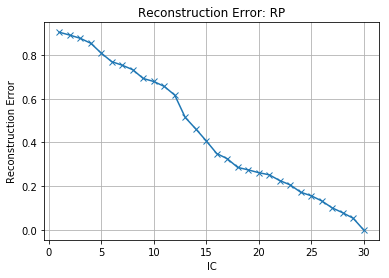

In [84]:
perform_RP(X_b,random_seed =2)

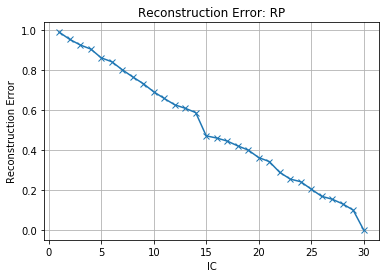

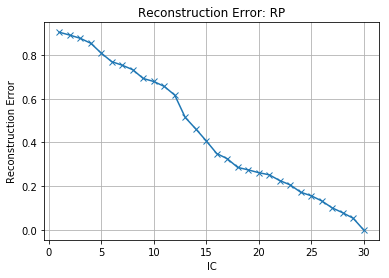

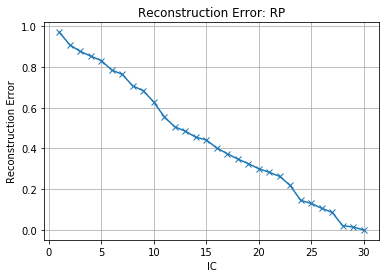

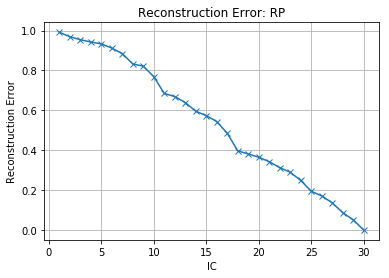

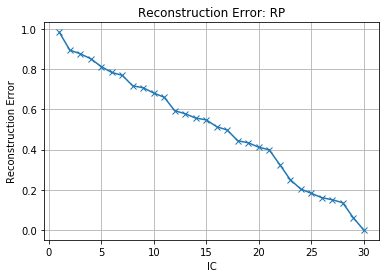

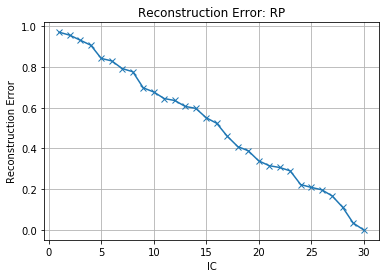

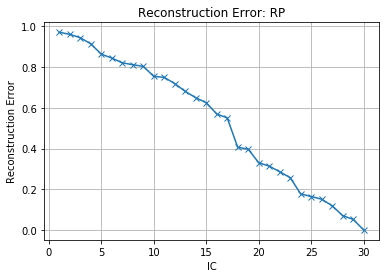

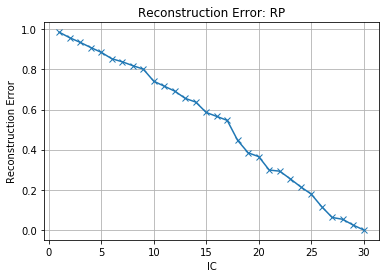

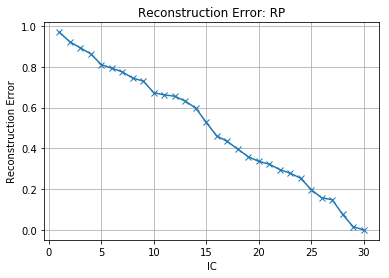

In [62]:
for i in range(1,10):
    perform_RP(X_b,random_seed =i)

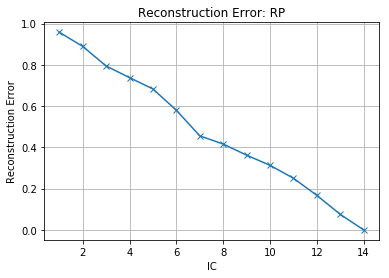

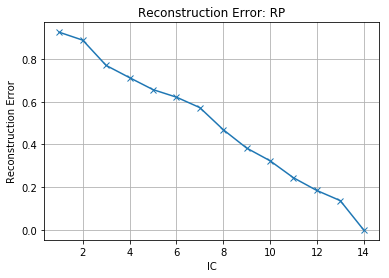

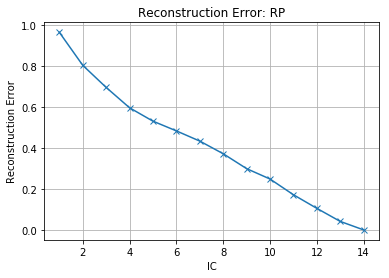

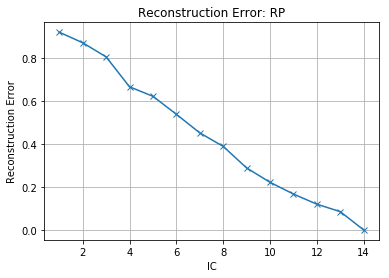

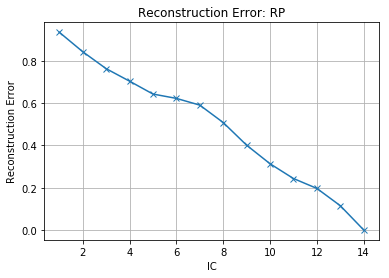

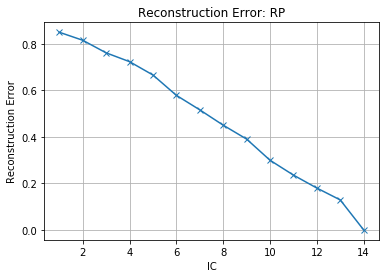

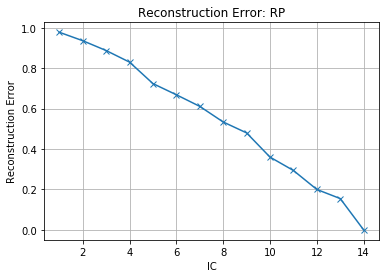

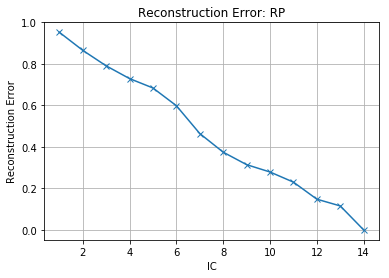

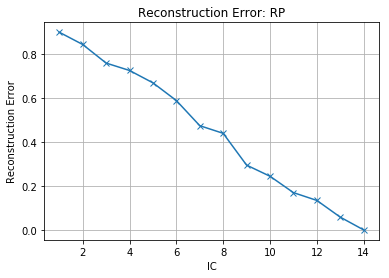

In [61]:
for i in range(1,10):
    perform_RP(X_w,random_seed =i)

In [36]:
rp_b = random_projection.GaussianRandomProjection(random_state=2, n_components = 22)
X_b_rp = rp_b.fit_transform(X_b)

rp_w = random_projection.GaussianRandomProjection(random_state=2, n_components = 10)
X_w_rp = rp_w.fit_transform(X_w)

# RP + Kmeans

Using Kneed
6


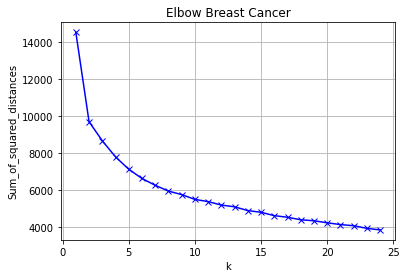

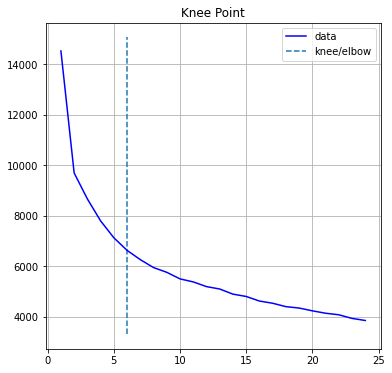

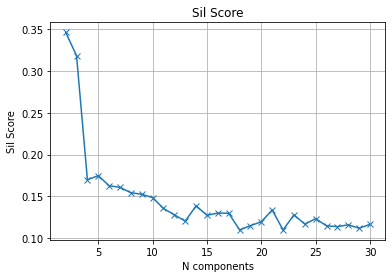

In [26]:
elbow(X_b_rp, K = 25, title ="Elbow Breast Cancer")
sil_score_plot(X_b_rp)

For n_clusters = 2 The average silhouette_score is : 0.3463852909350149
For n_clusters = 3 The average silhouette_score is : 0.318267351981107
For n_clusters = 4 The average silhouette_score is : 0.16986908800635295
For n_clusters = 5 The average silhouette_score is : 0.17466525950557538
For n_clusters = 6 The average silhouette_score is : 0.16262962272383824


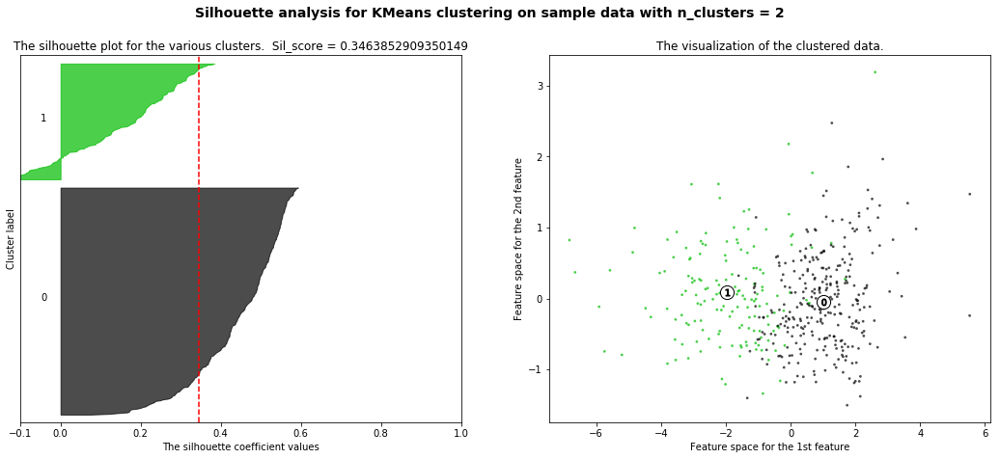

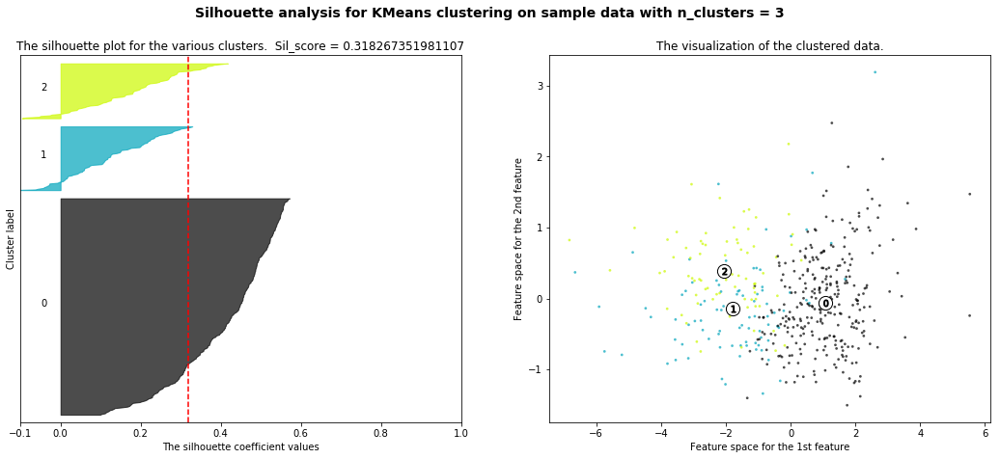

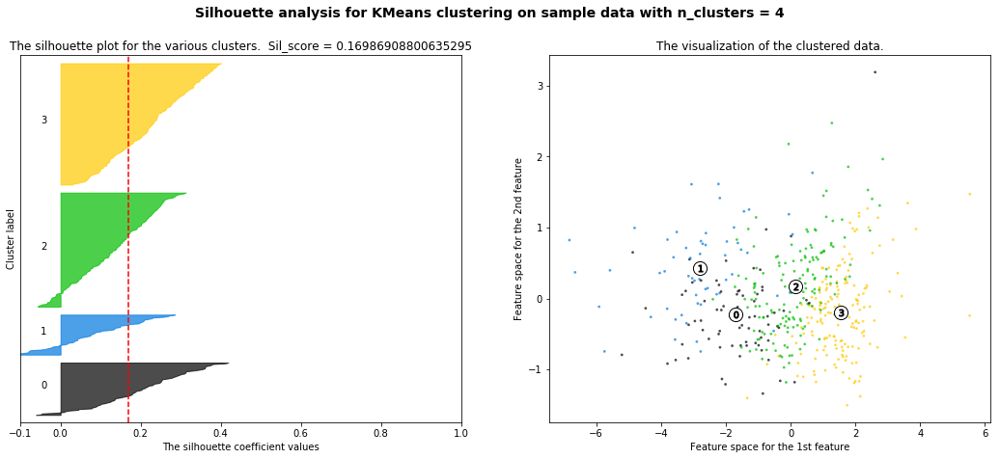

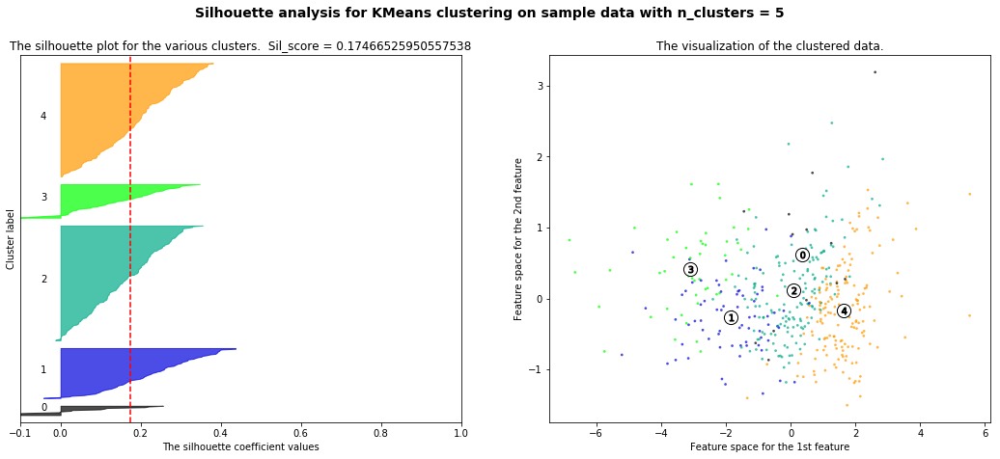

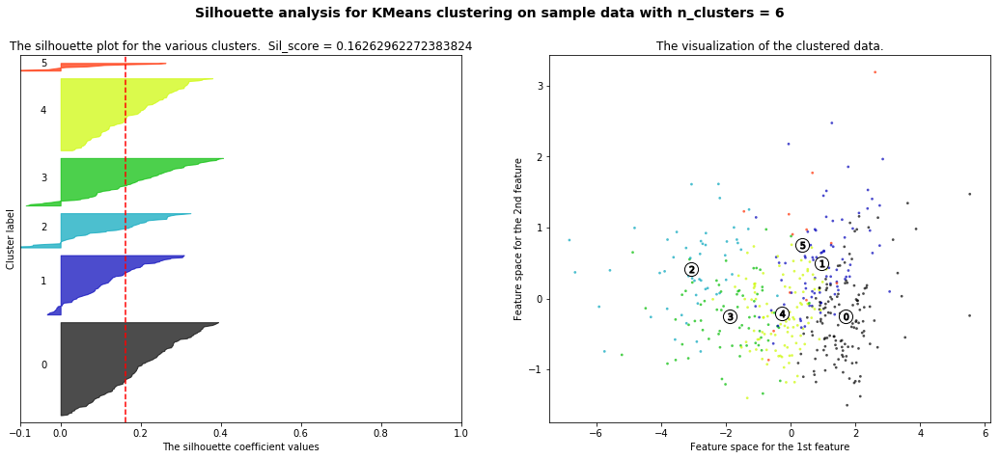

In [24]:
sil_score_kmeans_2(X_b_rp)

Accuracy of clustering: 0.8901098901098901


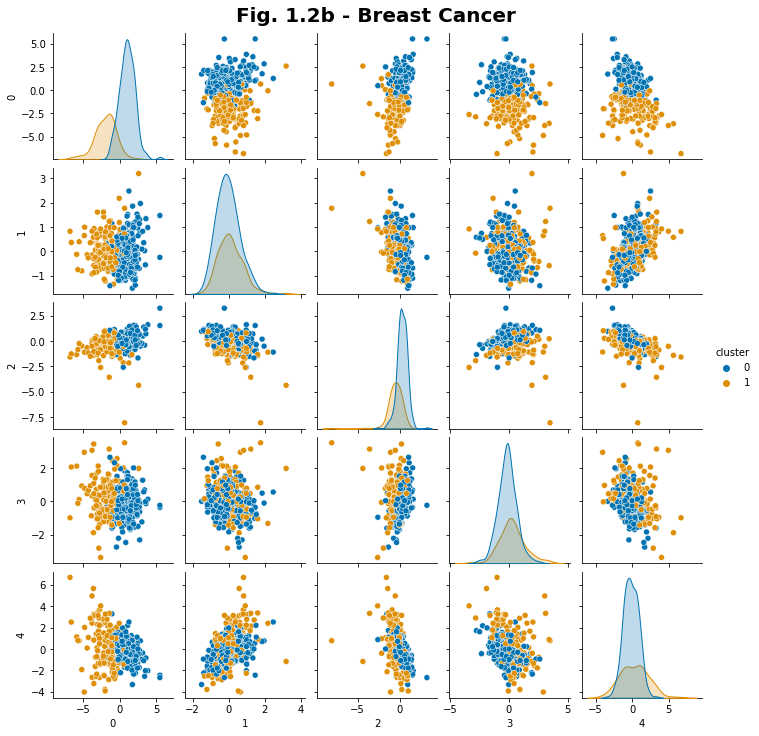

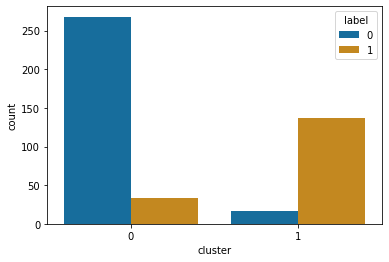

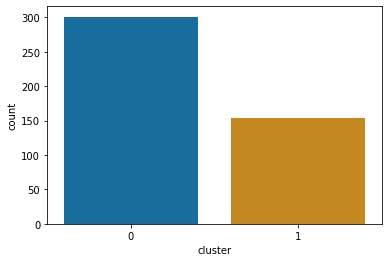

In [41]:
n_clusters = 2
X_val = X_b_rp
km_b = KMeans(n_clusters=n_clusters, random_state = 1)
km_b = km_b.fit(X_val)
cluster = km_b.predict(X_val)
df_b = pd.DataFrame(X_val[:,:5])
df_b["cluster"] = cluster
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, km_b)

Using Kneed
6


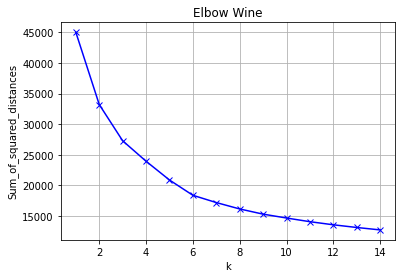

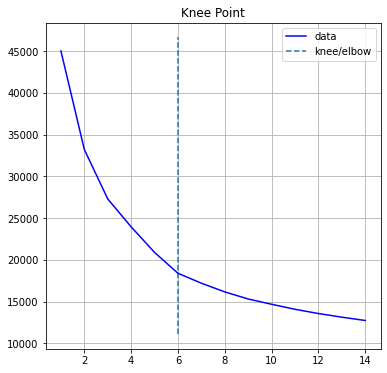

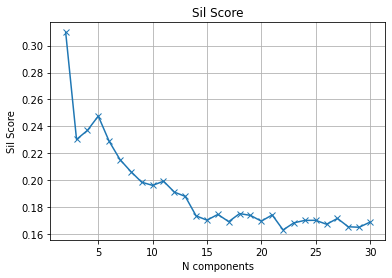

In [37]:
elbow(X_w_rp, title ="Elbow Wine")
sil_score_plot(X_w_rp)

For n_clusters = 2 The average silhouette_score is : 0.30994630298317144
For n_clusters = 3 The average silhouette_score is : 0.23029334369321386
For n_clusters = 4 The average silhouette_score is : 0.23701257625396205
For n_clusters = 5 The average silhouette_score is : 0.24766741680533177
For n_clusters = 6 The average silhouette_score is : 0.22890572583166688


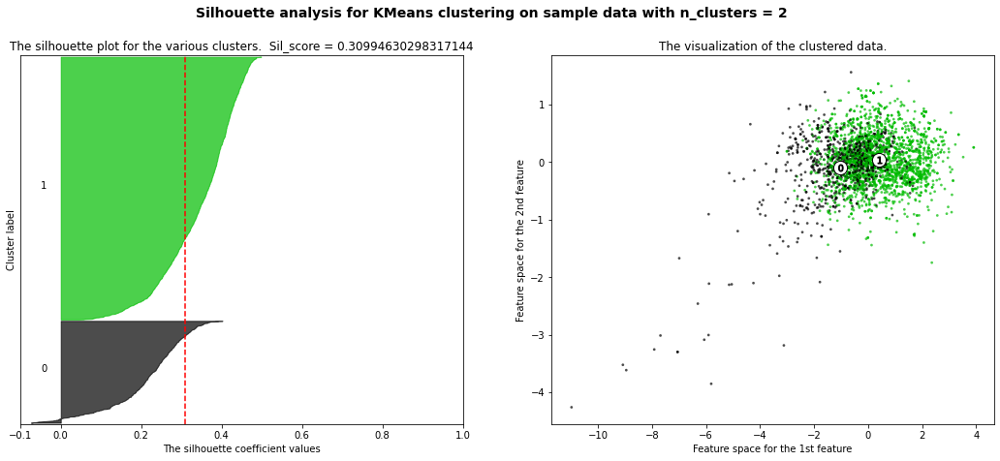

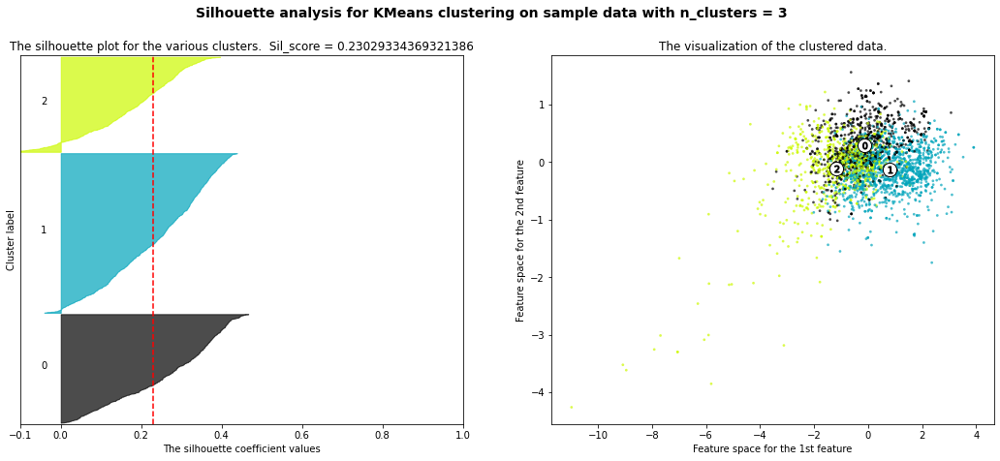

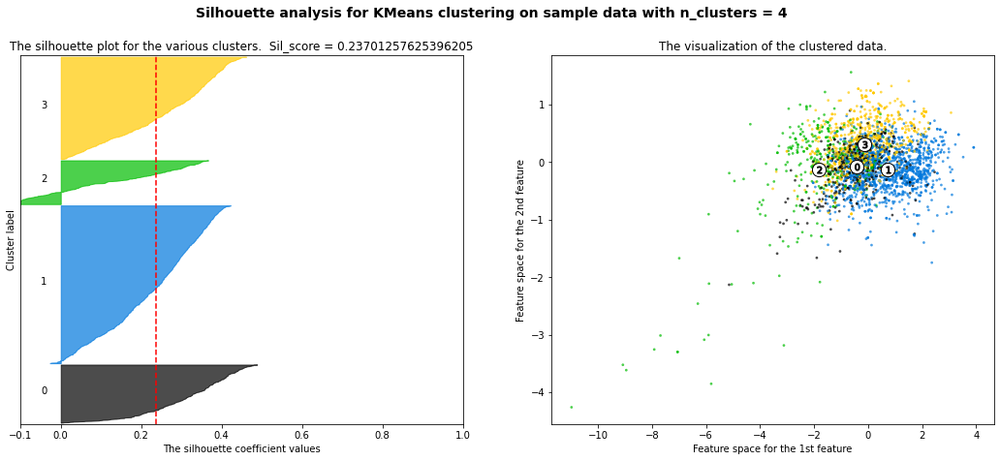

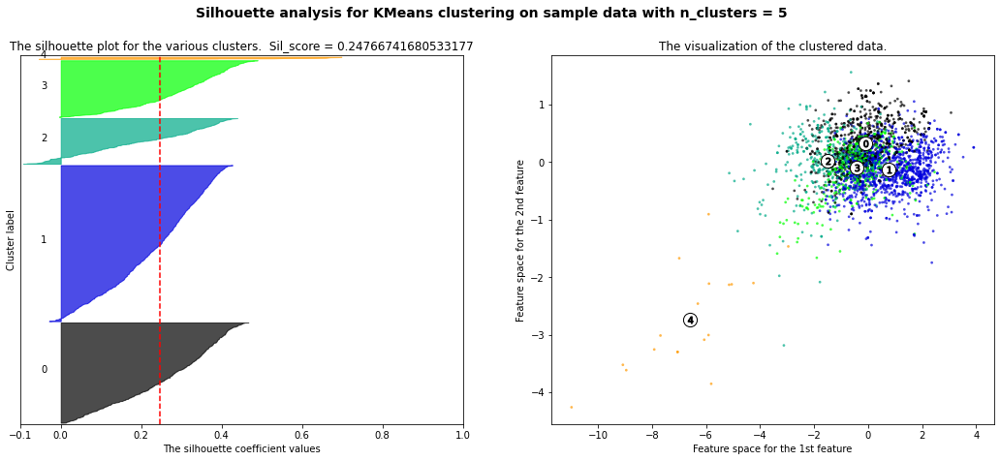

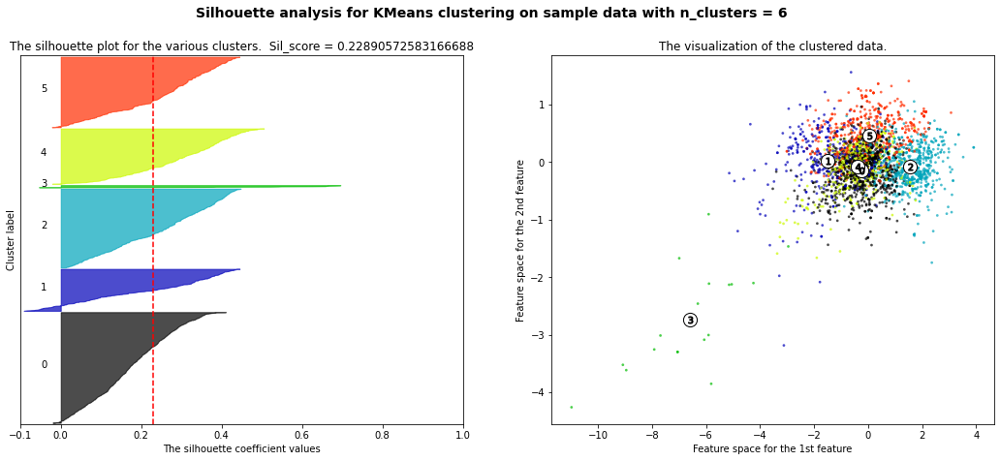

In [38]:
sil_score_kmeans_2(X_w_rp, random_seed=1)

Accuracy of clustering: 0.22882513661202186


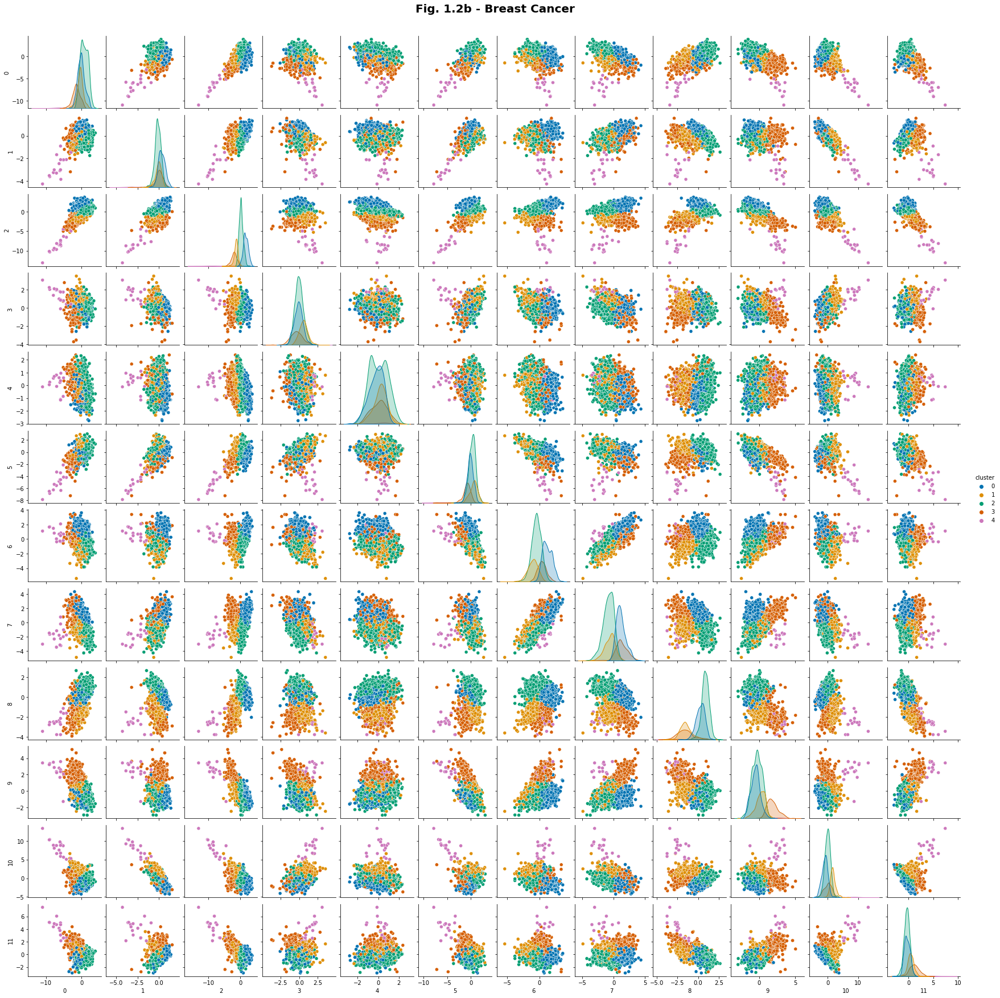

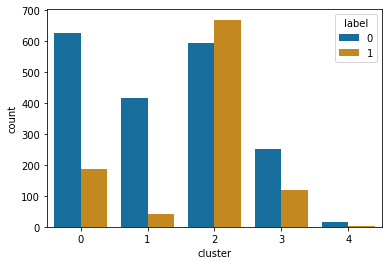

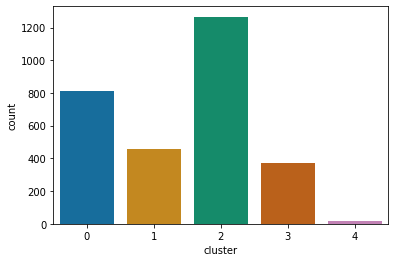

In [39]:
n_clusters = 5
X_val = X_w_rp
km_w = KMeans(n_clusters=n_clusters, random_state = 2)

km_w.fit(X_val)
cluster = km_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
df_w["label"] = y_w.values
print("Accuracy of clustering: " + str(accuracy_score(y_w, cluster)))
plt.show()

get_dist(X_val, y_w, km_w)

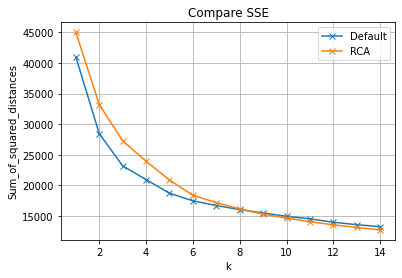

In [43]:
X_dict = {
    "Default" : X_w,
    "RCA" : X_w_rp
}
multiple_elbow(X_dict)

# RP + EM

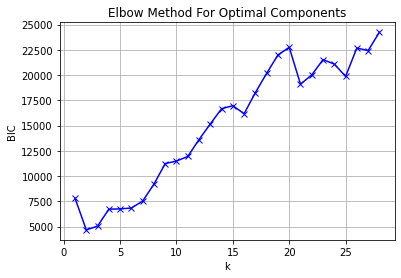

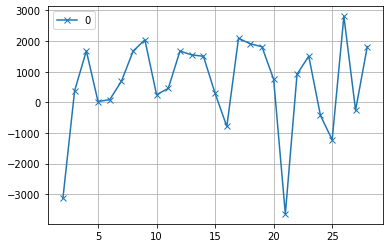

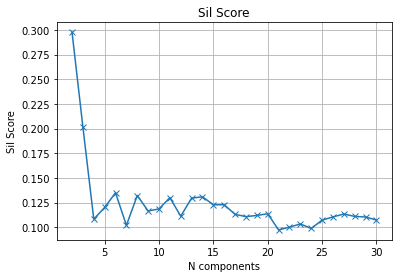

In [47]:
elbow_EM(X_b_rp)
sil_score_plot_EM(X_b_rp)

For n_clusters = 2 The average silhouette_score is : 0.29769600682555447
For n_clusters = 3 The average silhouette_score is : 0.20150938951564873
For n_clusters = 4 The average silhouette_score is : 0.10822272187561807
For n_clusters = 5 The average silhouette_score is : 0.12008551131401111
For n_clusters = 6 The average silhouette_score is : 0.13500013963299703


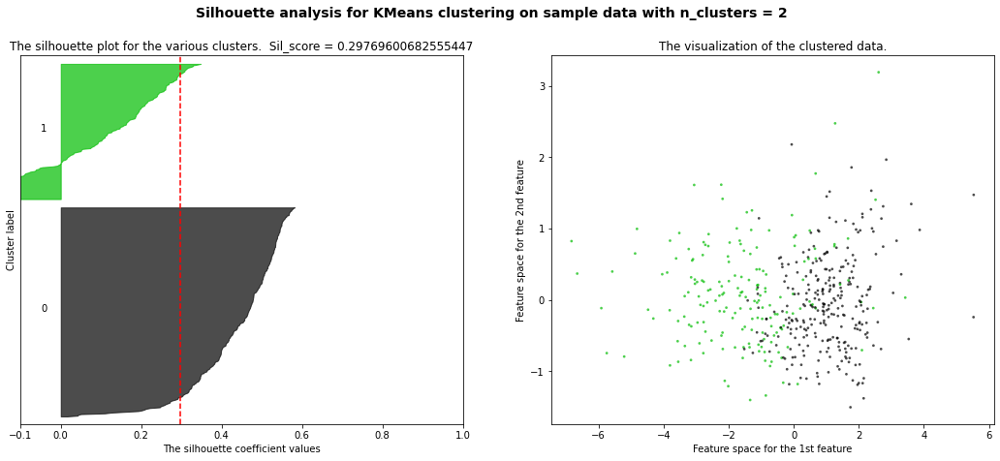

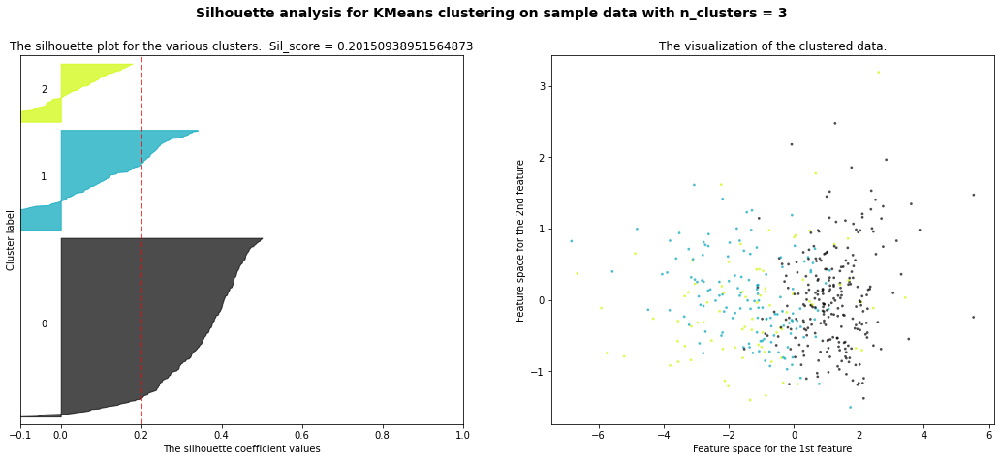

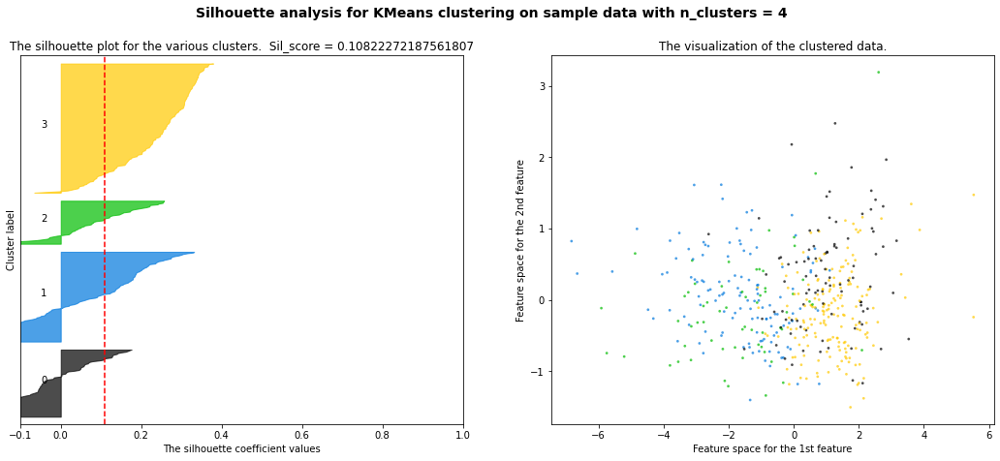

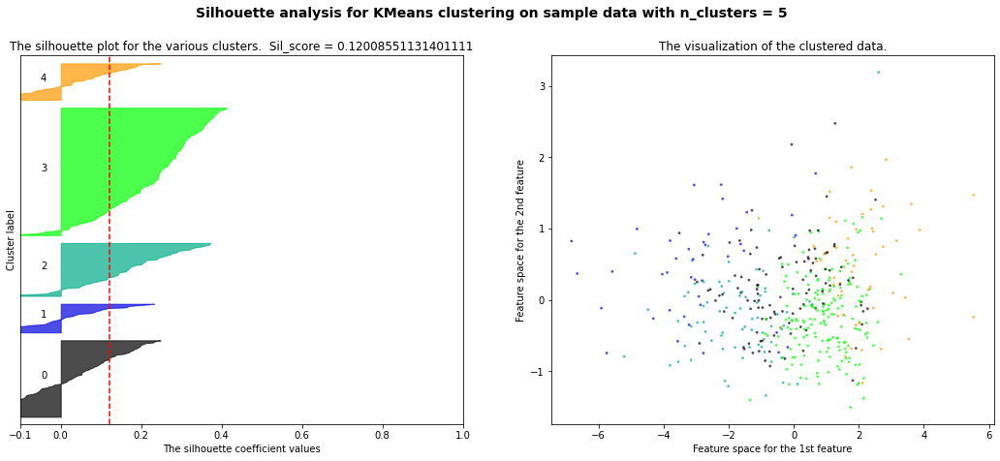

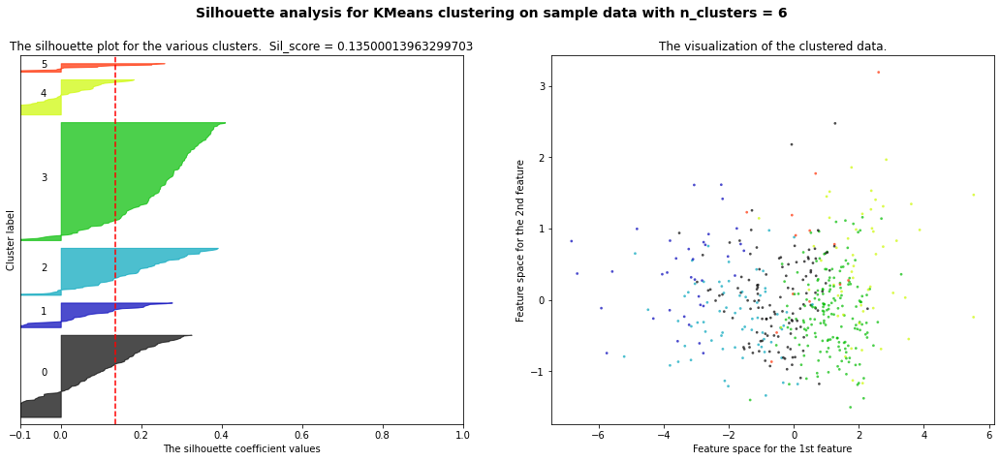

In [48]:
sil_score_EM(X_b_rp)

Accuracy of clustering: 0.9010989010989011


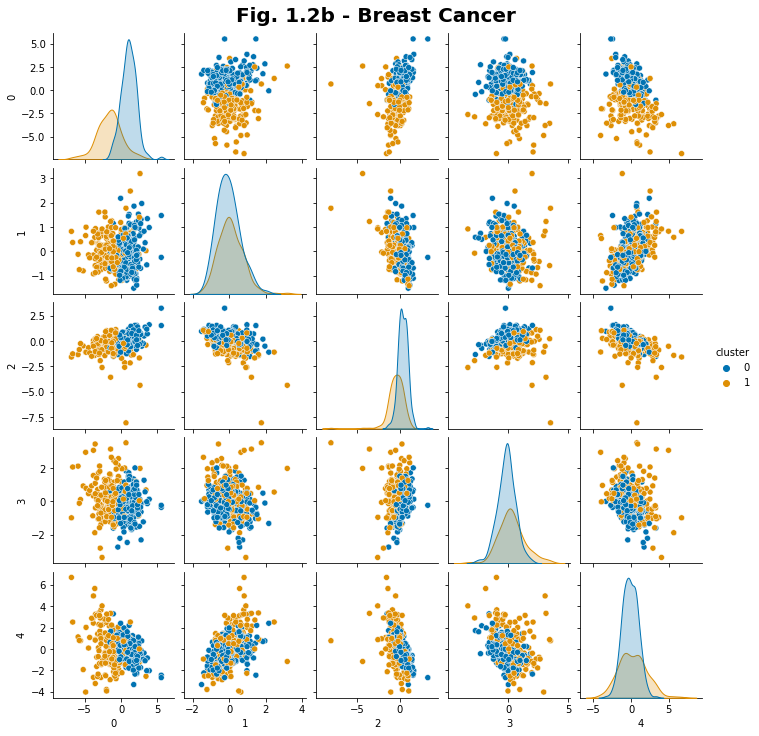

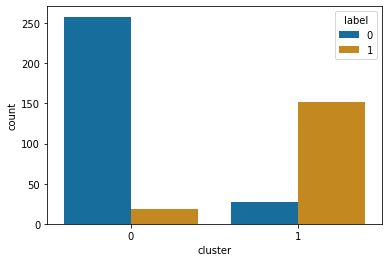

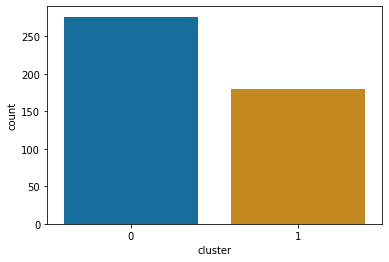

In [51]:
#Breast Cancer
n_clusters =2 
X_val = X_b_rp
gmm_b = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_b.fit(X_val)
cluster = gmm_b.predict(X_val)
df_b = pd.DataFrame(X_val[:,:5])
df_b["cluster"] = cluster
g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))
g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, gmm_b)

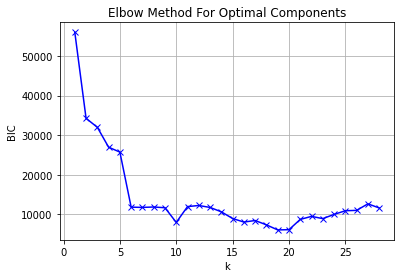

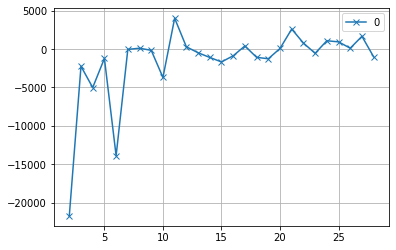

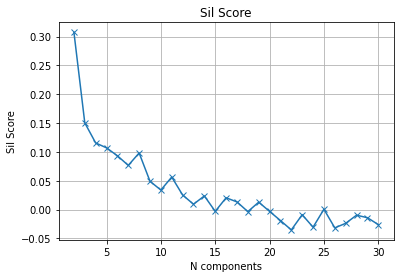

In [52]:
elbow_EM(X_w_rp, title = "Wine Dataset")
sil_score_plot_EM(X_w_rp)

Accuracy of clustering: 0.9986338797814208


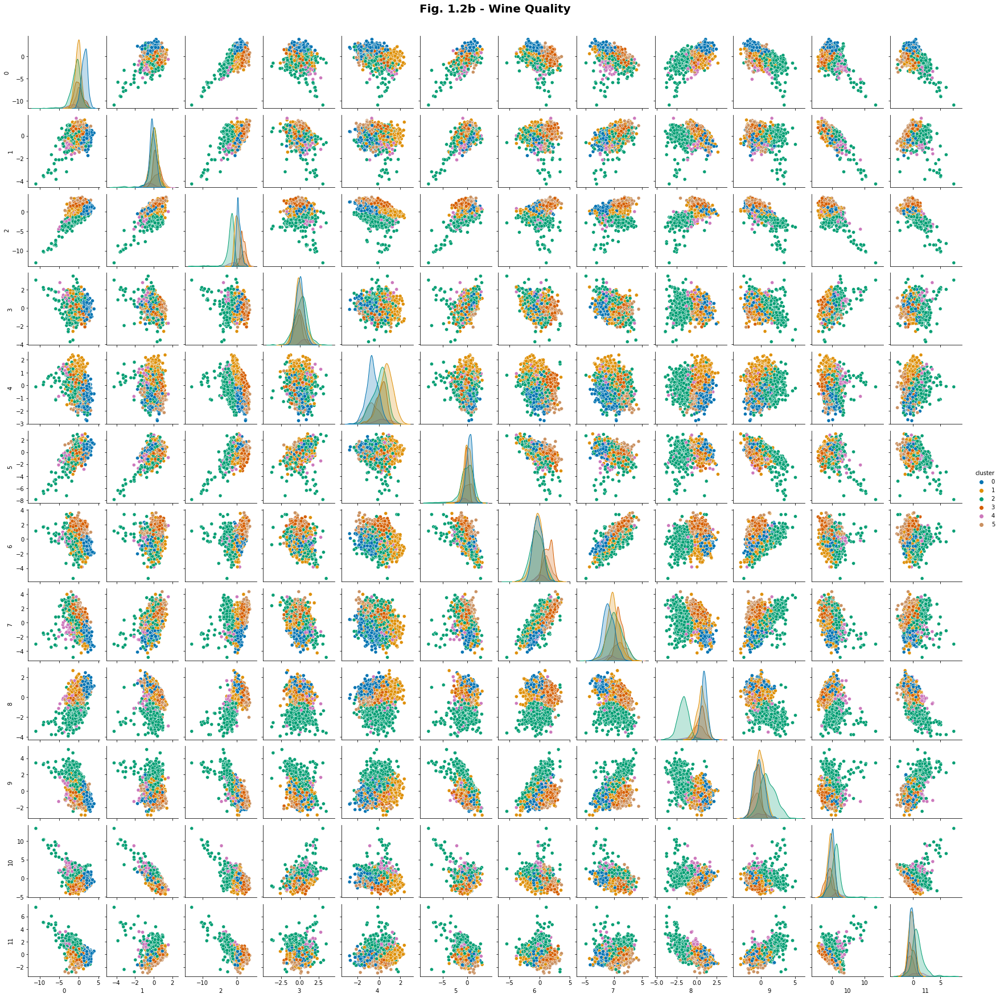

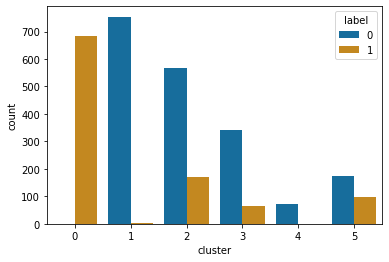

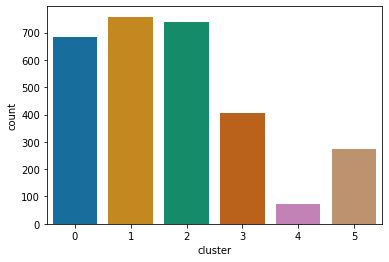

In [53]:
#Wine
n_clusters = 6
X_val = X_w_rp
gmm_w = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_w.fit(X_val)
cluster = gmm_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')
g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')

print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))
df_w["label"] = y_w.values
plt.show()
get_dist(X_val,y_w, gmm_w)

In [65]:
from scipy import sparse
from sklearn import decomposition
from sklearn import random_projection

import numpy as np
import pandas as pd
import sklearn.base
import warnings

class InvertibleRandomProjection(random_projection.GaussianRandomProjection):
    """Gaussian random projection with an inverse transform using the pseudoinverse."""

    def __init__(
        self, n_components="auto", eps=0.3, orthogonalize=True, random_state=None
    ):
        self.orthogonalize = orthogonalize
        super().__init__(n_components=n_components, eps=eps, random_state=random_state)

    @property
    def pseudoinverse(self):
        """Pseudoinverse of the random projection.

        This inverts the projection operation for any vector in the span of the
        random projection. For small enough `eps`, this should be close to the
        correct inverse.
        """
        try:
            return self._pseudoinverse
        except AttributeError:
            if self.orthogonalize:
                # orthogonal matrix: inverse is just its transpose
                self._pseudoinverse = self.components_
            else:
                self._pseudoinverse = np.linalg.pinv(self.components_.T)
            return self._pseudoinverse

    def fit(self, X):
        super().fit(X)
        if self.orthogonalize:
            Q, _ = np.linalg.qr(self.components_.T)
            self.components_ = Q.T
        return self


    def inverse_transform(self, X):
        return X.dot(self.components_)


In [69]:
rca_b = InvertibleRandomProjection(15)

X_transformed = rca_b.fit_transform(X_b)
X_inverse = rca_b.inverse_transform(X_transformed)
print(X_inverse.shape)
mse = MSE(X_b, X_inverse)
print("Reconstruction Error (" + str(rca_b.n_components) +") MSE: " + str(mse))
#reconstruction_error(X_b,rca_b)

(455, 30)
Reconstruction Error (15) MSE: 0.5449167988132263


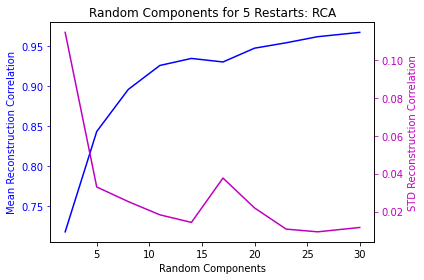

In [135]:
run_RCA(X_b,y_b)

# Decision Tree

In [515]:
def add_patch(legend):
    from matplotlib.patches import Patch
    ax = legend.axes

    handles, labels = [],[]
    handles.append(Patch(facecolor='Orange', edgecolor='k'))
    labels.append("Kept")
    handles.append(Patch( edgecolor='k'))
    labels.append("Discarded")

    legend._legend_box = "test"
    legend._init_legend_box(handles, labels)
    legend._set_loc(legend._loc)
    legend.set_title(legend.get_title().get_text())

In [556]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
def importance_barchart(X,y, columns, num_features = 8, cutoff = 0.025, title = "Feature Importance"):
    mod_dt = DecisionTreeClassifier(random_state =1, criterion = 'entropy')
    mod_dt.fit(X, y)
    
    sorted_feature_importance = sorted(zip(columns, mod_dt.feature_importances_))
    
    df = pd.DataFrame(sorted_feature_importance, columns =["Feature", "value"])     
    df = df.sort_values(by="value", ascending = False)
    print(df)
    cumsum = df.cumsum()
    cumsum  = cumsum.reset_index()
    #print(type(cumsum))
    #print(cumsum)
    X = df["Feature"][:num_features]
    
    y = df["value"][:num_features]
    #print(X,y)
    plt.xlabel("Features")
    plt.ylabel("Feature Importance")
    #plt.axhline(y = cutoff, color = "black", label = str(cutoff) + " FI cutoff line")
    #plt.legend(loc = "upper right")
    plt.xticks(rotation=25)
    barlist = plt.bar(X,y)
    for i, bar in enumerate(barlist):
        if cumsum["value"][i] < 0.91:
            #print(cumsum["value"][i])
            bar.set_color('orange')
            bar.set_edgecolor("black")
    
    plt.grid(True)
    lgd = plt.legend(loc='upper right')
    add_patch(lgd)
    plt.title(title, fontdict={'fontsize': 15, 'fontweight': 'heavy'})
    plt.show()
    

No handles with labels found to put in legend.


                    Feature     value
17          perimeter_worst  0.593748
8      concave points_worst  0.180321
29            texture_worst  0.079777
20             radius_worst  0.026827
1                   area_se  0.026224
27             texture_mean  0.020882
22            smoothness_se  0.014961
11          concavity_worst  0.013246
9            concavity_mean  0.011942
13     fractal_dimension_se  0.011191
6       concave points_mean  0.010441
23         smoothness_worst  0.010441
26           symmetry_worst  0.000000
25              symmetry_se  0.000000
24            symmetry_mean  0.000000
28               texture_se  0.000000
19                radius_se  0.000000
21          smoothness_mean  0.000000
0                 area_mean  0.000000
18              radius_mean  0.000000
16             perimeter_se  0.000000
14  fractal_dimension_worst  0.000000
12   fractal_dimension_mean  0.000000
10             concavity_se  0.000000
7         concave points_se  0.000000
5         co

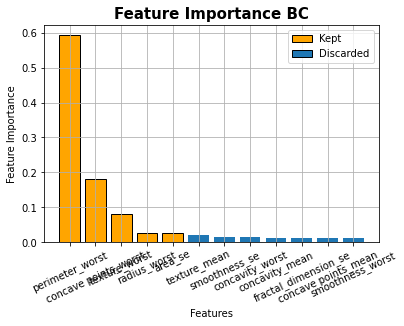

In [557]:
importance_barchart(X_b, y_b, X_b_pre_scale.columns, 12, title = "Feature Importance BC")

No handles with labels found to put in legend.


                 Feature     value
0                alcohol  0.386721
12      volatile acidity  0.153468
9         residual sugar  0.083695
10             sulphates  0.070841
11  total sulfur dioxide  0.067954
5    free sulfur dioxide  0.063455
4          fixed acidity  0.041746
1              chlorides  0.041186
8                     pH  0.036589
2            citric acid  0.030898
3                density  0.023447
6                  isRed  0.000000
7                isWhite  0.000000


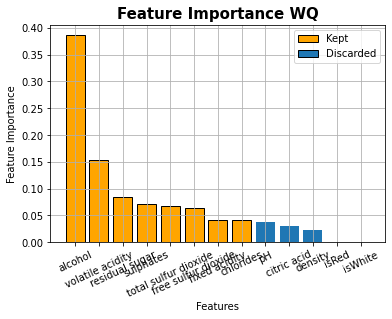

In [558]:
importance_barchart(X_w, y_w, X_w_pre_scale.columns, 14, cutoff = 0.05, title = "Feature Importance WQ")

In [384]:
mod_dt = DecisionTreeClassifier(random_state =1, criterion = 'entropy')

In [327]:
mod_dt.fit(X_b, y_b)
for name, importance in sorted(zip(X_b_pre_scale.columns, mod_dt.feature_importances_), key = lambda x:x[1], reverse = True):
    print(name, importance)

perimeter_worst 0.5937475731545566
concave points_worst 0.1803207099873657
texture_worst 0.07977667740823347
radius_worst 0.026827126381496917
area_se 0.026223984608099146
texture_mean 0.020881885237086173
smoothness_se 0.014961184407621042
concavity_worst 0.013245668800077071
concavity_mean 0.011942189752311415
fractal_dimension_se 0.011191115026066293
concave points_mean 0.010440942618543086
smoothness_worst 0.010440942618543086
radius_mean 0.0
perimeter_mean 0.0
area_mean 0.0
smoothness_mean 0.0
compactness_mean 0.0
symmetry_mean 0.0
fractal_dimension_mean 0.0
radius_se 0.0
texture_se 0.0
perimeter_se 0.0
compactness_se 0.0
concavity_se 0.0
concave points_se 0.0
symmetry_se 0.0
area_worst 0.0
compactness_worst 0.0
symmetry_worst 0.0
fractal_dimension_worst 0.0


In [585]:
selected_FI_b = ["perimeter_worst", "concave points_worst", "texture_worst", "radius_worst",
                "area_se"]
df_b_FI = pd.DataFrame(X_b, columns = X_b_pre_scale.columns)
X_b_FI = df_b_FI[selected_FI_b].to_numpy()

In [586]:
X_b_FI

array([[-0.49169317, -0.49674463, -0.57905888, -0.49644661, -0.58156766],
       [-0.21578318, -0.16152505,  1.20925828, -0.20526355, -0.24542504],
       [-0.24604807, -0.70429707, -0.13878384, -0.25652818, -0.40574288],
       ...,
       [-0.09531131,  0.3073344 ,  1.3853683 , -0.20731414, -0.51500712],
       [ 2.1348876 ,  0.70004153,  3.16888247,  2.37847347,  1.66455212],
       [-0.45320093, -0.20781373, -0.94888992, -0.49234544, -0.40168722]])

In [588]:
selected_FI_w = ["alcohol", "volatile acidity", "residual sugar", "sulphates",
                "total sulfur dioxide", "free sulfur dioxide","fixed acidity", "chlorides"]

df_w_FI = pd.DataFrame(X_w, columns = X_w_pre_scale.columns)
X_w_FI = df_w_FI[selected_FI_w].to_numpy()

In [589]:
df_w_FI[selected_FI_w]

,alcohol,volatile acidity,residual sugar,sulphates,total sulfur dioxide,free sulfur dioxide,fixed acidity,chlorides
0,-0.104606,-0.399713,1.243025,-0.471531,1.616188,0.722356,0.507454,-0.645999
1,-0.993009,-0.457061,1.416003,0.602586,0.558006,-0.283883,0.123926,-0.112969
2,2.076019,-0.285017,0.615983,-1.277119,0.452188,-0.060274,0.660865,-0.779257
3,0.056922,0.288464,-0.681345,0.871115,-1.311448,-1.178317,1.197804,0.953093
4,-0.589189,-0.112973,-0.811077,-0.404399,1.051824,-0.954709,1.274510,-0.033014
...,...,...,...,...,...,...,...,...
2923,-1.073772,2.094930,-0.681345,0.132660,-1.329085,-1.066513,0.660865,0.393410
2924,-1.316064,-0.858498,1.351136,-0.672928,0.646188,0.834160,-0.643130,-0.406135
2925,1.914491,0.345812,-0.227280,-0.538664,-0.147449,0.219236,0.200632,-0.459439
2926,-1.073772,-0.629106,0.551117,-0.471531,1.616188,1.337279,-0.796541,-0.326181


Using Kneed
3


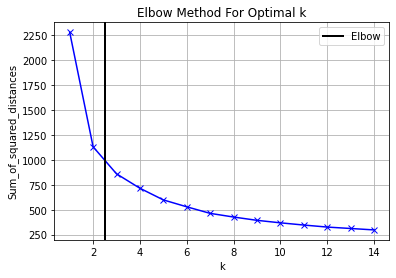

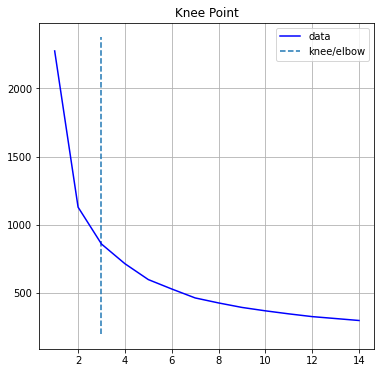

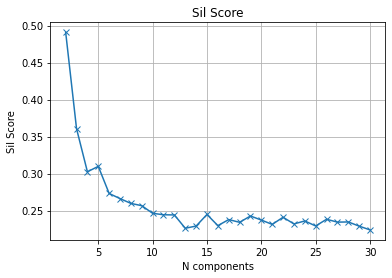

In [580]:
elbow(X_b_FI)
sil_score_plot(X_b_FI)

Accuracy of clustering: 0.9054945054945055


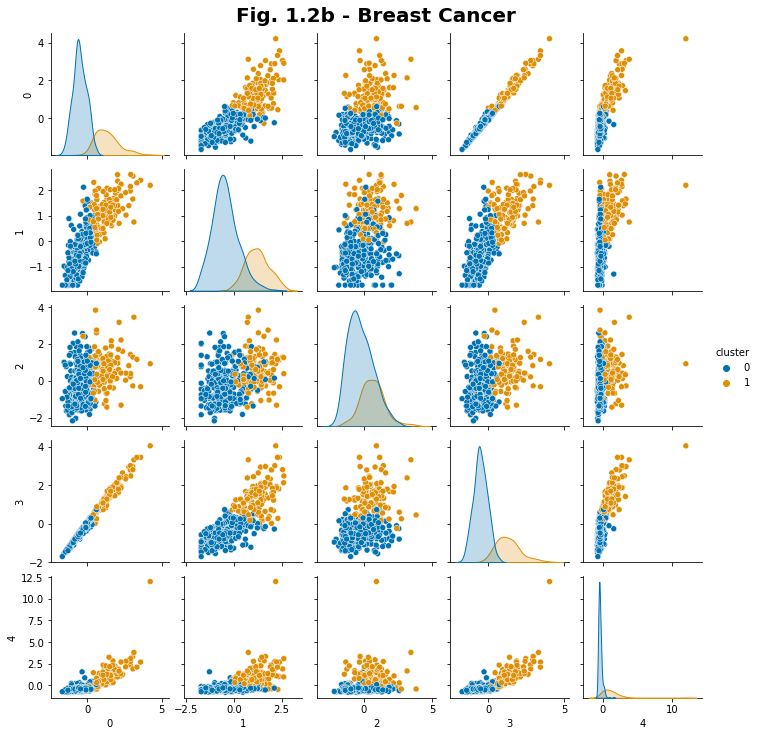

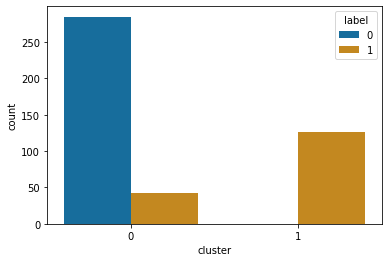

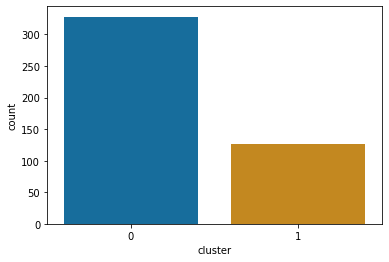

In [587]:
n_clusters = 2
X_val = X_b_FI
km_b = KMeans(n_clusters=n_clusters, random_state = 1)
km_b = km_b.fit(X_val)
cluster = km_b.predict(X_val)
df_b = pd.DataFrame(X_val[:,:5])
df_b["cluster"] = cluster
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))

g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, km_b)

Using Kneed
4


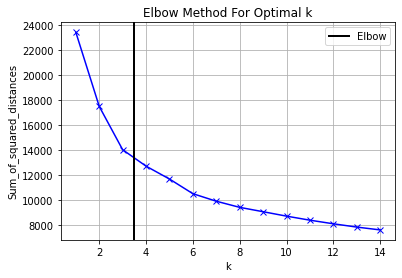

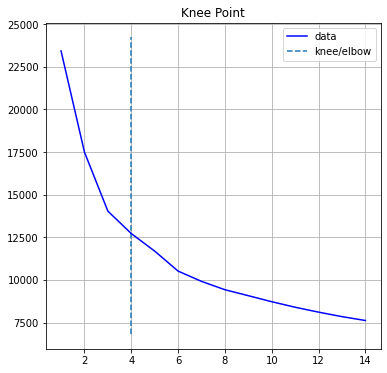

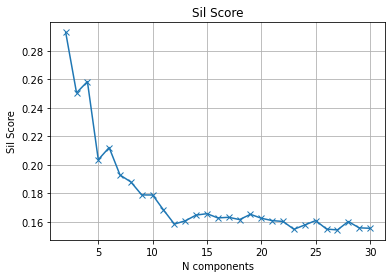

In [590]:
elbow(X_w_FI)
sil_score_plot(X_w_FI)

For n_clusters = 2 The average silhouette_score is : 0.2929844088055531
For n_clusters = 3 The average silhouette_score is : 0.2504816950531363
For n_clusters = 4 The average silhouette_score is : 0.25838204437614587
For n_clusters = 5 The average silhouette_score is : 0.20356884035794148
For n_clusters = 6 The average silhouette_score is : 0.21211664815930883


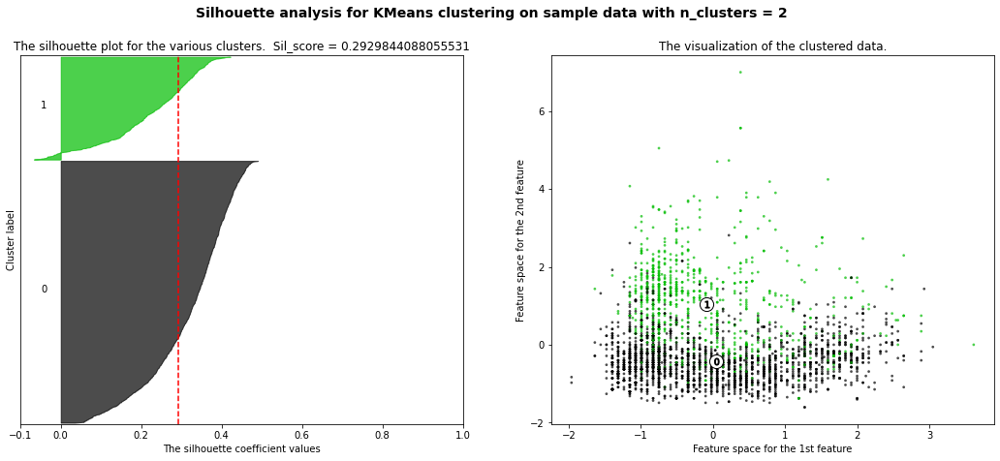

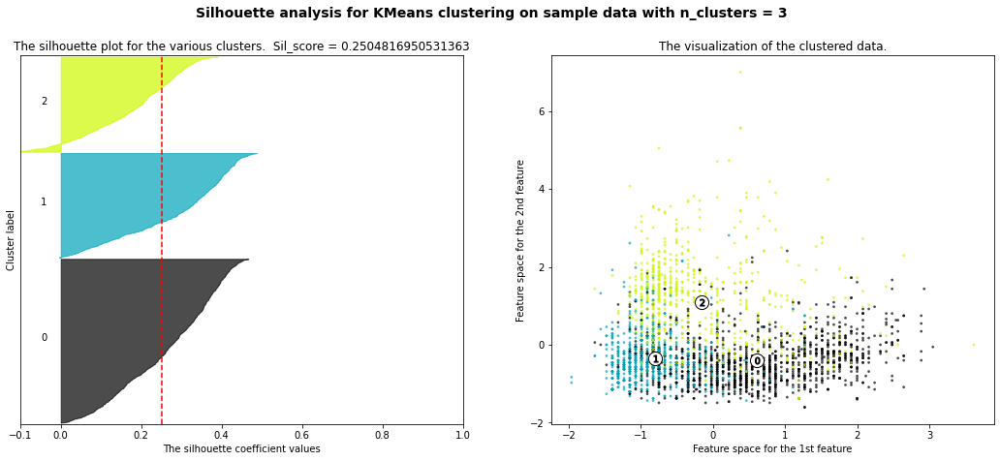

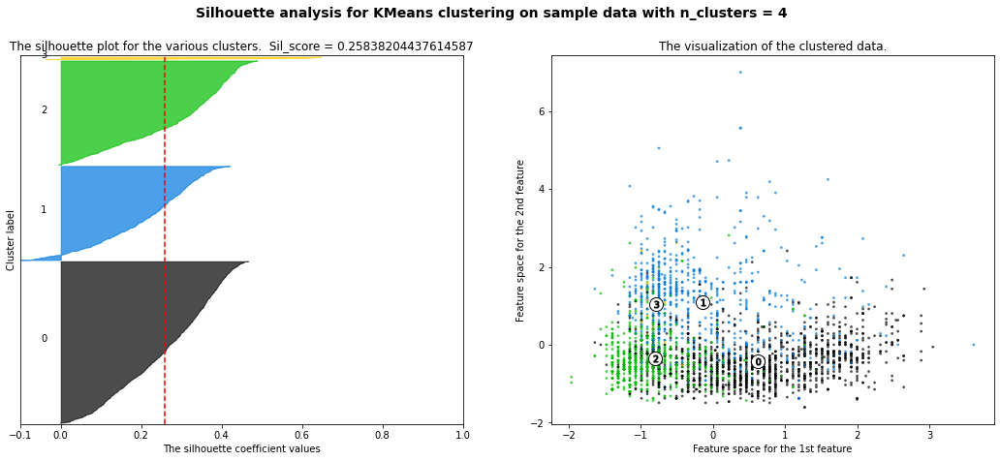

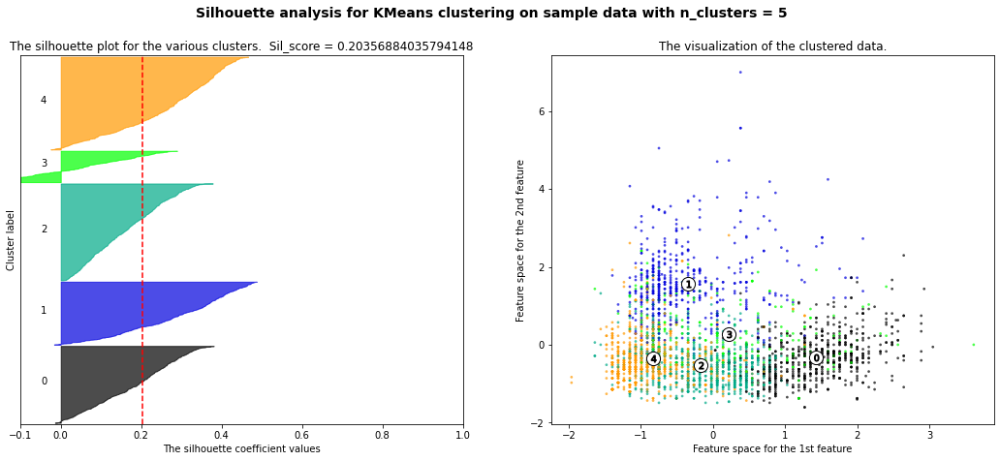

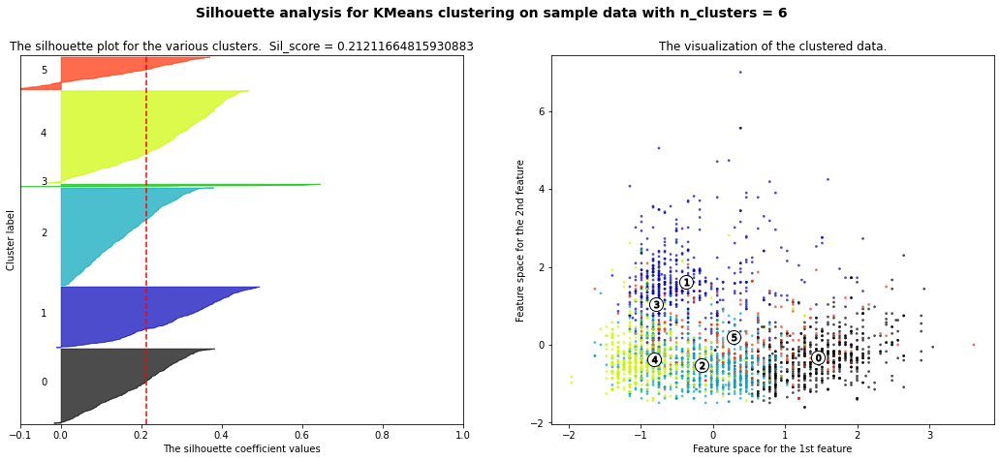

In [591]:
sil_score_kmeans_2(X_w_FI)

Accuracy of clustering: 0.25170765027322406


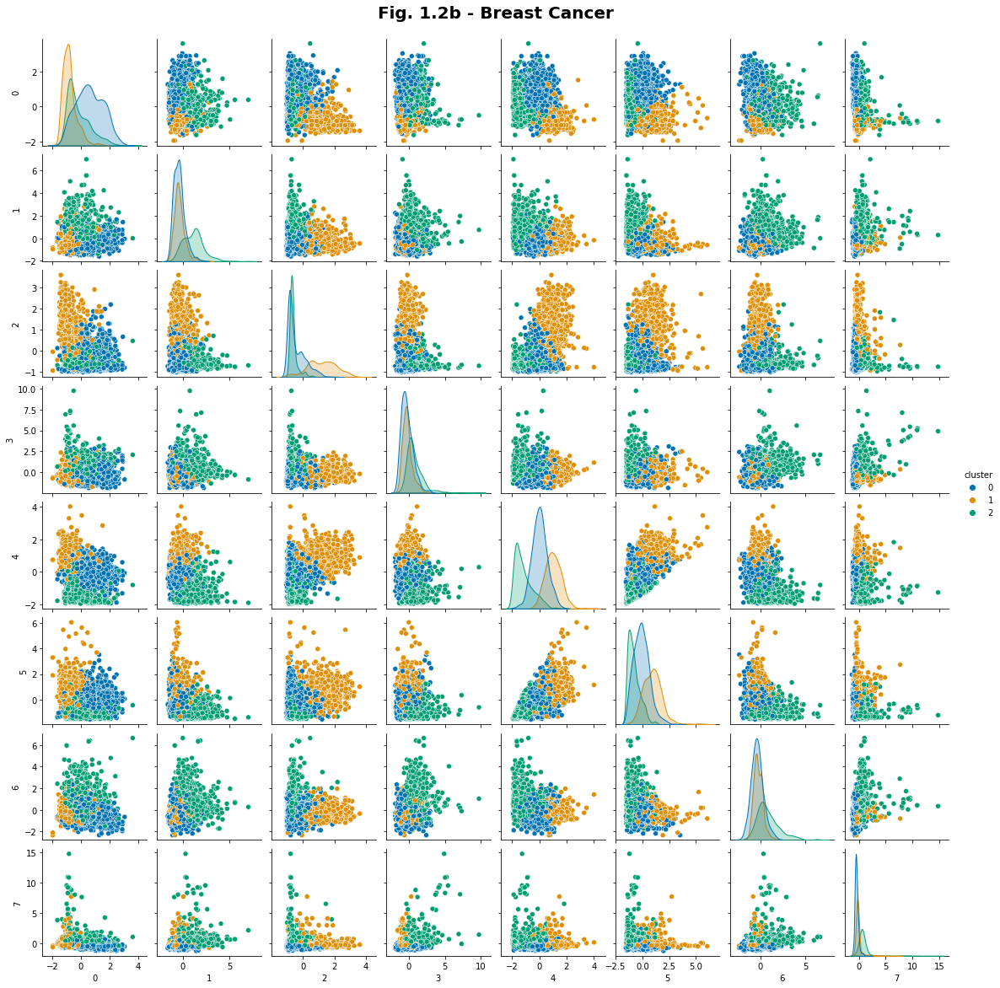

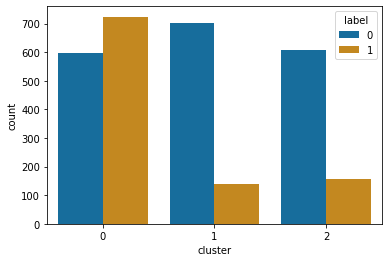

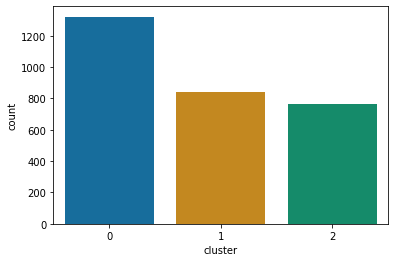

In [597]:
n_clusters = 3
X_val = X_w_FI
km_w = KMeans(n_clusters=n_clusters, random_state = 2)

km_w.fit(X_val)
cluster = km_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')

g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
df_w["label"] = y_w.values
print("Accuracy of clustering: " + str(accuracy_score(y_w, cluster)))
plt.show()

get_dist(X_val, y_w, km_w)

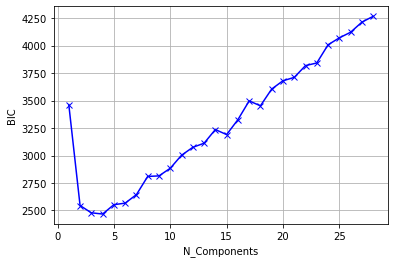

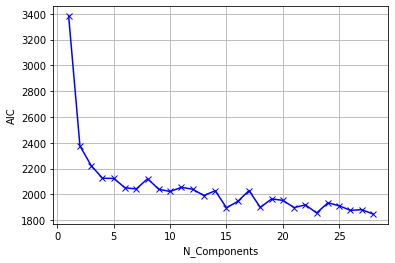

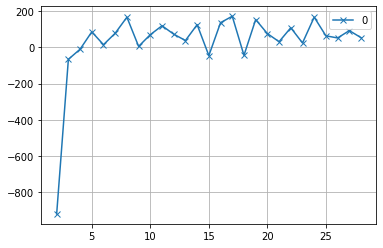

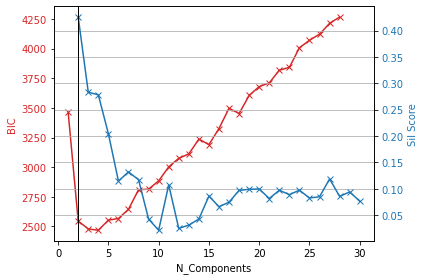

In [595]:
elbow_EM(X_b_FI)
twinx_EM(X_b_FI)

Accuracy of clustering: 0.8879120879120879


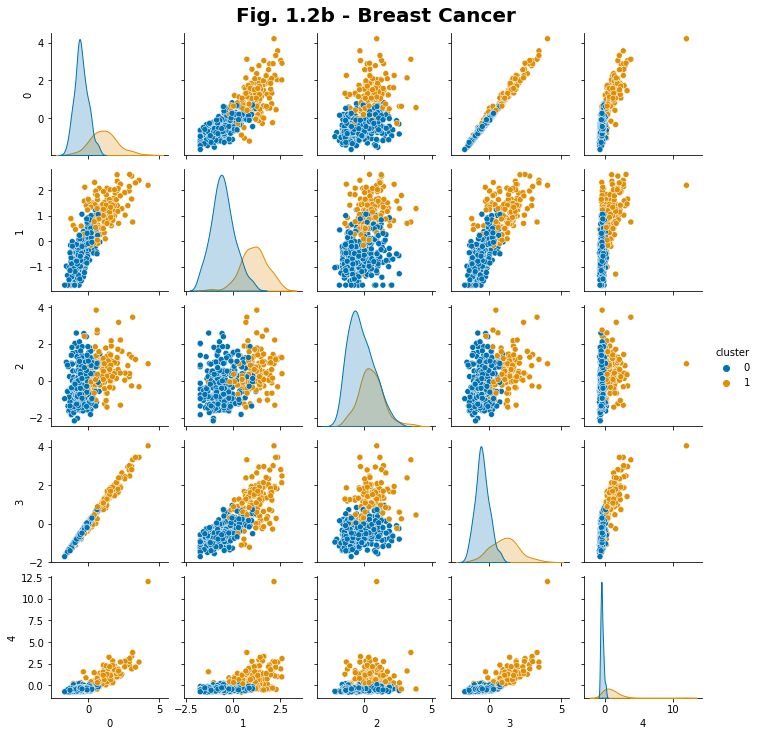

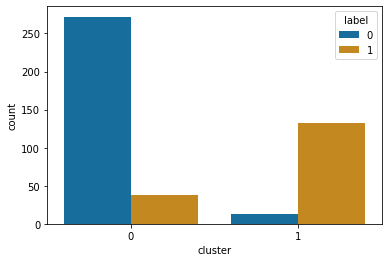

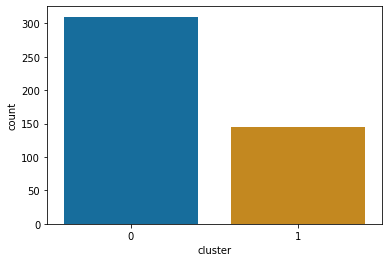

In [596]:
#Breast Cancer
n_clusters =2 
X_val = X_b_FI
gmm_b = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_b.fit(X_val)
cluster = gmm_b.predict(X_val)
df_b = pd.DataFrame(X_val[:,:5])
df_b["cluster"] = cluster
g =sns.pairplot(df_b, hue="cluster", height = 2, palette = 'colorblind')

df_b["label"] = y_b.values
print("Accuracy of clustering: " + str(accuracy_score(y_b, cluster)))
g.fig.suptitle("Fig. 1.2b - Breast Cancer", y = 1.02, fontsize=20, fontweight ='heavy')
plt.grid(True)
plt.show()
get_dist(X_val,y_b, gmm_b)

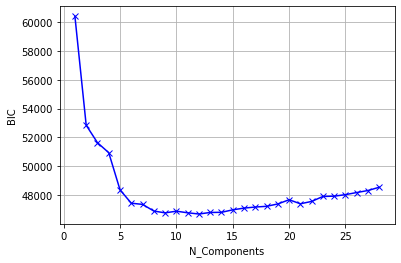

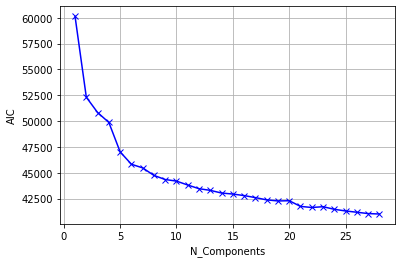

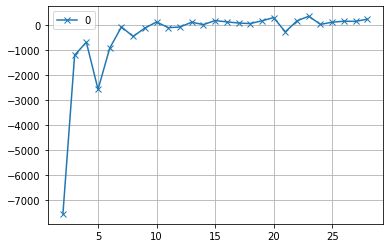

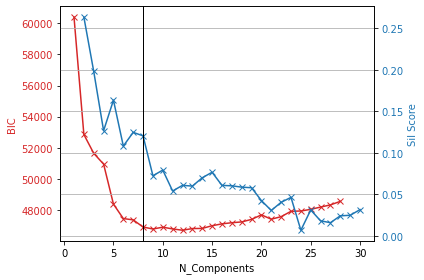

In [600]:
elbow_EM(X_w_FI)
twinx_EM(X_w_FI,axline=8)

Accuracy of clustering: 0.8538251366120219


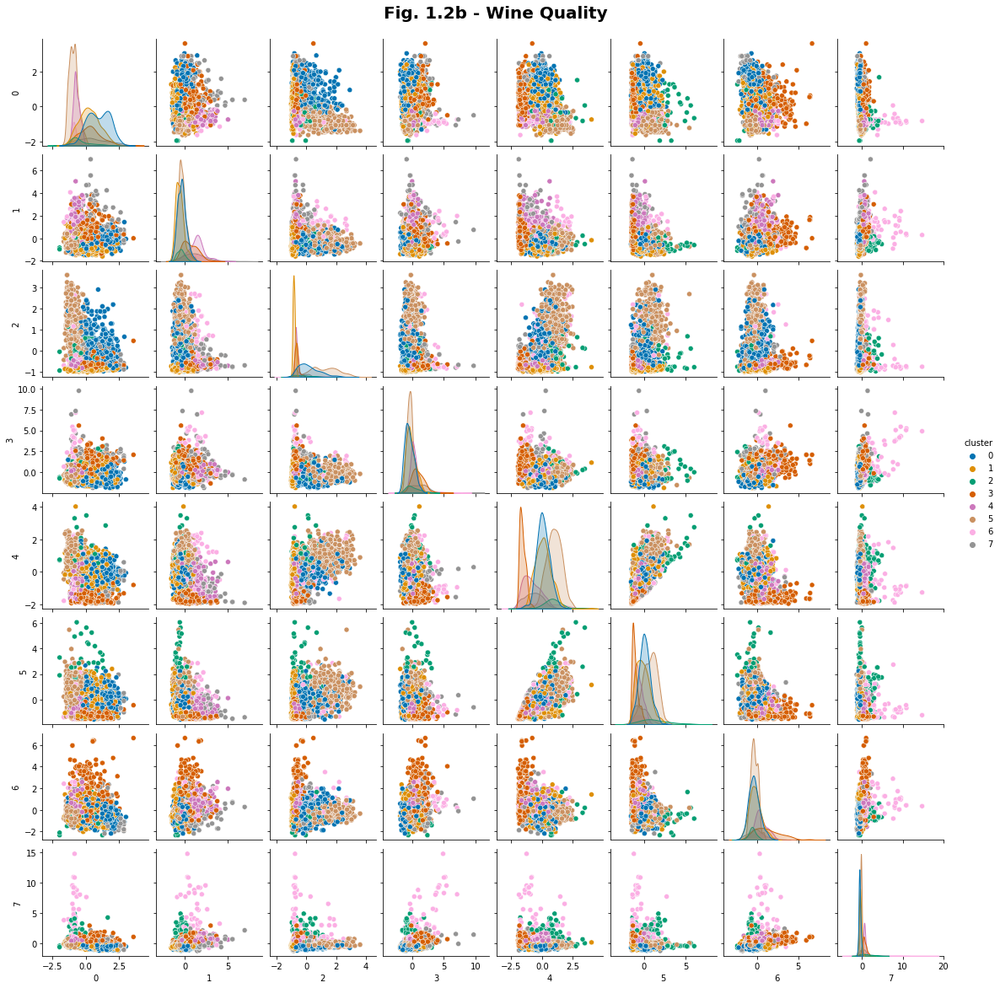

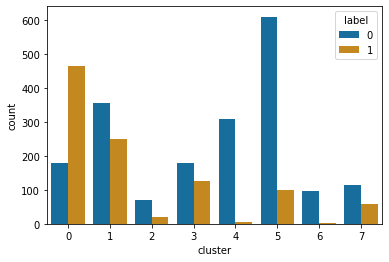

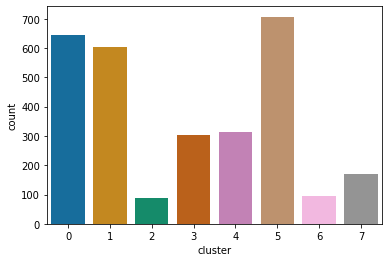

In [604]:
#Wine
n_clusters = 8
X_val = X_w_FI
gmm_w = GaussianMixture(n_components = n_clusters, random_state = random_seed)
gmm_w.fit(X_val)
cluster = gmm_w.predict(X_val)
df_w = pd.DataFrame(X_val)
df_w["cluster"] = cluster

g =sns.pairplot(df_w, hue="cluster", height = 2, palette = 'colorblind')
g.fig.suptitle("Fig. 1.2b - Wine Quality", y = 1.02, fontsize=20, fontweight ='heavy')

print("Accuracy of clustering: " + str(1- accuracy_score(y_w, cluster)))
df_w["label"] = y_w.values
plt.show()
get_dist(X_val,y_w, gmm_w)

# LDA

In [178]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
lda_b = LDA()
lda_b.fit(X_b, y_b,)

lda_b = LDA()
lda_w.fit(X_w, y_w)

LinearDiscriminantAnalysis()

In [180]:
lda_b.covariance_estimator

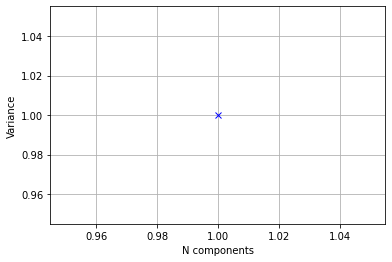

In [174]:
plt.plot([i +1 for i in range(len(lda_b.explained_variance_ratio_))], lda_b.explained_variance_ratio_, 'bx-')
plt.xlabel('N components')
plt.ylabel('Variance')
plt.grid()

In [171]:
import numpy as np
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca.fit(X_b)

data_reduced = np.dot(X_b, pca.components_.T) # transform
data_original = np.dot(data_reduced, pca.components_) # inverse_transform
print(data_reduced.shape)
print(data_original.shape)
mse = mean_squared_error(data_reduced, data_original)

(455, 3)
(455, 30)


ValueError: y_true and y_pred have different number of output (3!=30)

In [166]:
rca_b = PCA(15)

X_transformed = rca_b.fit_transform(X_b)
X_inverse = rca_b.inverse_transform(X_transformed)
print(X_inverse.shape)

(455, 30)


Automatically created module for IPython interactive environment

Prediction accuracy for the normal test dataset with PCA
81.48%


Prediction accuracy for the standardized test dataset with PCA
98.15%


PC 1 without scaling:
 [ 1.76342917e-03 -8.35544737e-04  1.54623496e-04 -5.31136096e-03
  2.01663336e-02  1.02440667e-03  1.53155502e-03 -1.11663562e-04
  6.31071580e-04  2.32645551e-03  1.53606718e-04  7.43176482e-04
  9.99775716e-01]

PC 1 with scaling:
 [ 0.13443023 -0.25680248 -0.0113463  -0.23405337  0.15840049  0.39194918
  0.41607649 -0.27871336  0.33129255 -0.11383282  0.29726413  0.38054255
  0.27507157]


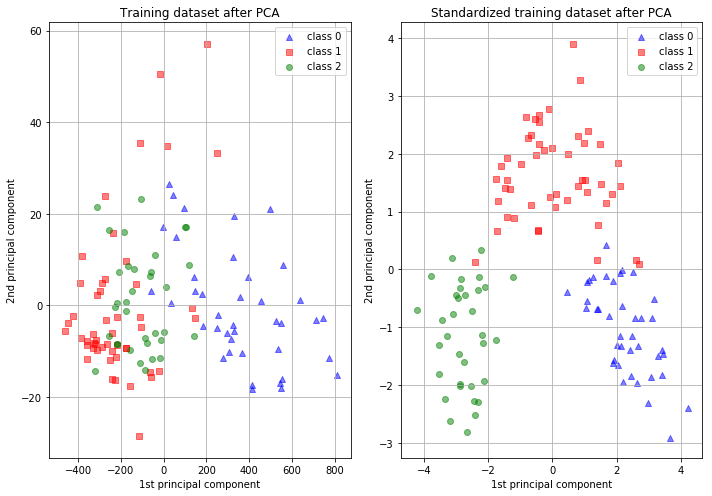

In [40]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.datasets import load_wine
from sklearn.pipeline import make_pipeline
print(__doc__)

# Code source: Tyler Lanigan <tylerlanigan@gmail.com>
#              Sebastian Raschka <mail@sebastianraschka.com>

# License: BSD 3 clause

RANDOM_STATE = 42
FIG_SIZE = (10, 7)


features, target = load_wine(return_X_y=True)

# Make a train/test split using 30% test size
X_train, X_test, y_train, y_test = train_test_split(features, target,
                                                    test_size=0.30,
                                                    random_state=RANDOM_STATE)

# Fit to data and predict using pipelined GNB and PCA.
unscaled_clf = make_pipeline(PCA(n_components=2), GaussianNB())
unscaled_clf.fit(X_train, y_train)
pred_test = unscaled_clf.predict(X_test)

# Fit to data and predict using pipelined scaling, GNB and PCA.
std_clf = make_pipeline(StandardScaler(), PCA(n_components=2), GaussianNB())
std_clf.fit(X_train, y_train)
pred_test_std = std_clf.predict(X_test)

# Show prediction accuracies in scaled and unscaled data.
print('\nPrediction accuracy for the normal test dataset with PCA')
print('{:.2%}\n'.format(metrics.accuracy_score(y_test, pred_test)))

print('\nPrediction accuracy for the standardized test dataset with PCA')
print('{:.2%}\n'.format(metrics.accuracy_score(y_test, pred_test_std)))

# Extract PCA from pipeline
pca = unscaled_clf.named_steps['pca']
pca_std = std_clf.named_steps['pca']

# Show first principal components
print('\nPC 1 without scaling:\n', pca.components_[0])
print('\nPC 1 with scaling:\n', pca_std.components_[0])

# Use PCA without and with scale on X_train data for visualization.
X_train_transformed = pca.transform(X_train)
scaler = std_clf.named_steps['standardscaler']
X_train_std_transformed = pca_std.transform(scaler.transform(X_train))

# visualize standardized vs. untouched dataset with PCA performed
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=FIG_SIZE)


for l, c, m in zip(range(0, 3), ('blue', 'red', 'green'), ('^', 's', 'o')):
    ax1.scatter(X_train_transformed[y_train == l, 0],
                X_train_transformed[y_train == l, 1],
                color=c,
                label='class %s' % l,
                alpha=0.5,
                marker=m
                )

for l, c, m in zip(range(0, 3), ('blue', 'red', 'green'), ('^', 's', 'o')):
    ax2.scatter(X_train_std_transformed[y_train == l, 0],
                X_train_std_transformed[y_train == l, 1],
                color=c,
                label='class %s' % l,
                alpha=0.5,
                marker=m
                )

ax1.set_title('Training dataset after PCA')
ax2.set_title('Standardized training dataset after PCA')

for ax in (ax1, ax2):
    ax.set_xlabel('1st principal component')
    ax.set_ylabel('2nd principal component')
    ax.legend(loc='upper right')
    ax.grid()

plt.tight_layout()

plt.show()

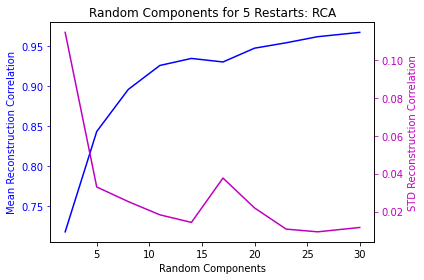

In [135]:
run_RCA(X_b,y_b)

In [87]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.datasets import make_classification


# We center the data and compute the sample covariance matrix.

eigenvalues = pca.explained_variance_
for eigenvalue, eigenvector in zip(eigenvalues, pca.components_):    
    print(np.dot(eigenvector.T, np.dot(cov_matrix, eigenvector)))
    print(eigenvalue)

2.877879356638284
2.8807601167550367
1.976175631541801
1.9781537853271272
1.2254910999524915
1.2267178177702593
1.2030123189804358
1.2042165355159533
1.1541416846343273
1.1552969816159466
1.0713589481929455
1.0724313795725167
1.05364390182031
1.054698600420729
1.0466012148580857
1.047648863721807
1.027559431727651
1.028588019747396
1.0111391381254224
1.0121512894148368
0.9976400579115459
0.9986386966081535
0.9690009600089596
0.9699709309398996
0.9198223507799818
0.9207430938738558
0.8891929725042933
0.890083055559852
0.8681229650941363
0.8689919570511874
0.8484378212495527
0.8492871083579087
0.8404207290888314
0.8412619910799111
0.834382050596865
0.8352172678647288
5.381520825615998e-17
9.744647891769764e-32
-1.6567115797359278e-17
2.0162067671398332e-32


For n_clusters = 2 The average silhouette_score is : 0.4035387544612969
For n_clusters = 3 The average silhouette_score is : 0.31922481775481226
For n_clusters = 4 The average silhouette_score is : 0.3140354122322571
For n_clusters = 5 The average silhouette_score is : 0.2985378754191103
For n_clusters = 6 The average silhouette_score is : 0.26049385769383504


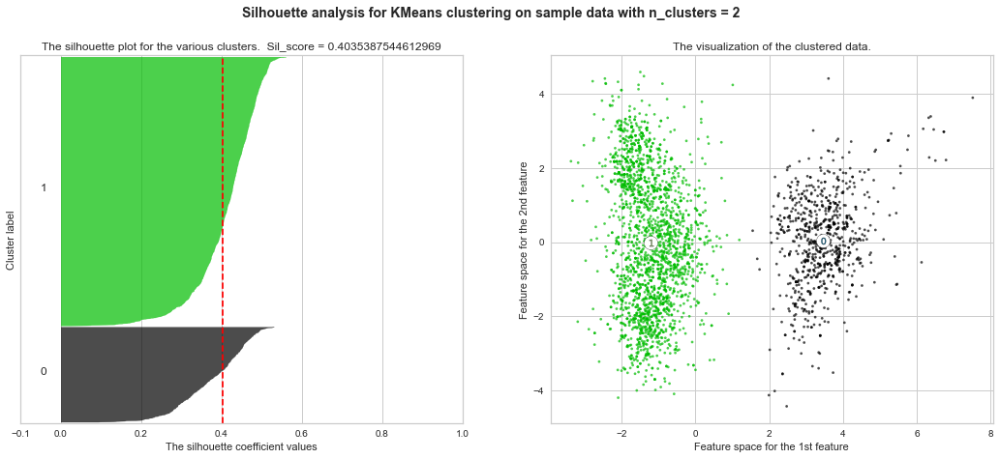

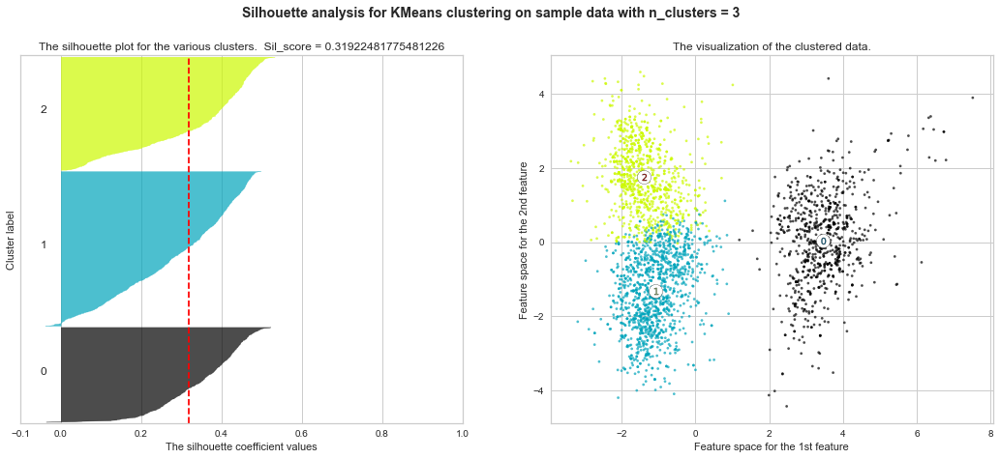

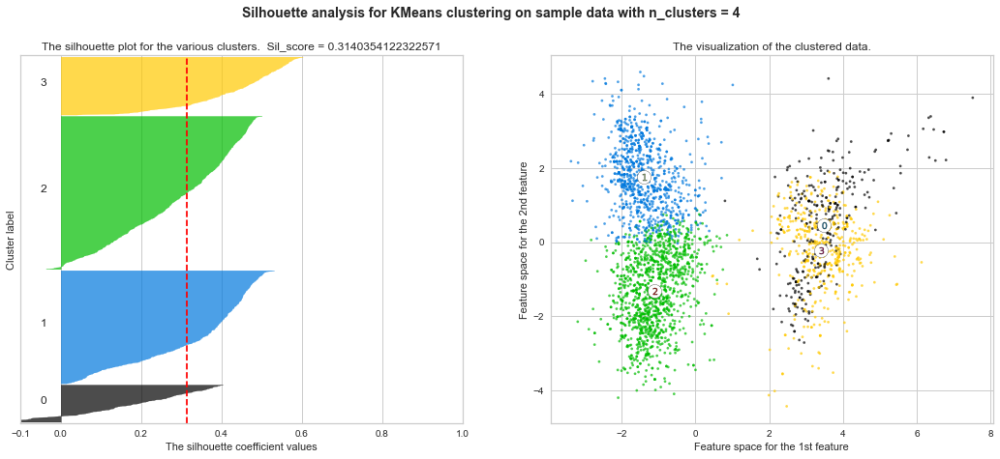

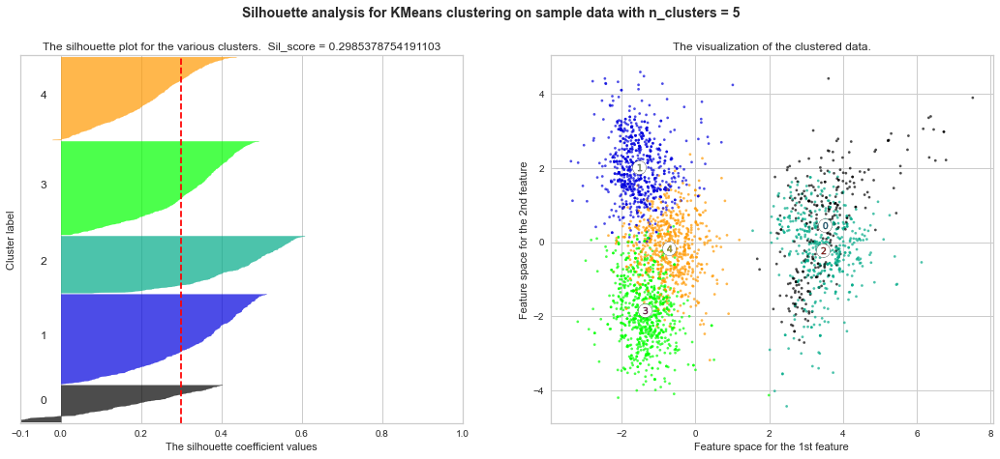

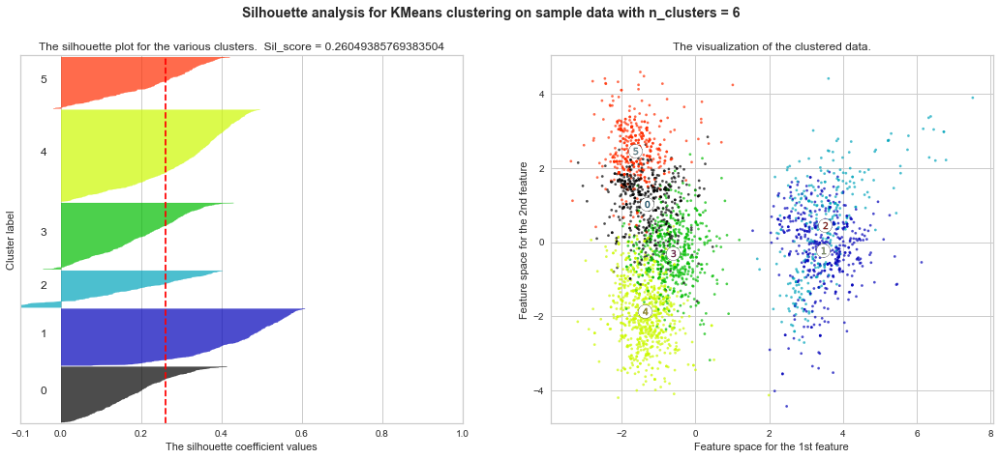

In [99]:
sil_score_kmeans_2(X_w_pca, random_seed=1)

In [76]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

def sil_score_kmeans_2(X, k_values = [2, 3, 4, 5, 6], random_seed = 2, scatter_0 = 0, scatter_1= 1):



    for n_clusters in k_values:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=random_seed)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters. " + " Sil_score = " + str(silhouette_avg))
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, scatter_0], centers[:, scatter_1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()

Automatically created module for IPython interactive environment


In [107]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

def sil_score_EM(X, k_values = [2, 3, 4, 5, 6], random_seed = 2, scatter_0 = 0, scatter_1= 1):



    for n_clusters in k_values:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = GaussianMixture(n_components = n_clusters, random_state = random_seed)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters. " + " Sil_score = " + str(silhouette_avg))
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, scatter_0], X[:, scatter_1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')




        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()

Automatically created module for IPython interactive environment


In [85]:
# https://scikit-learn.org/stable/auto_examples/model_selection/plot_learning_curve.html

import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(estimator, X, y,title= "Validation Curve", axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.05, 1.0, 8), scoring = "f1", random_state =1):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y,
                       train_sizes=train_sizes, scoring = scoring,
                       return_times=True, random_state = random_state, cv=cv, n_jobs=-1)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)
    
    print("Train Score Mean " + str(train_scores_mean[-1]))
    print("Test Score Mean " + str(test_scores_mean[-1]))

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validation score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt


# https://scikit-learn.org/stable/modules/model_evaluation.html

import matplotlib.pyplot as plt
import numpy as np
from sklearn.datasets import load_digits
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve

digits = load_digits()
X, y = digits.data, digits.target

def plot_validation_curve_log(estimator, X, y, param_name,title= "Validation Curve", axes=None, ylim=None, cv=None,
                        n_jobs=-1, param_range=np.linspace(.1, 1.0, 5), scoring = "f1", random_state = 1):

    train_scores, test_scores = validation_curve(
        estimator, X, y, param_name=param_name, param_range=param_range, scoring=scoring, cv = cv)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.title(title, fontdict={'fontsize': 15, 'fontweight': 'heavy'})
    plt.xlabel(param_name)
    plt.ylabel("Score")
    plt.semilogx(param_range, train_scores_mean, label="Training score", color="r")
    plt.fill_between(param_range, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.2, color="r")
    plt.semilogx(param_range, test_scores_mean, label="Cross-validation score",
                 color="g")
    plt.fill_between(param_range, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.2, color="g")
    plt.legend(loc="best")
    plt.grid()
    plt.show()
    array = list(zip(param_range, test_scores_mean))
    return array